<a href="https://colab.research.google.com/github/niwayandm/printing-machine/blob/main/Speed_Printing_Forecasting_with_NBeats_RNN_V1_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Install Libraries**
Restart runtime after installing these libraries

In [ ]:
!pip install darts

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pyyaml==5.4.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# **Importing Libraries**

Python code in one module gains access to the code in another module by the process of importing it. The import statement is the most common way of invoking the import machinery, but it is not the only way. 

A Python library is a collection of related modules. It contains bundles of code that can be used repeatedly in different programs. It makes Python Programming simpler and convenient for the programmer.

In [ ]:
import pandas as pd
import numpy as np
import statistics
import datetime
import calendar

import seaborn as sns 
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.style
import matplotlib as mpl

from darts import TimeSeries
from darts.dataprocessing.transformers import Scaler
from darts.models import NBEATSModel,RNNModel
from darts.metrics import rmse,mae,mse,smape,ope,mape
from darts.utils.statistics import check_seasonality

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [ ]:
# remove the notebook root logger.\n",
import logging
logger = logging.getLogger()
logger.handlers = []

In [ ]:
mpl.style.use('default')

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
downloaded = drive.CreateFile({'id':"1J08GN19v3F0AaLpP6T8OK8MV84o0gg_e"})
downloaded.GetContentFile('2021_RDD_SPNP_1.csv')

# **Importing Raw Data/Source of Dataset**
In any data analysis project, we seek to discover useful, actionable insights from a given set of data. If we’re lucky, this data may already be packaged for us; if not, we may need to collect it ourselves. Either way, once the data is stored, we will need to read it into a program to perform analysis.
The software package *pandas* is often used for this purpose. It is a powerful library that works with the Python programming language. Within pandas, the tool of choice to read in data files is the ubiquitous `read_csv `or `read_excel` function.

In [ ]:
# import train and test data
df = pd.read_csv('2021_RDD_SPNP_1.csv',index_col=0)

In [ ]:
# print the first eight rows of the dataset
df.head(8)

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,JobName,NoJI,...,FILM,qtyok,target,LCL,Speed,interval,Weight,RunTime,Downtime,GapTime
0,2021-01-01,1- W1,Jan,1,0:00,PF,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
1,2021-01-01,1- W1,Jan,1,0:01,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
2,2021-01-01,1- W1,Jan,1,0:02,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
3,2021-01-01,1- W1,Jan,1,0:03,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
4,2021-01-01,1- W1,Jan,1,0:04,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
5,2021-01-01,1- W1,Jan,1,0:05,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
6,2021-01-01,1- W1,Jan,1,0:06,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
7,2021-01-01,1- W1,Jan,1,0:07,US,Machine1,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1


In [ ]:
# print how many rows and columns are in the dataset
print("The data has", len(df), "rows and", len(df.columns), "columns")

The data has 2929156 rows and 25 columns


In [ ]:
# check data types of all columns
df.dtypes

Tgl           object
Weekly        object
Bulan         object
Hari           int64
Jam           object
KodeBD        object
KdMesin       object
OrderID       object
JobName       object
NoJI          object
LebarCyl     float64
Under_lcl      int64
Notif          int64
OTS            int64
Matte          int64
FILM          object
qtyok          int64
target         int64
LCL            int64
Speed          int64
interval       int64
Weight       float64
RunTime        int64
Downtime       int64
GapTime        int64
dtype: object

# **Data Prepraration**

Data preparation is the process of cleaning and transforming raw data prior to processing and analysis. It is an important step prior to processing and often involves reformatting data, making corrections to data and the combining of data sets to enrich data.

Data preparation is often a lengthy undertaking for data professionals or business users, but it is essential as a prerequisite to put data in context in order to turn it into insights and eliminate bias resulting from poor data quality.

For example, the data preparation process usually includes standardizing data formats, enriching source data, and/or removing outliers.

### **1. Changing data formats**

In [ ]:
# change 'Tgl' data type to date
df['Tgl']= pd.to_datetime(df['Tgl'],format='%Y-%m-%d')
df.dtypes

Tgl          datetime64[ns]
Weekly               object
Bulan                object
Hari                  int64
Jam                  object
KodeBD               object
KdMesin              object
OrderID              object
JobName              object
NoJI                 object
LebarCyl            float64
Under_lcl             int64
Notif                 int64
OTS                   int64
Matte                 int64
FILM                 object
qtyok                 int64
target                int64
LCL                   int64
Speed                 int64
interval              int64
Weight              float64
RunTime               int64
Downtime              int64
GapTime               int64
dtype: object

## **2. Dimensionality Reduction**

In [ ]:
# delete unnecessary colums for EDA
df = df.drop(columns= ['JobName','NoJI','LebarCyl','Under_lcl','Matte','LCL','OTS','interval','Weight'], axis=1)

# print the first 5 rows in dataset to check if the above columns have been deleted
df.head(8)

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
0,2021-01-01,1- W1,Jan,1,0:00,PF,Machine1,NaN,0,NaN,0,0,0,0,1,1
1,2021-01-01,1- W1,Jan,1,0:01,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
2,2021-01-01,1- W1,Jan,1,0:02,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
3,2021-01-01,1- W1,Jan,1,0:03,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
4,2021-01-01,1- W1,Jan,1,0:04,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
5,2021-01-01,1- W1,Jan,1,0:05,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
6,2021-01-01,1- W1,Jan,1,0:06,US,Machine1,NaN,0,NaN,0,0,0,0,1,1
7,2021-01-01,1- W1,Jan,1,0:07,US,Machine1,NaN,0,NaN,0,0,0,0,1,1


## **3. Handling missing values**

In [ ]:
# check the percentage of missing values
def missing_values(data):
    total = data.isnull().sum()
    percent = data.isnull().mean()*100
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_values(df)

,Total,Percent
Tgl,0,0.000000
Weekly,0,0.000000
Bulan,0,0.000000
Hari,0,0.000000
Jam,0,0.000000
KodeBD,0,0.000000
KdMesin,0,0.000000
OrderID,217663,7.430912
Notif,0,0.000000
FILM,209651,7.157386


In [ ]:
# replacing missing values in 'FILM' with OTHER
df['FILM'].fillna('OTHER', inplace = True)
df['OrderID'].fillna('NoOrderID', inplace = True)

# check if the missing values have been replaced
missing_values(df)

,Total,Percent
Tgl,0,0.0
Weekly,0,0.0
Bulan,0,0.0
Hari,0,0.0
Jam,0,0.0
KodeBD,0,0.0
KdMesin,0,0.0
OrderID,0,0.0
Notif,0,0.0
FILM,0,0.0


## **4. Removing negative data and duplicates**

In [ ]:
# descriptive stats of the data, negative value on Speed
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Hari,2929156.0,15.818634,8.852648,1.0,8.0,16.0,23.0,31.0
Notif,2929156.0,0.181236,0.385214,0.0,0.0,0.0,0.0,1.0
qtyok,2929156.0,234549.514092,331181.116755,0.0,27000.0,100000.0,290000.0,1908000.0
target,2929156.0,300.374819,131.700381,0.0,220.0,330.0,370.0,480.0
Speed,2929156.0,207.430555,159.770196,-53.0,5.0,221.0,350.0,501.0
RunTime,2929156.0,0.592641,0.491343,0.0,0.0,1.0,1.0,1.0
Downtime,2929156.0,0.407359,0.491343,0.0,0.0,0.0,1.0,1.0
GapTime,2929156.0,1.030263,2.268229,1.0,1.0,1.0,1.0,750.0


In [ ]:
df[df['Speed']<0]

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
2127696,2021-09-13,9- W3,Sep,13,15:11,MQ,Machine7,0344E-20,0,Material3,370000,400,-53,0,1,2
2127697,2021-09-13,9- W3,Sep,13,15:12,MQ,Machine7,0344E-20,0,Material3,370000,400,-53,0,1,1


In [ ]:
# removing negative data
df['Speed'] = df['Speed'].mask(df['Speed'] < 0, 0)

df.describe().T

,count,mean,std,min,25%,50%,75%,max
Hari,2929156.0,15.818634,8.852648,1.0,8.0,16.0,23.0,31.0
Notif,2929156.0,0.181236,0.385214,0.0,0.0,0.0,0.0,1.0
qtyok,2929156.0,234549.514092,331181.116755,0.0,27000.0,100000.0,290000.0,1908000.0
target,2929156.0,300.374819,131.700381,0.0,220.0,330.0,370.0,480.0
Speed,2929156.0,207.430591,159.770143,0.0,5.0,221.0,350.0,501.0
RunTime,2929156.0,0.592641,0.491343,0.0,0.0,1.0,1.0,1.0
Downtime,2929156.0,0.407359,0.491343,0.0,0.0,0.0,1.0,1.0
GapTime,2929156.0,1.030263,2.268229,1.0,1.0,1.0,1.0,750.0


In [ ]:
# Selecting duplicate rows except first
# occurrence based on all columns
duplicate = df[df.duplicated(['Tgl','Jam','KdMesin'],keep='last')]
 
# Print the resultant Dataframe
# print how many rows and columns are in the dataset
print("There are", len(duplicate), "duplicated data in the dataset or approx. "+str(round(100*len(duplicate)/len(df),2))+'%')
print("Duplicate Rows :")
 
# Print the resultant Dataframe
duplicate

There are 25750 duplicated data in the dataset or approx. 0.88%
Duplicate Rows :


,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
3484,2021-01-03,1- W1,Jan,3,10:34,CO1,Machine1,55968-20,0,Material1,48000,230,28,0,1,2
10141,2021-01-08,1- W2,Jan,8,3:00,MQ,Machine1,55840-20,0,Material3,16000,180,181,0,1,1
14555,2021-01-11,1- W3,Jan,11,5:59,RUN,Machine1,56112-20,1,Material2,560000,200,190,1,0,1
14557,2021-01-11,1- W3,Jan,11,6:00,RUN,Machine1,55929-20,0,Material3,12000,180,190,1,0,1
14559,2021-01-11,1- W3,Jan,11,6:01,RUN,Machine1,56112-20,1,Material2,560000,200,190,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905957,2021-12-14,12- W3,Dec,14,16:36,RUN,Machine7,61603-21,0,Material2,300000,370,410,1,0,2
2905959,2021-12-14,12- W3,Dec,14,16:37,RUN,Machine7,61603-21,0,Material2,300000,370,410,1,0,1
2905961,2021-12-14,12- W3,Dec,14,16:38,RUN,Machine7,61603-21,0,Material2,300000,370,410,1,0,1
2905963,2021-12-14,12- W3,Dec,14,16:39,RUN,Machine7,61603-21,0,Material2,300000,370,410,1,0,1


In [ ]:
# drop duplicates
df.drop_duplicates(['Tgl','Jam','KdMesin'],keep='last',inplace=True)
duplicate = df[df.duplicated(['Tgl','Jam','KdMesin'])]
# Print the resultant Dataframe
# print how many rows and columns are in the dataset
print("There are", len(duplicate), "duplicated data in the dataset")

There are 0 duplicated data in the dataset


## **5. Subsetting Data**

In [ ]:
# slice the BD Code 'RUN' for easy computing
run = df[df['KodeBD']=='RUN'].drop(columns=['Downtime'])
run['Bulan'] = run['Tgl'].dt.month

# print the dataset to check the slice
run.head()

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,GapTime
1987,2021-01-02,1- W1,1,2,9:23,RUN,Machine1,55920-20,0,Material1,12000,200,180,1,1
1988,2021-01-02,1- W1,1,2,9:24,RUN,Machine1,55920-20,0,Material1,12000,200,180,1,1
1989,2021-01-02,1- W1,1,2,9:25,RUN,Machine1,55920-20,0,Material1,12000,200,180,1,1
1990,2021-01-02,1- W1,1,2,9:26,RUN,Machine1,55920-20,1,Material1,12000,200,181,1,1
1991,2021-01-02,1- W1,1,2,9:27,RUN,Machine1,55920-20,1,Material1,12000,200,181,1,1


In [ ]:
# slicing monthly runtime data per material
run_monthly = run.pivot_table(values='RunTime', index='Bulan', columns='FILM', fill_value=0, aggfunc=np.sum)
run_monthly = run_monthly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_monthly = run_monthly.drop(columns=['Material4','Material5','Material6','OTHER'])

run_monthly

,Bulan,Material1,Material2,Material3
0,1,100883,19957,18412
1,2,91570,23670,16958
2,3,102749,24599,28536
3,4,92469,18000,27024
4,5,75790,14553,33127
5,6,84628,12693,25586
6,7,88766,17286,30443
7,8,84395,14531,36041
8,9,90020,16414,41389
9,10,97586,19413,33418


In [ ]:
# slicing weekly runtime data per material
run_weekly = run.pivot_table(values='RunTime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
run_weekly = run_weekly.resample('W-MON').sum()
run_weekly = run_weekly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_weekly = run_weekly.drop(columns=['Material4','Material5','Material6','OTHER'])
run_weekly.head()

,Tgl,Material1,Material2,Material3
0,2021-01-04,10345,2321,276
1,2021-01-11,23976,3080,4383
2,2021-01-18,21637,6463,7960
3,2021-01-25,26877,3956,3403
4,2021-02-01,21537,4422,2390


In [ ]:
# slicing daily runtime data per material
run_daily = run.pivot_table(values='RunTime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
run_daily = run_daily.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_daily = run_daily.drop(columns=['Material4','Material5','Material6','OTHER'])
run_daily

,Tgl,Material1,Material2,Material3
0,2021-01-02,3340,65,178
1,2021-01-03,2844,1638,98
2,2021-01-04,4161,618,0
3,2021-01-05,3188,792,230
4,2021-01-06,4129,183,319
...,...,...,...,...
354,2021-12-27,1610,294,2932
355,2021-12-28,3015,384,962
356,2021-12-29,3314,1285,90
357,2021-12-30,3765,315,487


In [ ]:
# output per machine per film
op = run.pivot_table(values='Speed',index=['Tgl','Bulan','KdMesin','FILM'],aggfunc='mean',fill_value=0).reset_index().rename_axis(None, axis=1)
op['Speed'] = op['Speed'].round(0).astype(int)
op['RunTime'] = run.pivot_table(values='RunTime',index=['Tgl','KdMesin','FILM'],aggfunc='sum',fill_value=0).reset_index().drop(columns=['Tgl','KdMesin','FILM'])
op['Output'] = (op['RunTime'] * op['Speed']).astype(int)
op.drop(op[(op['FILM']=='Material4')|(op['FILM']=='Material5')|(op['FILM']=='Material5')|(op['FILM']=='OTHER')].index, inplace=True)

op.head()

,Tgl,Bulan,KdMesin,FILM,Speed,RunTime,Output
0,2021-01-02,1,Machine1,Material1,212,493,104516
2,2021-01-02,1,Machine2,Material1,213,356,75828
3,2021-01-02,1,Machine2,Material3,178,178,31684
5,2021-01-02,1,Machine3,Material1,308,454,139832
6,2021-01-02,1,Machine3,Material2,263,65,17095


In [ ]:
# slice the BD Code to not 'RUN' for easy computing
down = df[(df['KodeBD']!='RUN') & (df['KodeBD']!='OTS') & (df['KodeBD']!='PF')].drop(columns=['RunTime'])
down['Bulan'] = down['Tgl'].dt.month

# print the dataset to check the slice
down.head()

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,Downtime,GapTime
1,2021-01-01,1- W1,1,1,0:01,US,Machine1,NoOrderID,0,OTHER,0,0,0,1,1
2,2021-01-01,1- W1,1,1,0:02,US,Machine1,NoOrderID,0,OTHER,0,0,0,1,1
3,2021-01-01,1- W1,1,1,0:03,US,Machine1,NoOrderID,0,OTHER,0,0,0,1,1
4,2021-01-01,1- W1,1,1,0:04,US,Machine1,NoOrderID,0,OTHER,0,0,0,1,1
5,2021-01-01,1- W1,1,1,0:05,US,Machine1,NoOrderID,0,OTHER,0,0,0,1,1


In [ ]:
# slicing monthly downtime data per material
down_monthly = down.pivot_table(values='Downtime', index='Bulan', columns='FILM', fill_value=0, aggfunc=np.sum)
down_monthly = down_monthly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_monthly = down_monthly.drop(columns=['Material4','Material5','Material6','OTHER'])
down_monthly.head()

,Bulan,Material1,Material2,Material3
0,1,38624,12941,8674
1,2,32431,13651,6512
2,3,36213,11180,10958
3,4,37727,10912,13406
4,5,31051,8281,10142


In [ ]:
# slicing weekly downtime data per material
down_weekly = down.pivot_table(values='Downtime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
down_weekly = down_weekly.resample('W-MON').sum()
down_weekly = down_weekly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_weekly = down_weekly.drop(columns=['Material4','Material5','Material6','OTHER'])
down_weekly.head()

,Tgl,Material1,Material2,Material3
0,2021-01-04,4572,1235,395
1,2021-01-11,11329,1908,2120
2,2021-01-18,7773,3463,2756
3,2021-01-25,7212,3555,2096
4,2021-02-01,9454,3384,1307


In [ ]:
# slicing daily downtime data per material
down_daily = down.pivot_table(values='Downtime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
down_daily = down_daily.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_daily = down_daily.drop(columns=['Material4','Material5','Material6','OTHER'])
down_daily.head()

,Tgl,Material1,Material2,Material3
0,2021-01-01,0,0,0
1,2021-01-02,1265,113,213
2,2021-01-03,1303,632,182
3,2021-01-04,2004,490,0
4,2021-01-05,1998,358,401


In [ ]:
# slicing monthly runtime data per machine
rmc_monthly = run.pivot_table(values='RunTime', index='Bulan', columns='KdMesin', fill_value=0, aggfunc=np.sum)
rmc_monthly = rmc_monthly.reset_index().rename_axis(None, axis=1)

rmc_monthly.head()

,Bulan,Machine1,Machine2,Machine3,Machine5,Machine6,Machine7
0,1,21947,19881,23388,28232,25367,24383
1,2,21673,18711,19290,27800,24547,27721
2,3,26641,19112,23296,32811,26666,34027
3,4,21494,20277,23180,31667,24553,20688
4,5,20798,18124,17273,29626,19389,23102


In [ ]:
# slicing monthly downtime data per machine
dmc_monthly = down.pivot_table(values='Downtime', index='Bulan', columns='KdMesin', fill_value=0, aggfunc=np.sum)
dmc_monthly = dmc_monthly.reset_index().rename_axis(None, axis=1)

dmc_monthly.head()

,Bulan,Machine1,Machine2,Machine3,Machine5,Machine6,Machine7
0,1,14136,16690,16037,10988,14124,7161
1,2,10557,13450,12404,7508,10476,7038
2,3,11792,13821,12844,7938,12086,8141
3,4,14020,16175,13636,8309,13537,5799
4,5,10975,16094,10693,7570,11752,9577


# **Exploratory Data Analysis to get new insights before doing Data Mining with Machine Learning or Deep Learning Methods**

Exploratory Data Analysis, or EDA, is an important step in any Data Analysis or Data Science project. EDA is the process of investigating the dataset to discover patterns, and anomalies (outliers), and form hypotheses based on our understanding of the dataset.

EDA involves generating summary statistics for numerical data in the dataset and creating various graphical representations to understand the data better. 

## **1. Descriptive Statistics**

### **All Data Descriptive Stats**

In [ ]:
# descriptive stats of the data at 2021
df.drop(columns=['Hari','Notif']).describe().T

,count,mean,std,min,25%,50%,75%,max
qtyok,2903406.0,235032.378420,331474.193237,0.0,27000.0,100000.0,294000.0,1908000.0
target,2903406.0,300.735313,131.605006,0.0,220.0,330.0,370.0,480.0
Speed,2903406.0,207.612248,159.789816,0.0,5.0,221.0,350.0,501.0
RunTime,2903406.0,0.594396,0.491009,0.0,0.0,1.0,1.0,1.0
Downtime,2903406.0,0.405604,0.491009,0.0,0.0,0.0,1.0,1.0
GapTime,2903406.0,1.029857,2.232918,1.0,1.0,1.0,1.0,750.0


### **Runtime Data Descriptive Stats**

In [ ]:
# descriptive stats of the data jan - dec 2021
run_mc = run.pivot_table(values='Speed',index=['Tgl','KdMesin'],aggfunc='mean').reset_index().rename_axis(None, axis=1)
run_mc['Speed'] = run_mc['Speed'].round(0).astype(int)
run_mc['RunTime'] = run.groupby(['Tgl','KdMesin'])['RunTime'].sum().reset_index().drop(columns=['Tgl','KdMesin'])
run_mc['Output'] = (run_mc['RunTime'] * run_mc['Speed']).astype(int)

run_mc.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,2094.0,303.155205,84.648484,124.0,217.0,306.0,371.00,497.0
RunTime,2094.0,824.151862,281.004034,29.0,624.0,842.0,1055.75,1386.0
Output,2094.0,257774.880134,130504.704795,10179.0,154872.5,232102.5,360785.25,633933.0


In [ ]:
# descriptive stats of machine1 data
run_machine1 = run_mc[run_mc['KdMesin']=='Machine1']
run_machine1.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,351.0,212.415954,12.936247,175.0,205.0,213.0,221.0,254.0
RunTime,351.0,801.880342,265.713449,96.0,637.0,806.0,994.0,1353.0
Output,351.0,171335.900285,59691.849535,19104.0,134517.0,175253.0,212550.5,296930.0


In [ ]:
# descriptive stats of Machine2 data 
run_machine2 = run_mc[run_mc['KdMesin']=='Machine2']
run_machine2.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,358.0,205.656425,12.726463,177.0,197.00,205.0,215.00,249.0
RunTime,358.0,646.910615,223.821853,118.0,484.75,643.5,806.00,1304.0
Output,358.0,134091.055866,49949.519851,23600.0,96672.75,133604.5,167520.75,324696.0


In [ ]:
# descriptive stats of machine3 data 
run_machine3 = run_mc[run_mc['KdMesin']=='Machine3']
run_machine3.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,332.0,272.611446,29.590298,124.0,255.00,275.0,295.00,337.0
RunTime,332.0,794.816265,226.961193,187.0,645.75,801.5,965.00,1297.0
Output,332.0,219226.165663,75544.141034,51051.0,163725.00,215830.5,268518.75,431360.0


In [ ]:
# descriptive stats of machine5 data 
run_machine5 = run_mc[run_mc['KdMesin']=='Machine5']
run_machine5.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,358.0,342.617318,22.260023,281.0,329.00,341.0,356.00,399.0
RunTime,358.0,1043.857542,219.203484,195.0,935.25,1108.0,1200.75,1382.0
Output,358.0,359457.122905,85473.609443,57330.0,309400.50,378544.0,419622.00,525596.0


In [ ]:
# descriptive stats of Machine6 data 
run_machine6 = run_mc[run_mc['KdMesin']=='Machine6']
run_machine6.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,344.0,375.918605,45.662973,188.0,354.00,375.5,405.00,497.0
RunTime,344.0,736.665698,262.122735,30.0,557.25,761.0,925.75,1346.0
Output,344.0,279374.357558,112340.813033,10410.0,198457.50,279004.5,359162.75,633933.0


In [ ]:
# descriptive stats of Machine7 data 
run_machine7 = run_mc[run_mc['KdMesin']=='Machine7']
run_machine7.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,351.0,410.666667,43.425207,175.0,390.0,415.0,442.0,485.0
RunTime,351.0,916.601140,294.149768,29.0,758.0,981.0,1142.5,1386.0
Output,351.0,381947.532764,139557.270210,10179.0,287529.0,401051.0,492496.0,622863.0


### **Downtime Data Descriptive Stats**

In [ ]:
# descriptive stats of the data jan - dec 2021
down.drop(columns=['Bulan','Hari','Notif']).describe().T

,count,mean,std,min,25%,50%,75%,max
qtyok,866898.0,137222.100063,251780.833781,0.0,12000.0,40000.0,132000.0,1908000.0
target,866898.0,261.066711,145.503960,0.0,200.0,230.0,350.0,480.0
Speed,866898.0,31.574591,70.422314,0.0,0.0,3.0,26.0,500.0
Downtime,866898.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
GapTime,866898.0,1.024506,1.916538,1.0,1.0,1.0,1.0,750.0


In [ ]:
# breakdown percentage of downtime data
down_all = df[df['KodeBD']!='RUN'].drop(columns=['RunTime'])
down_all['Bulan'] = down_all['Tgl'].dt.month
down_percent = down_all.pivot_table(values='Downtime',index='KodeBD',aggfunc='sum')
down_percent['Percent'] = round(100*down_percent['Downtime']/down_percent['Downtime'].sum(),2)
down_percent

,Downtime,Percent
KodeBD,,
BD,22130,1.88
CO1,378861,32.17
CO2,100370,8.52
CO3,90972,7.72
MC,11551,0.98
MQ,184344,15.65
OTS,172738,14.67
PF,137996,11.72
PM,16517,1.40


In [ ]:
# breakdown percentage of downtime data by machine
pd.set_option('display.max_rows', df.shape[0]+1)
down_percent = down_all.pivot_table(values='Downtime',index=['KdMesin','KodeBD'],aggfunc='sum')
down_percent['Percent'] = down_percent.groupby(level=0).apply(lambda x: round(100 * x / float(x.sum()),2))
down_percent

Downtime  Percent
KdMesin  KodeBD                   
Machine1 BD          5577     2.82
         CO1        77109    39.01
         CO2        17818     9.01
         CO3        17071     8.64
         MC          1716     0.87
         MQ         13325     6.74
         OTS        38956    19.71
         PF         11529     5.83
         PM          2942     1.49
         US         11607     5.87
Machine2 BD          4711     1.82
         CO1        94744    36.55
         CO2        32737    12.63
         CO3        29827    11.51
         MC          3887     1.50
         MQ         18587     7.17
         OTS        50413    19.45
         PF          8648     3.34
         PM           959     0.37
         US         14682     5.66
Machine3 BD          3438     1.48
         CO1        64867    27.99
         CO2        22620     9.76
         CO3        14972     6.46
         MC          3463     1.49
         MQ         38922    16.80
         OTS        35087    15.14
         PF         36596    15.79
         PM          4101     1.77
         US          7665     3.31
Machine5 BD          5174     4.18
         CO1        31063    25.07
         CO2         6472     5.22
         CO3         5211     4.21
         MC           931     0.75
         MQ         46997    37.93
         OTS        10075     8.13
         PF          9302     7.51
         PM          2764     2.23
         US          5912     4.77
Machine6 BD          1497     0.65
         CO1        70807    30.73
         CO2        13157     5.71
         CO3        12602     5.47
         MC          1263     0.55
         MQ         33001    14.32
         OTS        25531    11.08
         PF         56983    24.73
         PM          2273     0.99
         US         13321     5.78
Machine7 BD          1733     1.29
         CO1        40271    29.89
         CO2         7566     5.62
         CO3        11289     8.38
         MC           291     0.22
         MQ         33512    24.88
         OTS        12676     9.41
         PF         14938    11.09
         PM          3478     2.58
         US          8966     6.66

### **Investigating Downtime Speed**

In [ ]:
# maximum speed on all breakdown
down_speed_max = down_all.pivot_table(values=['Speed','target'],index='KodeBD',aggfunc='max')
down_speed_max

,Speed,target
KodeBD,,
BD,460,480
CO1,500,480
CO2,460,480
CO3,480,480
MC,483,480
MQ,500,480
OTS,500,480
PF,500,480
PM,444,480


In [ ]:
# avg speed on all breakdown
down_speed_avg = round(down_all.pivot_table(values=['Speed','target'],index='KodeBD',aggfunc='mean'),0).astype(int)
down_speed_avg

,Speed,target
KodeBD,,
BD,25,250
CO1,13,256
CO2,45,246
CO3,77,260
MC,37,246
MQ,50,324
OTS,58,235
PF,186,316
PM,3,252


In [ ]:
# avg speed on all breakdown by Machine
down_speed_avg = round(down_all.pivot_table(values=['Speed','target'],index=['KdMesin','KodeBD'],aggfunc='mean'),0).astype(int)
down_speed_avg

Speed  target
KdMesin  KodeBD               
Machine1 BD         21     196
         CO1         3     182
         CO2        37     185
         CO3        31     187
         MC         16     203
         MQ         17     200
         OTS        36     186
         PF        102     171
         PM          0     159
         US         11     134
Machine2 BD         26     131
         CO1        20     182
         CO2        57     181
         CO3       111     182
         MC         49     158
         MQ         73     193
         OTS        74     184
         PF        106     173
         PM          4     204
         US         21     140
Machine3 BD          9     303
         CO1        16     263
         CO2        31     264
         CO3        38     272
         MC         25     293
         MQ         24     291
         OTS        57     264
         PF        198     290
         PM          4     258
         US         14     157
Machine5 BD         35     298
         CO1        18     280
         CO2        51     295
         CO3       119     278
         MC         42     282
         MQ         57     316
         OTS        95     293
         PF        211     264
         PM          4     260
         US         13     121
Machine6 BD         29     352
         CO1        11     338
         CO2        43     348
         CO3        69     366
         MC         29     371
         MQ         54     377
         OTS        40     281
         PF        212     369
         PM          1     328
         US          3     106
Machine7 BD         36     416
         CO1        11     398
         CO2        48     401
         CO3        95     434
         MC        155     460
         MQ         69     442
         OTS        70     372
         PF        153     407
         PM          3     279
         US          4     203

**PF and OTS**

In [ ]:
# monthly avg speed on OTS and PF by Machine
down_speed_avg = round(down_all[(down_all.KodeBD=='PF')|(down_all.KodeBD=='OTS')].pivot_table(values=['Speed','target'],index=['Bulan','KdMesin','KodeBD'],aggfunc='mean'),0).astype(int)
down_speed_avg

Speed  target
Bulan KdMesin  KodeBD               
1     Machine1 OTS        26     201
               PF        131     177
      Machine2 OTS        76     173
               PF        173     176
      Machine3 OTS        28     232
               PF        181     264
      Machine5 OTS        71     242
               PF        236     243
      Machine6 OTS        33     155
               PF        161     310
      Machine7 OTS        90     312
               PF        230     385
2     Machine1 OTS        30     186
               PF         71     125
      Machine2 OTS        71     201
               PF        115     182
      Machine3 OTS        60     297
               PF        104     246
      Machine5 OTS        69     347
               PF        218     288
      Machine6 OTS        48     160
               PF        151     346
      Machine7 OTS        36     480
               PF        133     423
3     Machine1 OTS        26     196
               PF         77     166
      Machine2 OTS        73     185
               PF         92     168
      Machine3 OTS       104     225
               PF         69     246
      Machine5 OTS        66     338
               PF        147     258
      Machine6 OTS        39     252
               PF         79     347
      Machine7 OTS       254     480
               PF         99     408
4     Machine1 OTS        47     166
               PF         81     133
      Machine2 OTS        75     176
               PF         83     176
      Machine3 OTS        65     278
               PF         71     264
      Machine5 OTS       126     260
               PF        120     253
      Machine6 OTS        68     375
               PF         91     305
      Machine7 PF         96     396
5     Machine1 OTS        36     195
               PF         74     142
      Machine2 OTS        75     180
               PF         79     149
      Machine3 OTS        45     273
               PF        213     294
      Machine5 OTS       117     348
               PF        179     248
      Machine6 OTS        34     358
               PF        113     376
      Machine7 OTS       111     390
               PF         98     378
6     Machine1 OTS        36     199
               PF         92     154
      Machine2 OTS        75     180
               PF         86     162
      Machine3 OTS        45     294
               PF        261     304
      Machine5 OTS       117     323
               PF        125     273
      Machine6 OTS        17     177
               PF         53     377
      Machine7 OTS        67     413
               PF         78     418
7     Machine1 OTS        30     164
               PF         84     149
      Machine2 OTS        75     155
               PF         76     138
      Machine3 OTS        39     262
               PF        158     294
      Machine5 OTS       105     250
               PF        141     238
      Machine6 OTS        32     296
               PF         76     323
      Machine7 OTS        26     227
               PF         73     393
8     Machine1 OTS        34     200
               PF        129     181
      Machine2 OTS        71     208
               PF        121     159
      Machine3 OTS        40     276
               PF         80     270
      Machine5 OTS       114     259
               PF        286     272
      Machine6 OTS        50     295
               PF        231     352
      Machine7 OTS        45     273
               PF        217     407
9     Machine1 OTS        52     164
               PF         69     200
      Machine2 OTS        74     179
               PF         29     218
      Machine3 OTS        66     261
               PF         41     253
      Machine5 OTS        69     277
               PF        304     337
      Machine6 OTS        43     411
               PF        233     361
      Machine7 OTS       130     428
               PF        10

In [ ]:
# percentage of downtime with speed > 50
down_50 = down_all[((down_all.KodeBD!='MQ') & (down_all.KodeBD!='US')) & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*down_50/down_all['Downtime'].sum()
print('Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US):',round(percent,2),'%')

Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US): 19.6 %


In [ ]:
# percentage of downtime with speed > 50
down_50 = down_all[((down_all.KodeBD!='MQ') & (down_all.KodeBD!='US')) & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*down_50/down_all['Downtime'].sum()
print('Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US):',round(percent,2),'%')

Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US): 19.6 %


In [ ]:
# all pf percentage with speed more than 50 MPM in a year
pf = down_all[(down_all.KodeBD=='PF')]['Downtime'].sum()
percent = 100*pf/down_all['Downtime'].sum()
print('PF Percentage Jan to Dec 2021:',round(percent,2),'%')

PF Percentage Jan to Dec 2021: 11.72 %


In [ ]:
# pf percentage per month
for i in range(1,13):
  pf = down_all[(down_all.KodeBD=='PF') & (down_all.Bulan==i)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.Bulan==1]['Downtime'].sum()
  print('PF Percentage', calendar.month_name[i] ,'2021:',round(percent,2),'%')

PF Percentage January 2021: 12.07 %
PF Percentage February 2021: 7.42 %
PF Percentage March 2021: 5.21 %
PF Percentage April 2021: 5.16 %
PF Percentage May 2021: 7.67 %
PF Percentage June 2021: 24.33 %
PF Percentage July 2021: 6.42 %
PF Percentage August 2021: 14.51 %
PF Percentage September 2021: 11.95 %
PF Percentage October 2021: 22.13 %
PF Percentage November 2021: 9.91 %
PF Percentage December 2021: 9.83 %


In [ ]:
# pf percentage per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  pf = down_all[(down_all.KodeBD=='PF') & (down_all.KdMesin=='Machine'+str(list[i]))]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.KdMesin=='Machine'+str(list[i])]['Downtime'].sum()
  print('PF Percentage Machine'+str(list[i])+':',round(percent,2),'%')

PF Percentage Machine1: 5.83 %
PF Percentage Machine2: 3.34 %
PF Percentage Machine3: 15.79 %
PF Percentage Machine5: 7.51 %
PF Percentage Machine6: 24.73 %
PF Percentage Machine7: 11.09 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
pf = down_all[(down_all.KodeBD=='PF') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*pf/down_all['Downtime'].sum()
print('Percentage of PF with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of PF with Speed more than 50 MPM: 6.91 %


In [ ]:
# pf percentage with Speed more than 50 MPM per month
for i in range(1,13):
  pf = down_all[((down_all.KodeBD=='PF') & (down_all['Bulan']==i)) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all['Bulan']==i]['Downtime'].sum()
  print('PF Percentage with Speed more than 50 MPM', calendar.month_name[i] ,'2021:',round(percent,2),'%')

PF Percentage with Speed more than 50 MPM January 2021: 7.6 %
PF Percentage with Speed more than 50 MPM February 2021: 4.07 %
PF Percentage with Speed more than 50 MPM March 2021: 1.86 %
PF Percentage with Speed more than 50 MPM April 2021: 1.96 %
PF Percentage with Speed more than 50 MPM May 2021: 5.27 %
PF Percentage with Speed more than 50 MPM June 2021: 18.07 %
PF Percentage with Speed more than 50 MPM July 2021: 2.65 %
PF Percentage with Speed more than 50 MPM August 2021: 8.42 %
PF Percentage with Speed more than 50 MPM September 2021: 6.47 %
PF Percentage with Speed more than 50 MPM October 2021: 11.55 %
PF Percentage with Speed more than 50 MPM November 2021: 5.77 %
PF Percentage with Speed more than 50 MPM December 2021: 5.44 %


In [ ]:
# pf percentage with Speed more than 50 MPM per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  pf = down_all[((down_all.KodeBD=='PF') & (down_all.KdMesin=='Machine'+str(list[i]))) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.KdMesin=='Machine'+str(list[i])]['Downtime'].sum()
  print('PF Percentage with Speed more than 50 MPM Machine'+str(list[i])+':',round(percent,2),'%')

PF Percentage with Speed more than 50 MPM Machine1: 2.86 %
PF Percentage with Speed more than 50 MPM Machine2: 1.82 %
PF Percentage with Speed more than 50 MPM Machine3: 11.63 %
PF Percentage with Speed more than 50 MPM Machine5: 4.78 %
PF Percentage with Speed more than 50 MPM Machine6: 14.08 %
PF Percentage with Speed more than 50 MPM Machine7: 4.2 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
OTS = down_all[(down_all.KodeBD=='OTS') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*OTS/down_all['Downtime'].sum()
print('Percentage of OTS with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of OTS with Speed more than 50 MPM: 4.6 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
OTS = down_all[(down_all.KodeBD=='OTS') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*OTS/down_all['Downtime'].sum()
print('Percentage of OTS with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of OTS with Speed more than 50 MPM: 4.6 %


In [ ]:
# OTS percentage per month
for i in range(1,13):
  OTS = down_all[((down_all.KodeBD=='OTS') & (down_all.Bulan==i)) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*OTS/down_all[down_all.Bulan==i]['Downtime'].sum()
  print('OTS Percentage', calendar.month_name[i] ,'2021:',round(percent,2),'%')

OTS Percentage January 2021: 2.61 %
OTS Percentage February 2021: 4.62 %
OTS Percentage March 2021: 7.2 %
OTS Percentage April 2021: 4.21 %
OTS Percentage May 2021: 4.57 %
OTS Percentage June 2021: 3.76 %
OTS Percentage July 2021: 4.68 %
OTS Percentage August 2021: 4.52 %
OTS Percentage September 2021: 5.32 %
OTS Percentage October 2021: 3.83 %
OTS Percentage November 2021: 5.25 %
OTS Percentage December 2021: 5.07 %


In [ ]:
# OTS percentage per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  OTS = down_all[((down_all.KodeBD=='OTS') & (down_all.KdMesin=='Machine'+str(list[i]))) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*OTS/down_all[down_all.KdMesin=='Machine'+str(list[i])]['Downtime'].sum()
  print('OTS Percentage Machine'+str(list[i])+':',round(percent,2),'%')

OTS Percentage Machine1: 4.0 %
OTS Percentage Machine2: 9.36 %
OTS Percentage Machine3: 4.18 %
OTS Percentage Machine5: 3.71 %
OTS Percentage Machine6: 2.03 %
OTS Percentage Machine7: 2.3 %


### **Investigating RunTime Speed**

In [ ]:
# maximum speed on all material
run_speed_max = run.pivot_table(values=['Speed','target'],index='FILM',aggfunc='max')
run_speed_max

,Speed,target
FILM,,
Material1,501,480
Material2,480,370
Material3,430,400
Material4,320,0
Material5,221,0
Material6,180,0
OTHER,500,0


In [ ]:
# avg speed on all material
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index='FILM',aggfunc='mean'),0).astype(int)
run_speed_avg

,Speed,target
FILM,,
Material1,333,364
Material2,282,282
Material3,269,279
Material4,282,0
Material5,183,0
Material6,106,0
OTHER,303,0


In [ ]:
# monthly avg speed on all material
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['Bulan','FILM'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
Bulan FILM                    
1     Material1    342     370
      Material2    265     261
      Material3    257     222
      Material5    194       0
      OTHER        306       0
2     Material1    342     373
      Material2    282     285
      Material3    264     270
      Material5    214       0
      OTHER        326       0
3     Material1    355     377
      Material2    283     272
      Material3    286     284
      Material5    177       0
      OTHER        298       0
4     Material1    339     361
      Material2    264     266
      Material3    255     276
      Material5    189       0
      OTHER        291       0
5     Material1    333     361
      Material2    309     311
      Material3    281     290
      Material5    175       0
      OTHER        308       0
6     Material1    321     360
      Material2    250     257
      Material3    278     287
      Material5    183       0
      OTHER        289       0
7     Material1    324     370
      Material2    285     299
      Material3    254     277
      Material5    171       0
      OTHER        304       0
8     Material1    320     362
      Material2    302     306
      Material3    256     277
      OTHER        288       0
9     Material1    321     355
      Material2    304     306
      Material3    260     278
      Material5    180       0
      OTHER        303       0
10    Material1    321     353
      Material2    269     267
      Material3    278     296
      Material5    187       0
      OTHER        200       0
11    Material1    344     369
      Material2    271     260
      Material3    273     276
      Material4    287       0
      Material5    173       0
      Material6    118       0
      OTHER        329       0
12    Material1    331     355
      Material2    300     296
      Material3    287     291
      Material4    171       0
      Material6     98       0
      OTHER        318       0

In [ ]:
# avg speed on all machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index='KdMesin',aggfunc='mean'),0).astype(int)
run_speed_avg

,Speed,target
KdMesin,,
Machine1,214,209
Machine2,207,211
Machine3,276,307
Machine5,344,336
Machine6,379,399
Machine7,417,458


In [ ]:
# monthly avg speed on all material per machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['KdMesin','FILM'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
KdMesin  FILM                    
Machine1 Material1    221     227
         Material2    210     196
         Material3    209     217
         Material5    183       0
         Material6    100       0
         OTHER        213       0
Machine2 Material1    211     222
         Material2    209     193
         Material3    192     210
         Material4    169       0
         Material5    180       0
         OTHER        205       0
Machine3 Material1    281     327
         Material2    267     272
         Material3    262     318
         Material4    296       0
         Material6    106       0
         OTHER        263       0
Machine5 Material1    352     350
         Material2    305     289
         Material3    331     340
         OTHER        332       0
Machine6 Material1    408     476
         Material2    356     366
         Material3    280     153
         OTHER        358       0
Machine7 Material1    427     480
         Material2    344     370
         Material3    350     395
         OTHER        407       0

In [ ]:
# monthly avg speed on all machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['Bulan','KdMesin'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
Bulan KdMesin                
1     Machine1    224     208
      Machine2    215     207
      Machine3    283     311
      Machine5    352     339
      Machine6    371     386
      Machine7    432     463
2     Machine1    223     202
      Machine2    212     212
      Machine3    283     298
      Machine5    349     324
      Machine6    380     410
      Machine7    420     444
3     Machine1    224     202
      Machine2    210     205
      Machine3    283     298
      Machine5    355     336
      Machine6    392     398
      Machine7    436     461
4     Machine1    216     202
      Machine2    211     209
      Machine3    282     312
      Machine5    358     340
      Machine6    391     393
      Machine7    379     453
5     Machine1    212     207
      Machine2    208     214
      Machine3    276     310
      Machine5    359     334
      Machine6    393     404
      Machine7    403     443
6     Machine1    206     203
      Machine2    207     210
      Machine3    206     315
      Machine5    347     338
      Machine6    371     412
      Machine7    411     449
7     Machine1    199     204
      Machine2    204     211
      Machine3    260     310
      Machine5    334     340
      Machine6    365     401
      Machine7    403     449
8     Machine1    209     211
      Machine2    194     213
      Machine3    264     310
      Machine5    331     334
      Machine6    362     368
      Machine7    403     454
9     Machine1    206     218
      Machine2    204     208
      Machine3    279     309
      Machine5    342     332
      Machine6    357     377
      Machine7    400     455
10    Machine1    212     215
      Machine2    208     215
      Machine3    276     310
      Machine5    337     346
      Machine6    401     443
      Machine7    405     461
11    Machine1    214     214
      Machine2    207     212
      Machine3    278     288
      Machine5    336     336
      Machine6    392     412
      Machine7    450     478
12    Machine1    217     218
      Machine2    206     213
      Machine3    294     312
      Machine5    334     336
      Machine6    380     399
      Machine7    437     471

### **Box Plot**
A Box Plot is also known as Whisker plot is created to display the summary of the set of data values having properties like minimum, first quartile, median, third quartile and maximum. In the box plot, a box is created from the first quartile to the third quartile, a vertical line is also there which goes through the box at the median. The dot in a box plot is an identification mark for an outlier.

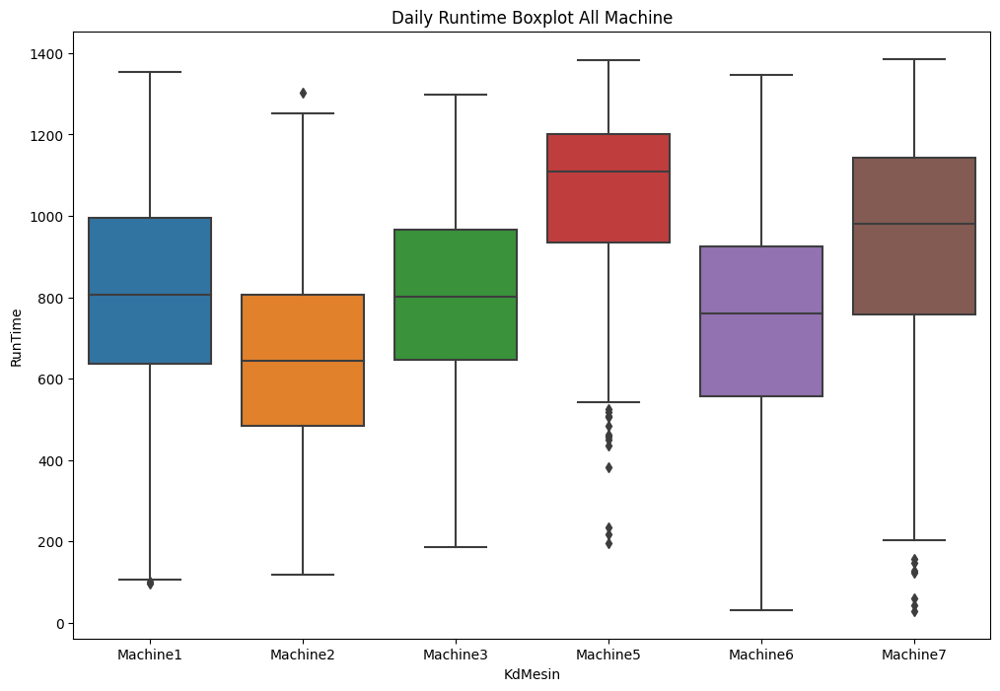

In [ ]:
pd.reset_option("display.max_rows")
# plot daily runtime boxplot per machine
plt.figure(figsize=(12,8))
sns.boxplot(x=run_mc['KdMesin'], y=run_mc['RunTime'], data=run_mc, orient="v")
plt.title('Daily Runtime Boxplot All Machine')
plt.show()

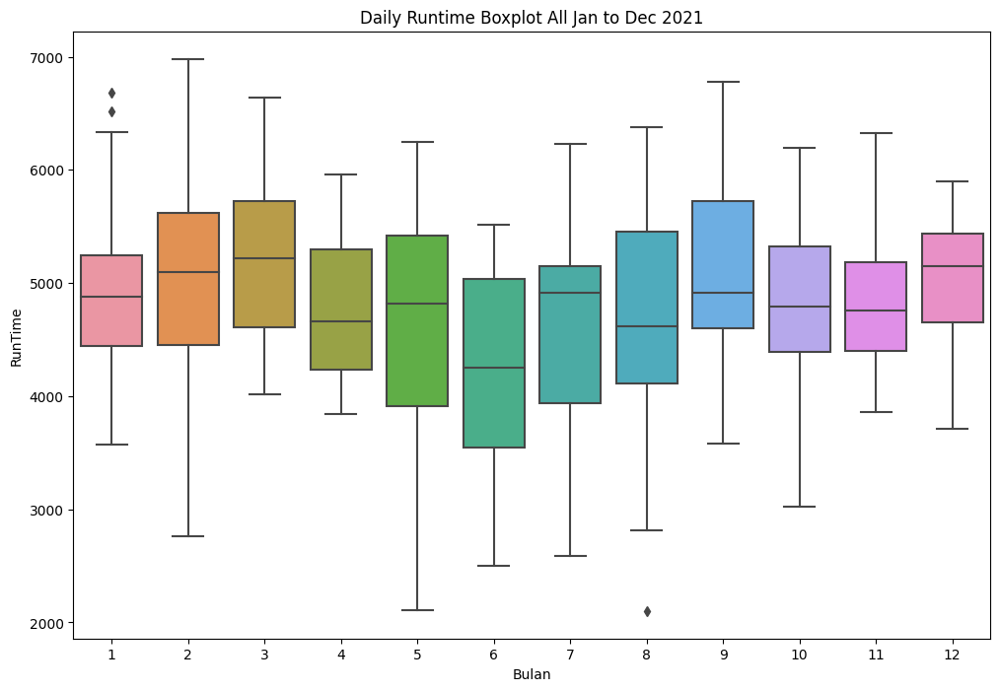

In [ ]:
# plot daily runtime boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='RunTime', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['Bulan'], y=box_run['RunTime'], data=box_run, orient="v")
plt.title('Daily Runtime Boxplot All Jan to Dec 2021')
plt.show()

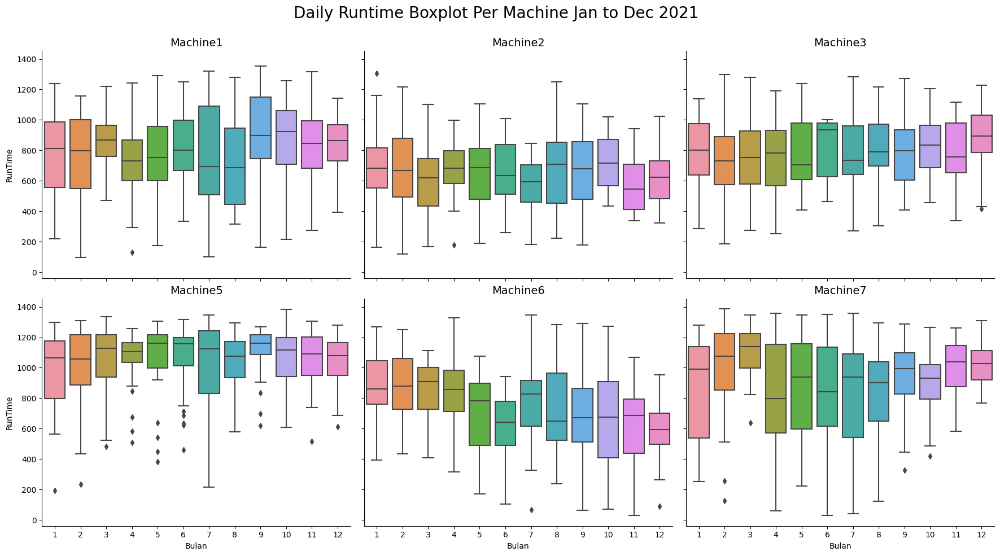

In [ ]:
# plot daily runtime boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='RunTime', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

g = sns.catplot(x= 'Bulan', y='RunTime', data=box_run,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('{col_name}', size=14)
g.fig.suptitle('Daily Runtime Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

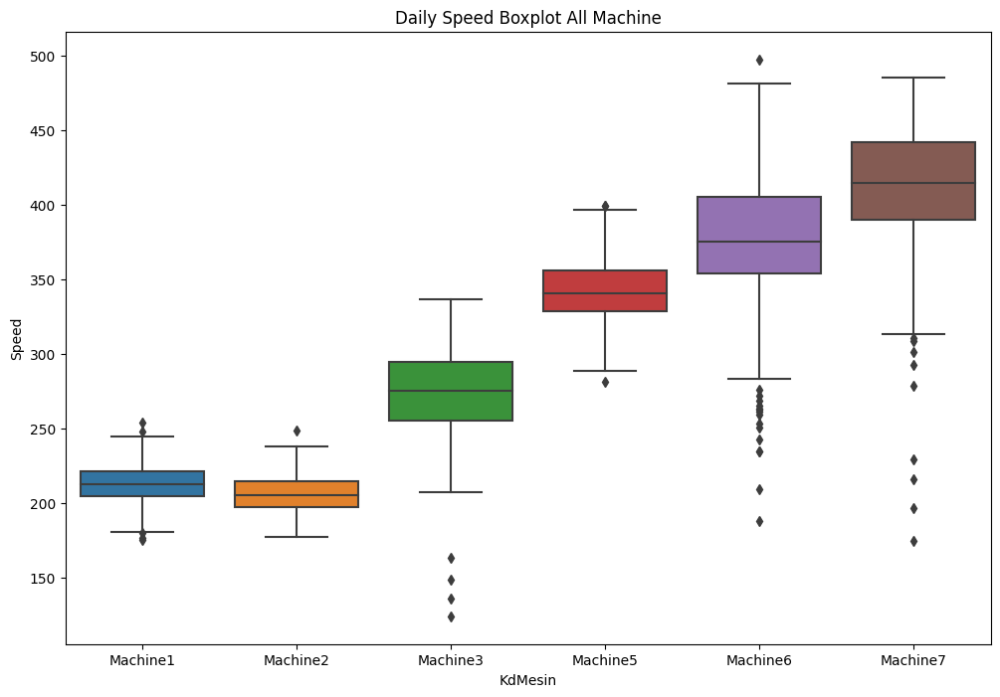

In [ ]:
# plot daily speed boxplot per machine
box_run = run.pivot_table(values='Speed', index=['Tgl','KdMesin'], fill_value=0, aggfunc=np.mean).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['KdMesin'], y=box_run['Speed'], data=box_run, orient="v")
plt.title('Daily Speed Boxplot All Machine')
plt.show()

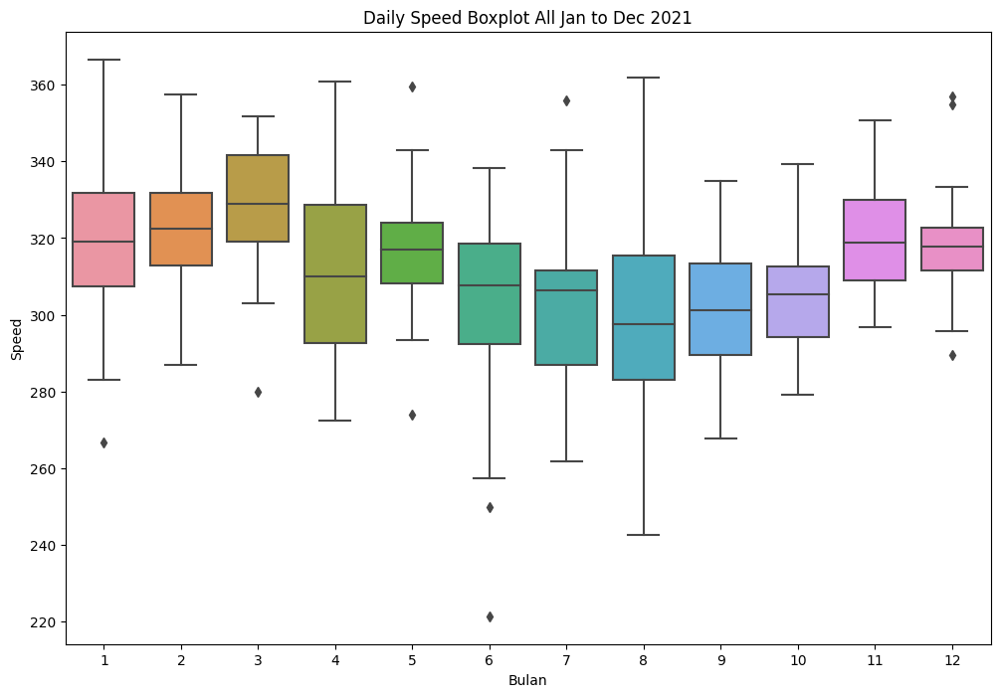

In [ ]:
# plot daily Speed boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='Speed', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.mean).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['Bulan'], y=box_run['Speed'], data=box_run, orient="v")
plt.title('Daily Speed Boxplot All Jan to Dec 2021')
plt.show()

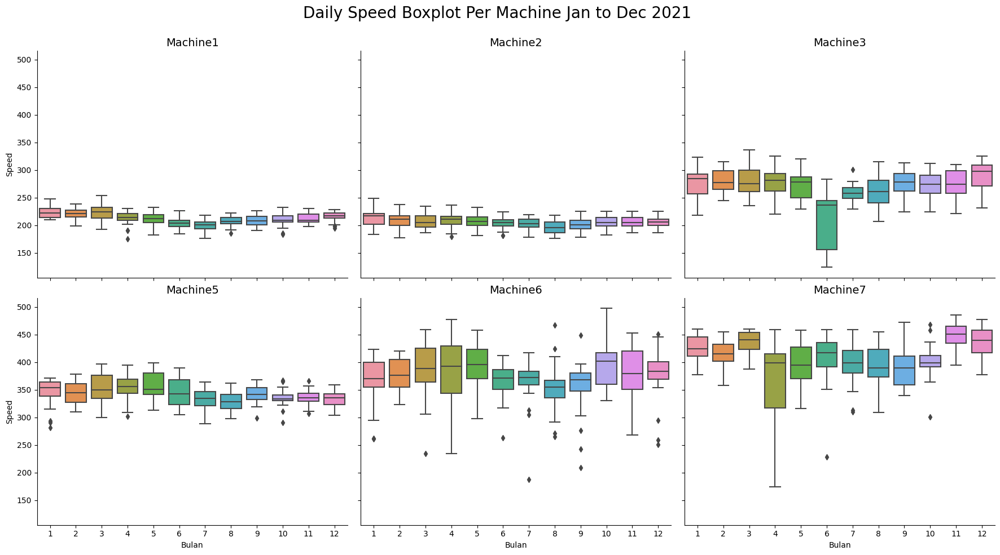

In [ ]:
# plot daily Speed boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='Speed', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.mean).reset_index()

g = sns.catplot(x= 'Bulan', y='Speed', data=box_run,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('{col_name}', size=14)
g.fig.suptitle('Daily Speed Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

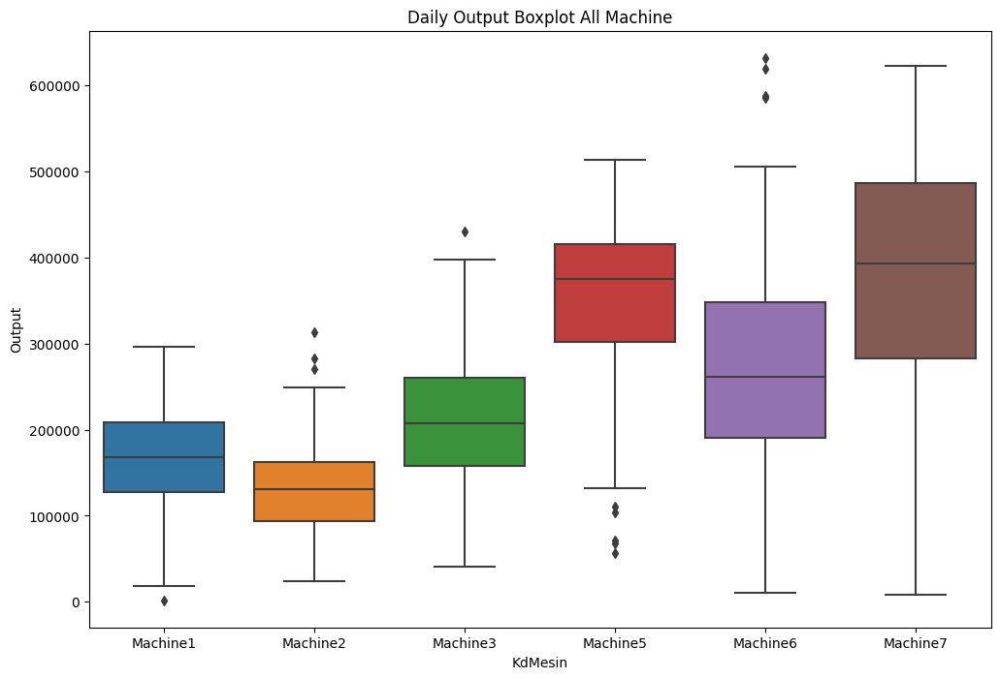

In [ ]:
# plot daily Output boxplot per machine
box_op = op.pivot_table(values='Output', index=['Tgl','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_op['KdMesin'], y=box_op['Output'], data=box_op, orient="v")
plt.title('Daily Output Boxplot All Machine')
plt.show()

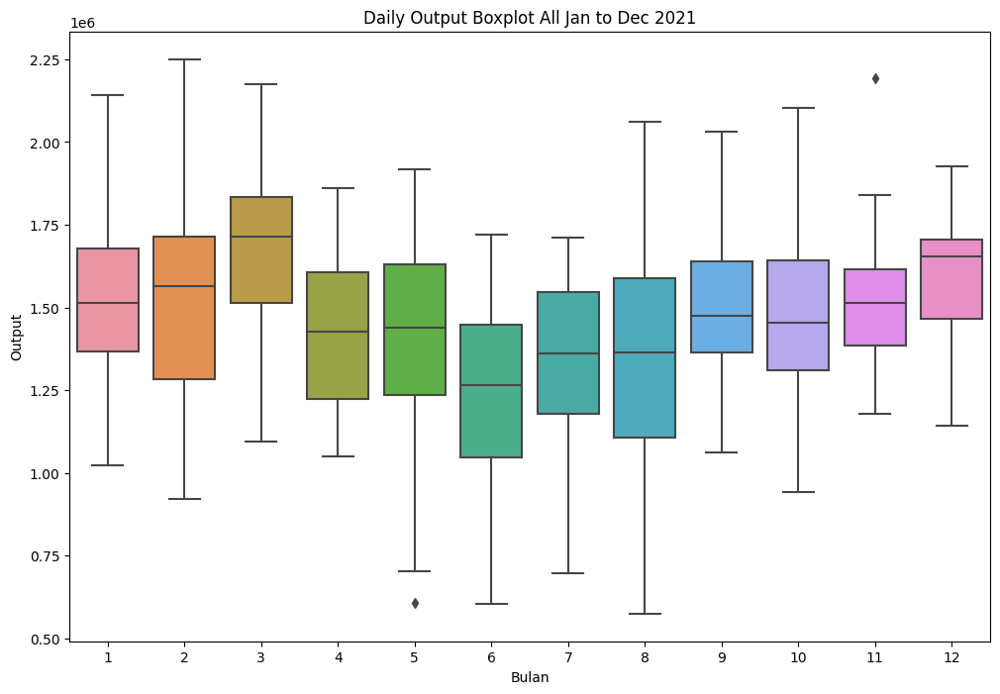

In [ ]:
# plot daily Output boxplot per Jan to Dec 2021
box_op = op.pivot_table(values='Output', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_op['Bulan'], y=box_op['Output'], data=box_op, orient="v")
plt.title('Daily Output Boxplot All Jan to Dec 2021')
plt.show()

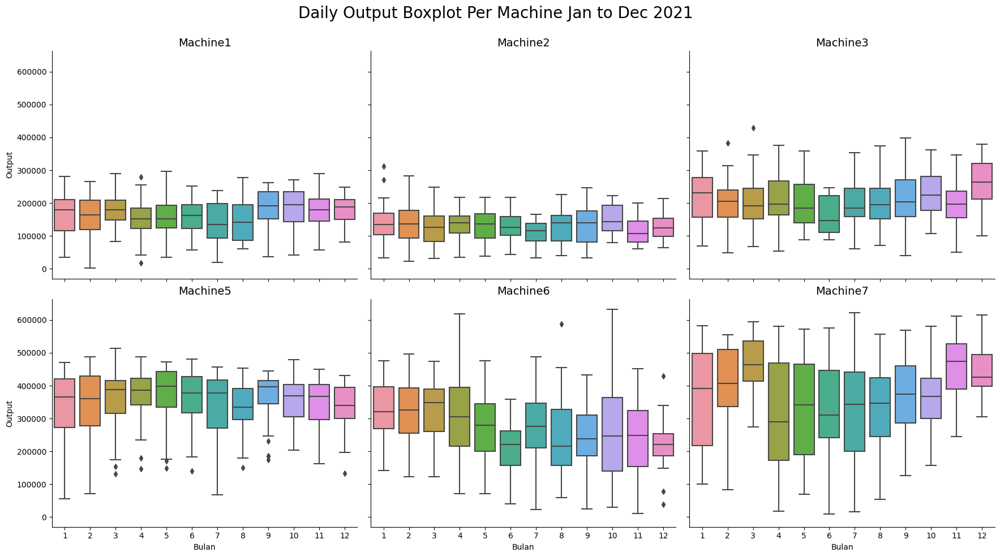

In [ ]:
# plot daily Output boxplot per Jan to Dec 2021
box_op = op.pivot_table(values='Output', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

g = sns.catplot(x= 'Bulan', y='Output', data=box_op,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('{col_name}', size=14)
g.fig.suptitle('Daily Output Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

### **Distribution**

In [ ]:
dist_Material1 = op[op['FILM']=='Material1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Material1['Speed'] = dist_Material1['Speed'].round(0).astype(int)
dist_Material1['RunTime'] = op[op['FILM']=='Material1'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Material1['Output'] = (dist_Material1['RunTime'] * dist_Material1['Speed'])

dist_Material2 = op[op['FILM']=='Material2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Material2['Speed'] = dist_Material2['Speed'].round(0).astype(int)
dist_Material2['RunTime'] = op[op['FILM']=='Material2'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Material2['Output'] = (dist_Material2['RunTime'] * dist_Material2['Speed'])

dist_Material3 = op[op['FILM']=='Material3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Material3['Speed'] = dist_Material3['Speed'].round(0).astype(int)
dist_Material3['RunTime'] = op[op['FILM']=='Material3'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Material3['Output'] = (dist_Material3['RunTime'] * dist_Material3['Speed'])

dist_Machine1 = op[op['KdMesin']=='Machine1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine1['Speed'] = dist_Machine1['Speed'].round(0).astype(int)
dist_Machine1['RunTime'] = op[op['KdMesin']=='Machine1'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine1['Output'] = (dist_Machine1['RunTime'] * dist_Machine1['Speed'])

dist_Machine2 = op[op['KdMesin']=='Machine2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine2['Speed'] = dist_Machine2['Speed'].round(0).astype(int)
dist_Machine2['RunTime'] = op[op['KdMesin']=='Machine2'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine2['Output'] = (dist_Machine2['RunTime'] * dist_Machine2['Speed'])

dist_Machine3 = op[op['KdMesin']=='Machine3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine3['Speed'] = dist_Machine3['Speed'].round(0).astype(int)
dist_Machine3['RunTime'] = op[op['KdMesin']=='Machine3'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine3['Output'] = (dist_Machine3['RunTime'] * dist_Machine3['Speed'])

dist_Machine5 = op[op['KdMesin']=='Machine5'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine5['Speed'] = dist_Machine5['Speed'].round(0).astype(int)
dist_Machine5['RunTime'] = op[op['KdMesin']=='Machine5'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine5['Output'] = (dist_Machine5['RunTime'] * dist_Machine5['Speed'])

dist_Machine6 = op[op['KdMesin']=='Machine6'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine6['Speed'] = dist_Machine6['Speed'].round(0).astype(int)
dist_Machine6['RunTime'] = op[op['KdMesin']=='Machine6'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine6['Output'] = (dist_Machine6['RunTime'] * dist_Machine6['Speed'])

dist_Machine7 = op[op['KdMesin']=='Machine7'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_Machine7['Speed'] = dist_Machine7['Speed'].round(0).astype(int)
dist_Machine7['RunTime'] = op[op['KdMesin']=='Machine7'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_Machine7['Output'] = (dist_Machine7['RunTime'] * dist_Machine7['Speed'])

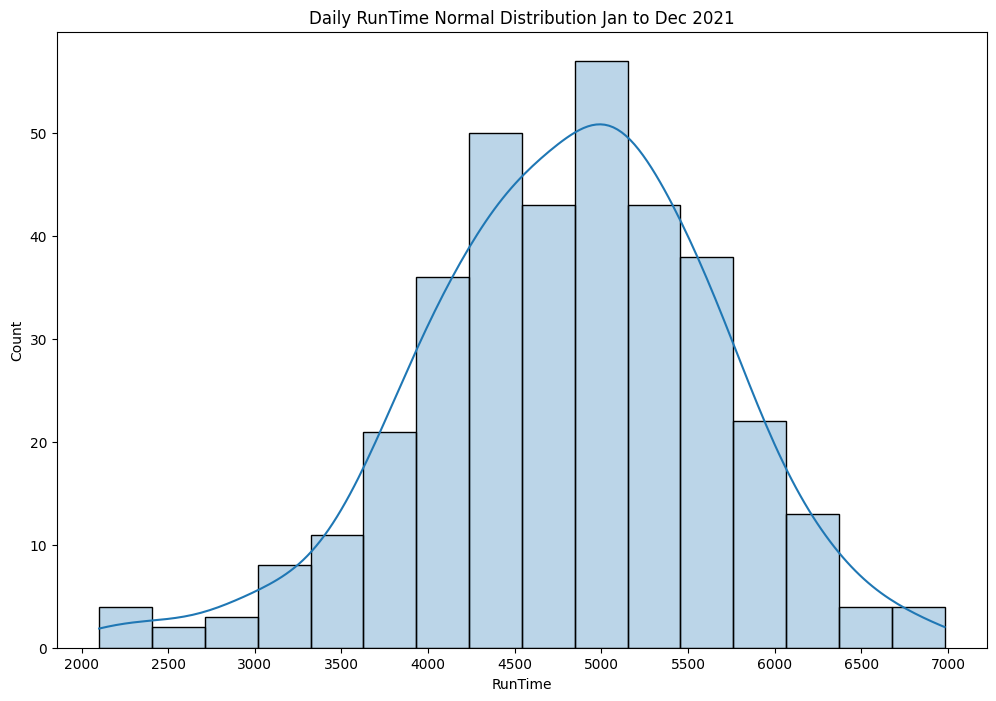

In [ ]:
# plot daily RunTime distribution
dist_run = run.pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_run['RunTime'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily RunTime Normal Distribution Jan to Dec 2021')
ax.set_xticks(np.arange(start=2000,stop=7500,step=500))
plt.show()

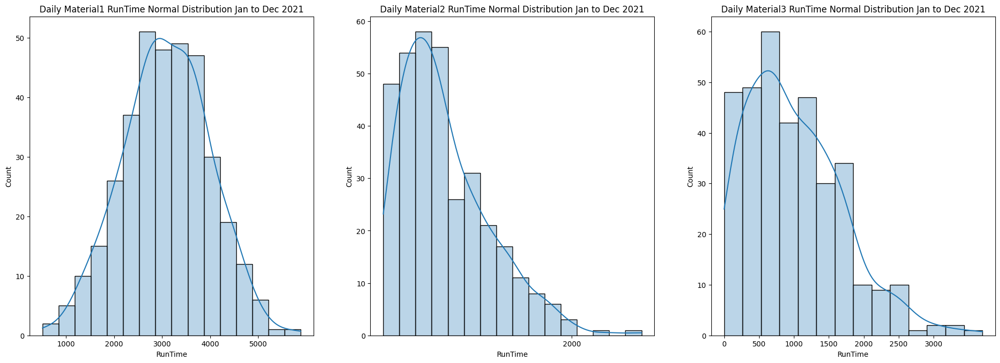

In [ ]:
# plotting runtime normal dist per material

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material Material1
sns.histplot(dist_Material1['RunTime'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily Material1 RunTime Normal Distribution Jan to Dec 2021')
axarr[0].set_xticks(np.arange(start=1000,stop=6000,step=1000))

# plot material Material2
sns.histplot(dist_Material2['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily Material2 RunTime Normal Distribution Jan to Dec 2021')
axarr[1].set_xticks(np.arange(start=2000,stop=2500,step=500))

# plot material Material3
sns.histplot(dist_Material3['RunTime'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily Material3 RunTime Normal Distribution Jan to Dec 2021')
axarr[2].set_xticks(np.arange(start=0,stop=3500,step=500))

plt.show()

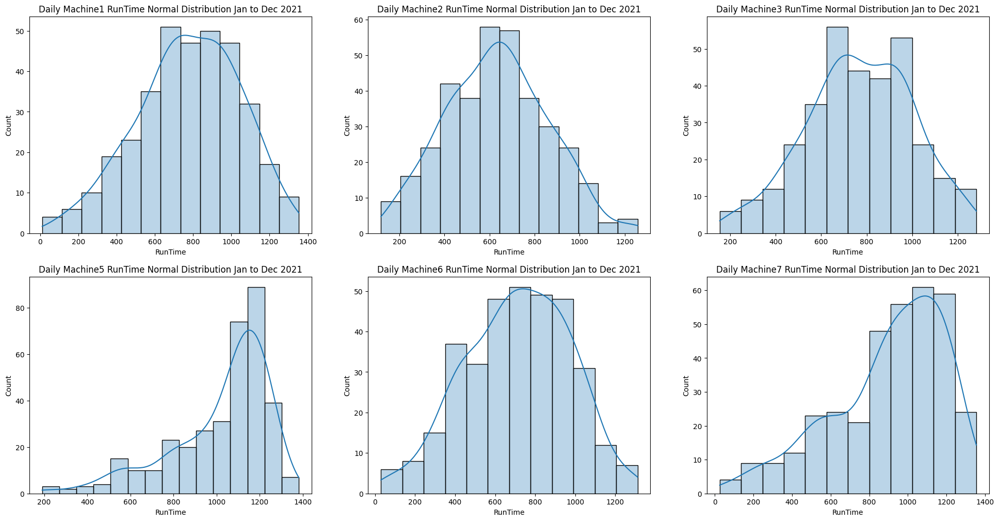

In [ ]:
# plotting runtime normal dist per machine

f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material Machine1
sns.histplot(dist_Machine1['RunTime'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily Machine1 RunTime Normal Distribution Jan to Dec 2021')

# plot material Machine2
sns.histplot(dist_Machine2['RunTime'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily Machine2 RunTime Normal Distribution Jan to Dec 2021')

# plot material Machine3
sns.histplot(dist_Machine3['RunTime'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily Machine3 RunTime Normal Distribution Jan to Dec 2021')

# plot material Machine5
sns.histplot(dist_Machine5['RunTime'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily Machine5 RunTime Normal Distribution Jan to Dec 2021')

# plot material Machine6
sns.histplot(dist_Machine6['RunTime'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily Machine6 RunTime Normal Distribution Jan to Dec 2021')

# plot material Machine7
sns.histplot(dist_Machine7['RunTime'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily Machine7 RunTime Normal Distribution Jan to Dec 2021')

plt.show()

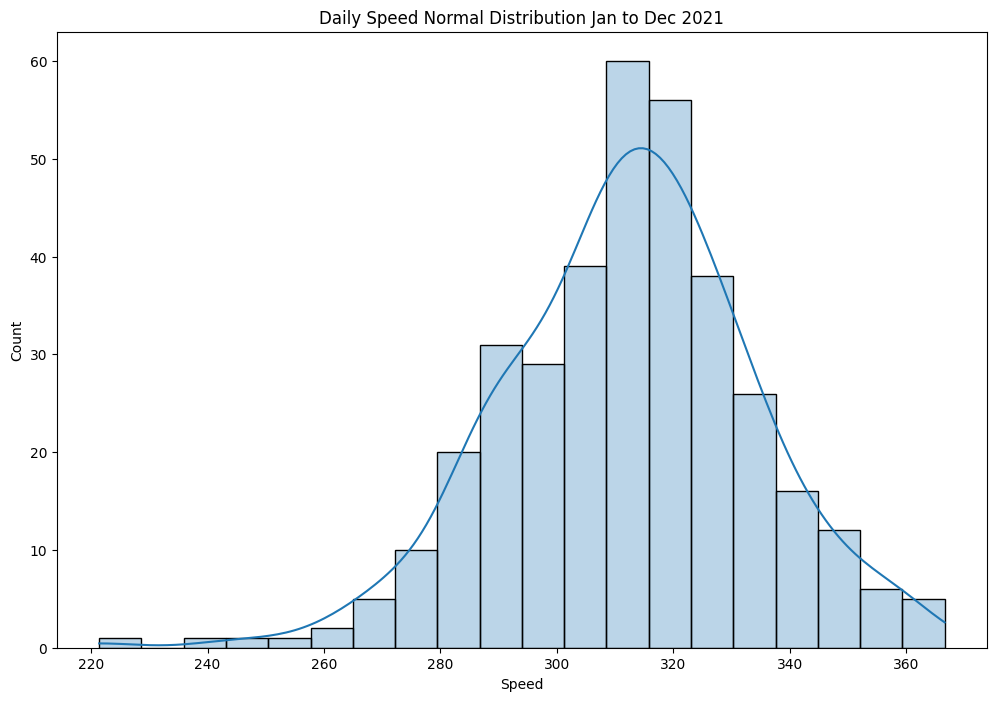

In [ ]:
# plot daily speed distribution
dist_run = run.pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_run['Speed'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Speed Normal Distribution Jan to Dec 2021')
plt.show()

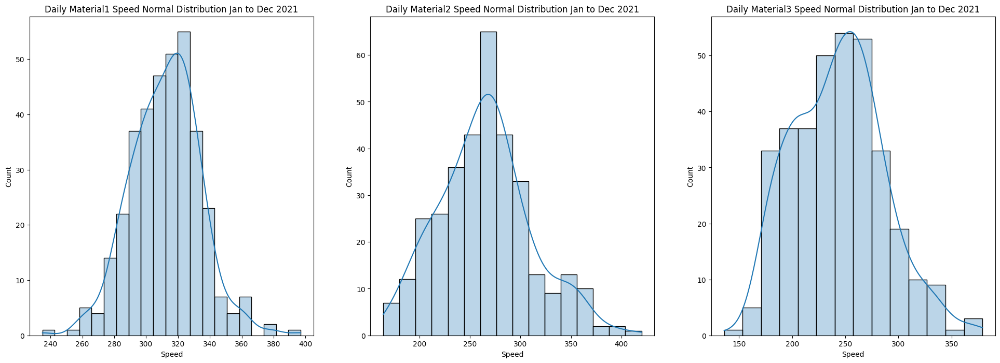

In [ ]:
# plotting Speed normal dist per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material Material1
sns.histplot(dist_Material1['Speed'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily Material1 Speed Normal Distribution Jan to Dec 2021')

# plot material Material2
sns.histplot(dist_Material2['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily Material2 Speed Normal Distribution Jan to Dec 2021')

# plot material Material3
sns.histplot(dist_Material3['Speed'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily Material3 Speed Normal Distribution Jan to Dec 2021')

plt.show()

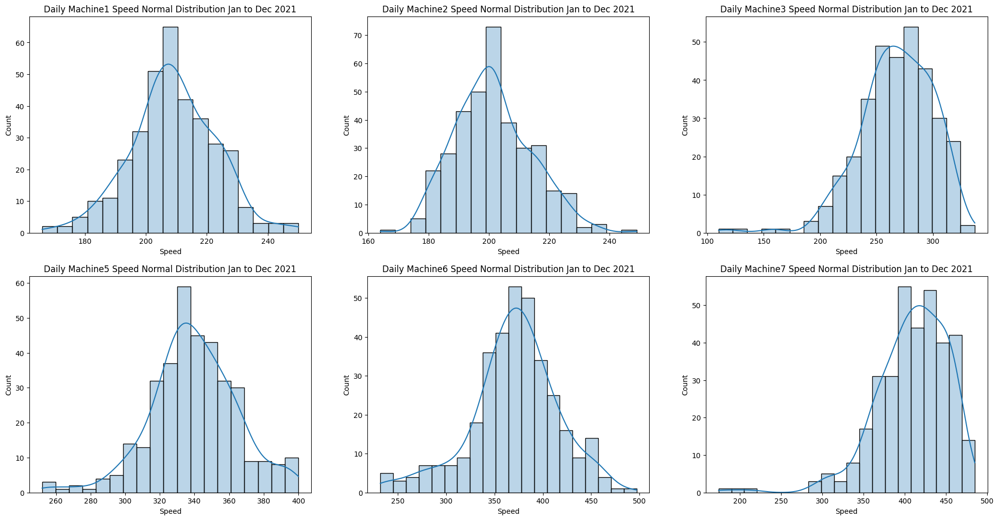

In [ ]:
# plotting Speed normal dist per material
f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material Machine1
sns.histplot(dist_Machine1['Speed'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily Machine1 Speed Normal Distribution Jan to Dec 2021')

# plot material Machine2
sns.histplot(dist_Machine2['Speed'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily Machine2 Speed Normal Distribution Jan to Dec 2021')

# plot material Machine3
sns.histplot(dist_Machine3['Speed'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily Machine3 Speed Normal Distribution Jan to Dec 2021')

# plot material Machine5
sns.histplot(dist_Machine5['Speed'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily Machine5 Speed Normal Distribution Jan to Dec 2021')

# plot material Machine6
sns.histplot(dist_Machine6['Speed'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily Machine6 Speed Normal Distribution Jan to Dec 2021')

# plot material Machine7
sns.histplot(dist_Machine7['Speed'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily Machine7 Speed Normal Distribution Jan to Dec 2021')

plt.show()

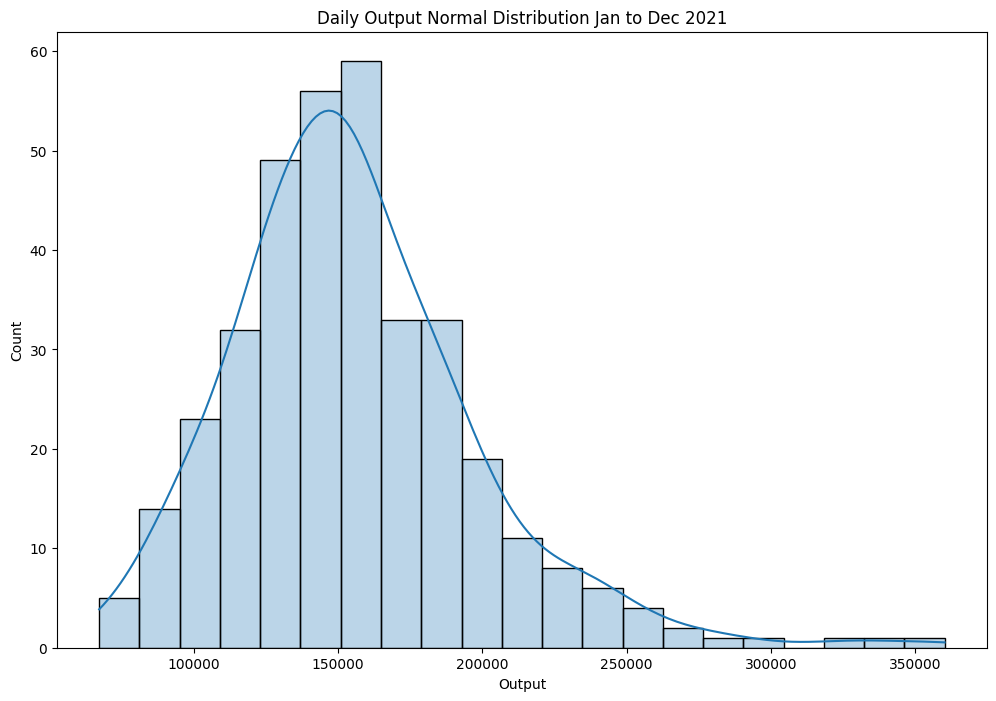

In [ ]:
# plot daily output distribution
dist_op = op.pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_op['Output'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Output Normal Distribution Jan to Dec 2021')
ax.set_xlabel('Output')
plt.show()

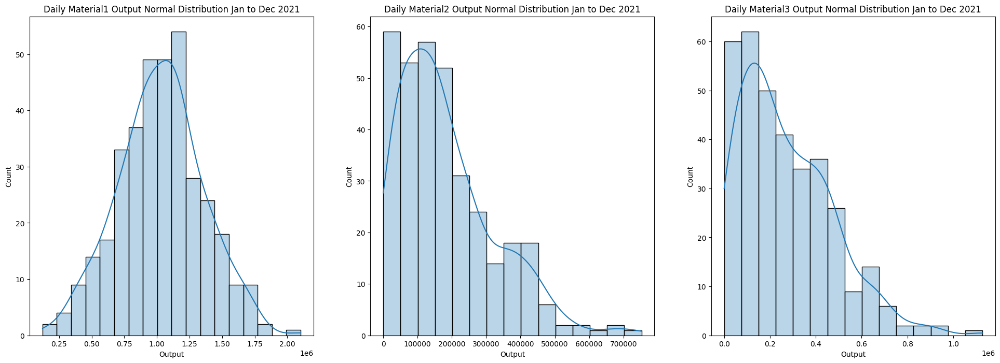

In [ ]:
# plotting output normal dist per material
dist_Material1 = op[op['FILM']=='Material1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Material2 = op[op['FILM']=='Material2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Material3 = op[op['FILM']=='Material3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material Material1
sns.histplot(dist_Material1['Output'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily Material1 Output Normal Distribution Jan to Dec 2021')

# plot material Material2
sns.histplot(dist_Material2['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily Material2 Output Normal Distribution Jan to Dec 2021')

# plot material Material3
sns.histplot(dist_Material3['Output'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily Material3 Output Normal Distribution Jan to Dec 2021')

plt.show()

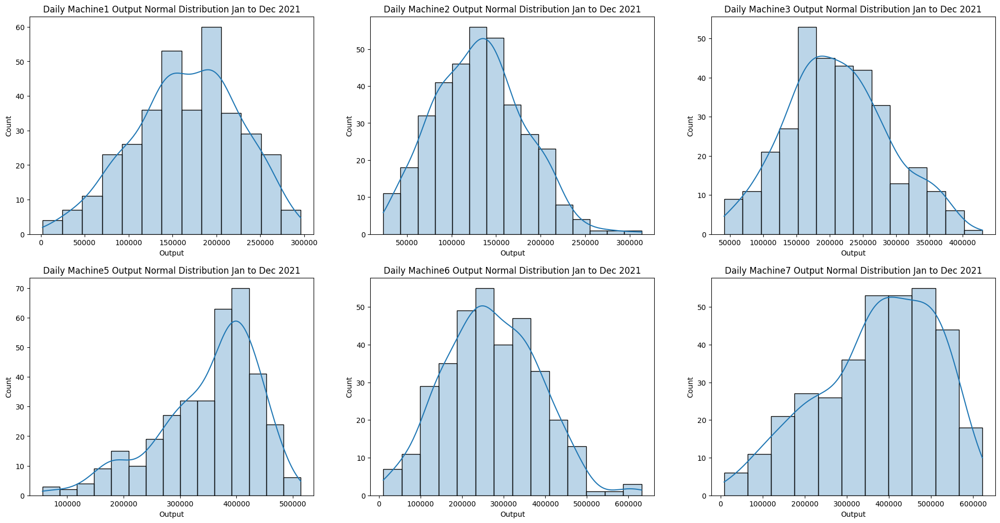

In [ ]:
# plotting Output normal dist per material
dist_Machine1 = op[op['KdMesin']=='Machine1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Machine2 = op[op['KdMesin']=='Machine2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Machine3 = op[op['KdMesin']=='Machine3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Machine5 = op[op['KdMesin']=='Machine5'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Machine6 = op[op['KdMesin']=='Machine6'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Machine7 = op[op['KdMesin']=='Machine7'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material Machine1
sns.histplot(dist_Machine1['Output'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily Machine1 Output Normal Distribution Jan to Dec 2021')

# plot material Machine2
sns.histplot(dist_Machine2['Output'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily Machine2 Output Normal Distribution Jan to Dec 2021')

# plot material Machine3
sns.histplot(dist_Machine3['Output'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily Machine3 Output Normal Distribution Jan to Dec 2021')

# plot material Machine5
sns.histplot(dist_Machine5['Output'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily Machine5 Output Normal Distribution Jan to Dec 2021')

# plot material Machine6
sns.histplot(dist_Machine6['Output'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily Machine6 Output Normal Distribution Jan to Dec 2021')

# plot material Machine7
sns.histplot(dist_Machine7['Output'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily Machine7 Output Normal Distribution Jan to Dec 2021')

plt.show()

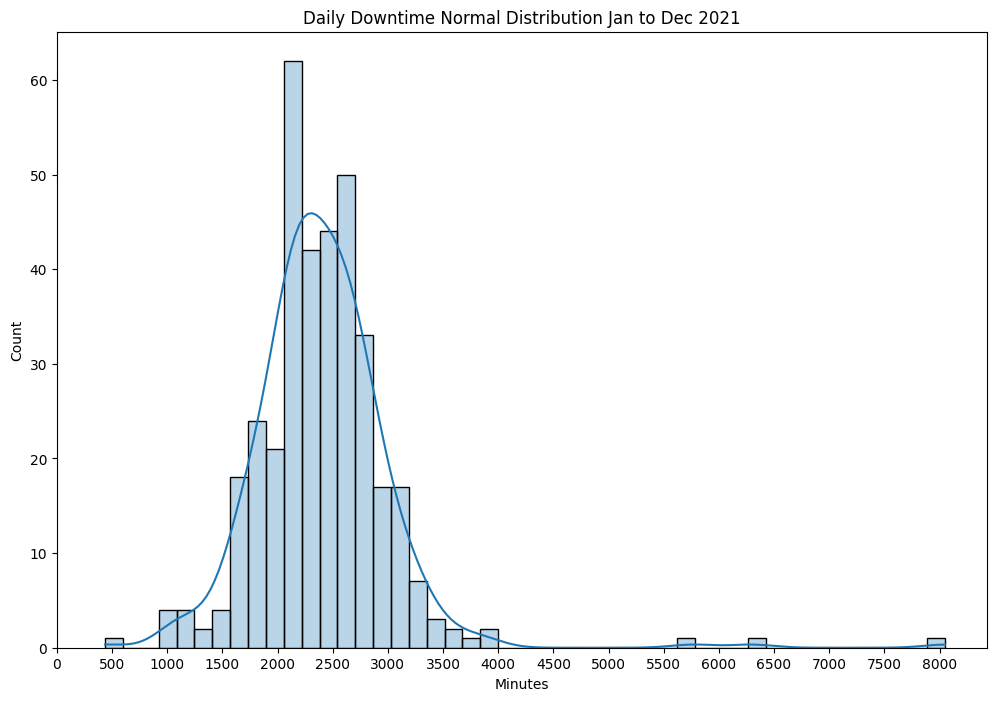

In [ ]:
# plot daily Downtime distribution
dist_down = down.pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_down['Downtime'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Downtime Normal Distribution Jan to Dec 2021')
ax.set_xlabel('Minutes')
ax.set_xticks([0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,6500,7000,7500,8000])
plt.show()

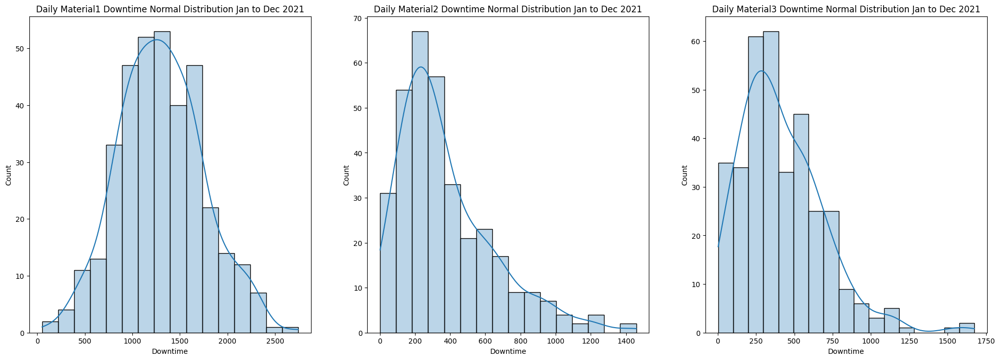

In [ ]:
# plotting Downtime normal dist per material
dist_Material1 = down[down['FILM']=='Material1'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Material2 = down[down['FILM']=='Material2'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_Material3 = down[down['FILM']=='Material3'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material Material1
sns.histplot(dist_Material1['Downtime'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily Material1 Downtime Normal Distribution Jan to Dec 2021')

# plot material Material2
sns.histplot(dist_Material2['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily Material2 Downtime Normal Distribution Jan to Dec 2021')

# plot material Material3
sns.histplot(dist_Material3['Downtime'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily Material3 Downtime Normal Distribution Jan to Dec 2021')

plt.show()

## **2. Runtime, Speed, and TCL by Material**

### **Per Machine**

In [ ]:
# data Material1
mc_Material1 = run[run['FILM']=='Material1'].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_Material1['Speed'] = np.ceil(mc_Material1['Speed']).astype(int)
mc_Material1['target'] = np.ceil(mc_Material1['target']).astype(int)

mc_Material1['RunTime'] = run[run['FILM']=='Material1'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_Material1['Output'] = mc_Material1['Speed'] * mc_Material1['RunTime']

# data Material2
mc_Material2 = run[(run['FILM']=='Material2')].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_Material2['Speed'] = np.ceil(mc_Material2['Speed']).astype(int) #round-up to whole number
mc_Material2['target'] = np.ceil(mc_Material2['target']).astype(int)

mc_Material2['RunTime'] = run[run['FILM']=='Material2'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_Material2['Output'] = mc_Material2['Speed'] * mc_Material2['RunTime']

# data Material3
mc_Material3 = run[(run['FILM']=='Material3')].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_Material3['Speed'] = np.ceil(mc_Material3['Speed']).astype(int)
mc_Material3['target'] = np.ceil(mc_Material3['target']).astype(int)

mc_Material3['RunTime'] = run[run['FILM']=='Material3'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_Material3['Output'] = mc_Material3['Speed'] * mc_Material3['RunTime']

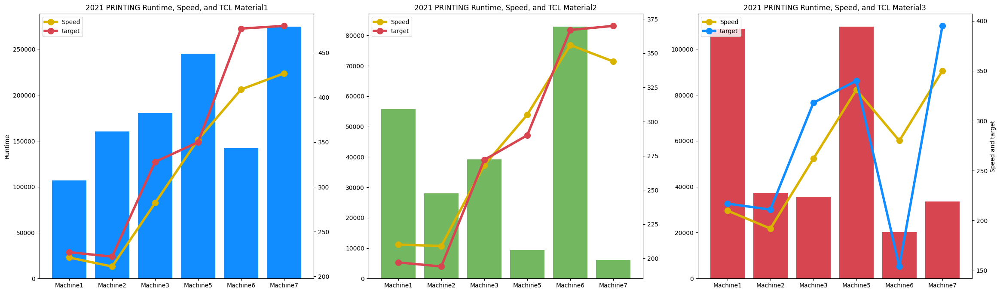

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(mc_Material1['KdMesin'],mc_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(mc_Material1['KdMesin'],mc_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_Material1['KdMesin'],mc_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('2021 PRINTING Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(mc_Material2['KdMesin'],mc_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(mc_Material2['KdMesin'],mc_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_Material2['KdMesin'],mc_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('2021 PRINTING Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(mc_Material3['KdMesin'],mc_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(mc_Material3['KdMesin'],mc_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_Material3['KdMesin'],mc_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('2021 PRINTING Runtime, Speed, and TCL Material3')
plt.show()

### **Monthly**

In [ ]:
# data Material1
month_Material1 = run[run['FILM']=='Material1'].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[run['FILM']=='Material1'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material2
month_Material2 = run[(run['FILM']=='Material2')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[run['FILM']=='Material2'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[run['FILM']=='Material3'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])


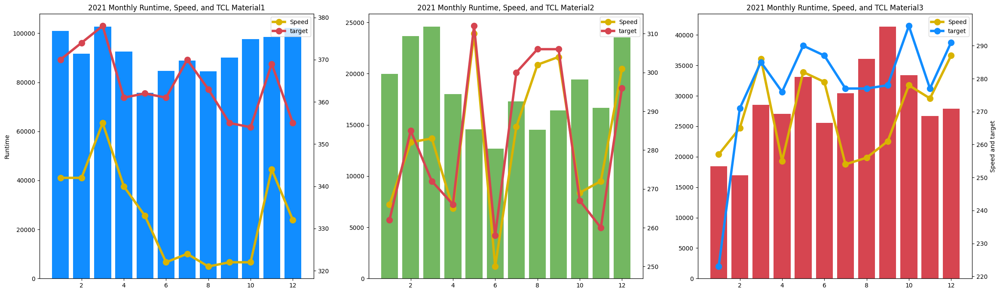

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('2021 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('2021 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('2021 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine1**

In [ ]:
# data Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine1')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine1')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine1')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine1')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine1')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine1')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

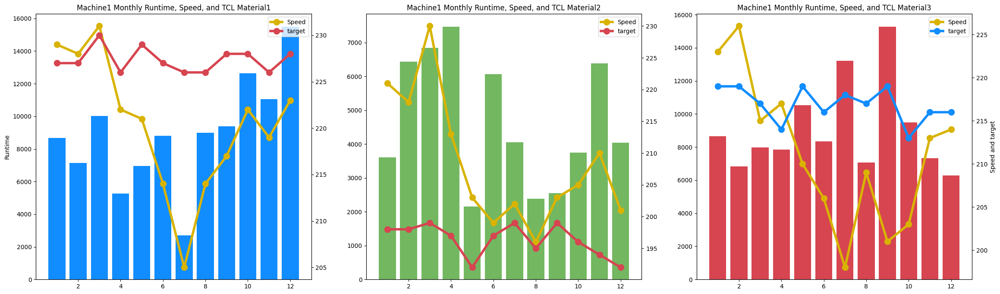

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine1 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine1 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine1 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine2**

In [ ]:
# data material Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine2')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine2')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine2')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine2')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine2')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine2')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

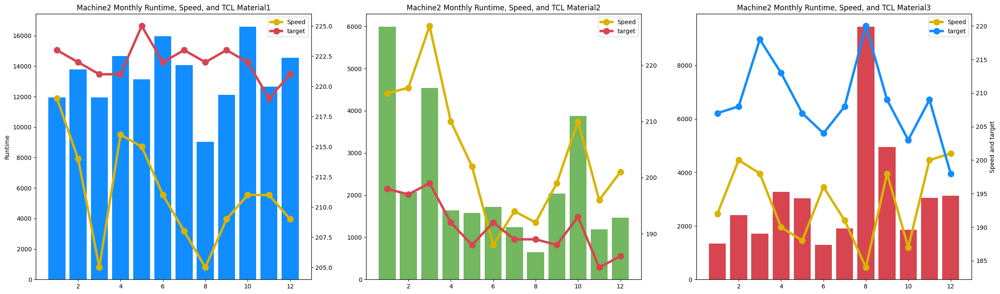

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine2 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine2 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine2 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine3**

In [ ]:
# data material Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine3')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine3')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine3')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine3')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine3')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine3')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

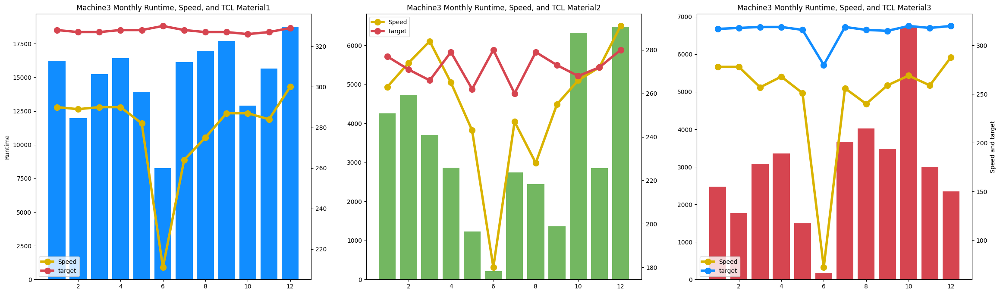

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine3 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine3 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine3 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine5**

In [ ]:
# data material Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine5')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine5')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine5')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine5')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine5')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine5')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

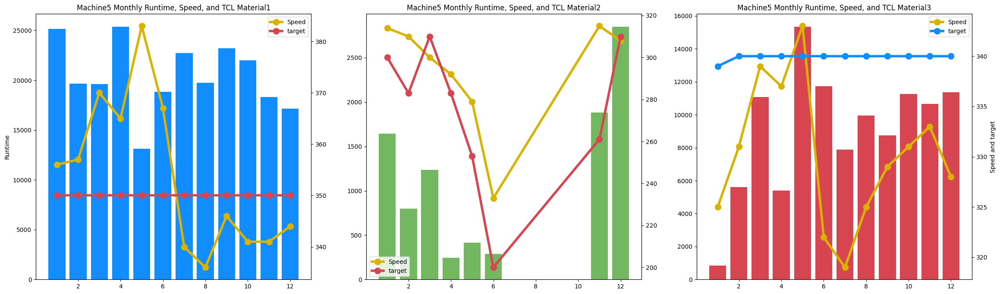

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine5 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine5 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine5 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine6**

In [ ]:
# data material Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine6')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine6')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine6')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine6')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine6')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine6')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

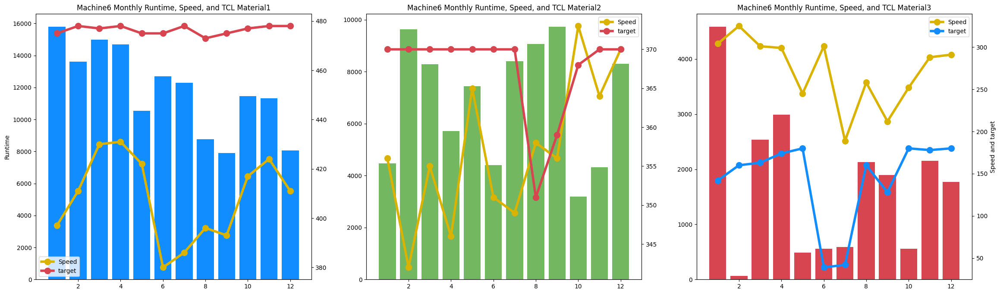

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine6 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine6 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine6 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Monthly for Machine7**

In [ ]:
# data material Material1
month_Material1 = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine7')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material1['Speed'] = np.ceil(month_Material1['Speed']).astype(int)
month_Material1['target'] = np.ceil(month_Material1['target']).astype(int)
month_Material1['RunTime'] = run[(run['FILM']=='Material1')&(run['KdMesin']=='Machine7')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material Material2
month_Material2 = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine7')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material2['Speed'] = np.ceil(month_Material2['Speed']).astype(int) #round-up to whole number
month_Material2['target'] = np.ceil(month_Material2['target']).astype(int)
month_Material2['RunTime'] = run[(run['FILM']=='Material2')&(run['KdMesin']=='Machine7')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data Material3
month_Material3 = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine7')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_Material3['Speed'] = np.ceil(month_Material3['Speed']).astype(int)
month_Material3['target'] = np.ceil(month_Material3['target']).astype(int)
month_Material3['RunTime'] = run[(run['FILM']=='Material3')&(run['KdMesin']=='Machine7')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

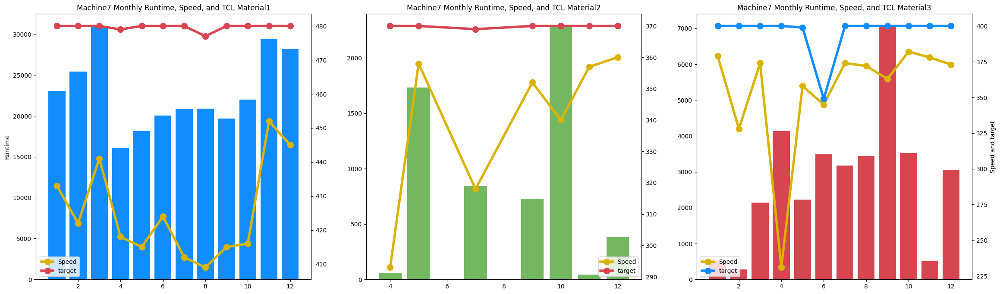

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot Material1
plt.sca(axarr[0]);
plt.bar(month_Material1['Bulan'],month_Material1['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_Material1['Bulan'],month_Material1['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material1['Bulan'],month_Material1['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('Machine7 Monthly Runtime, Speed, and TCL Material1')

# plot Material2
plt.sca(axarr[1]);
plt.bar(month_Material2['Bulan'],month_Material2['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_Material2['Bulan'],month_Material2['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material2['Bulan'],month_Material2['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('Machine7 Monthly Runtime, Speed, and TCL Material2')

# plot Material3
plt.sca(axarr[2]);
plt.bar(month_Material3['Bulan'],month_Material3['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_Material3['Bulan'],month_Material3['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_Material3['Bulan'],month_Material3['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('Machine7 Monthly Runtime, Speed, and TCL Material3')

plt.show()

### **Line Plot**

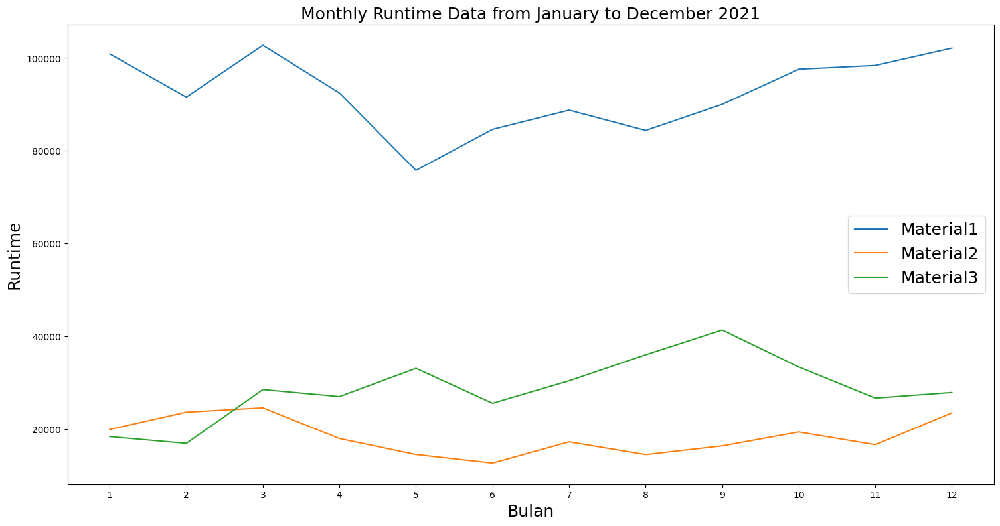

In [ ]:
# plotting daily runtime per material
run_monthly.plot('Bulan',['Material1','Material2','Material3'],figsize=(18 , 9)).legend(loc='best', fontsize=18)
plt.xlabel('Bulan', fontsize=18)
plt.ylabel('Runtime', fontsize=18)
plt.title('Monthly Runtime Data from January to December 2021', fontsize=18)
plt.xticks(run_monthly['Bulan'])
plt.show()

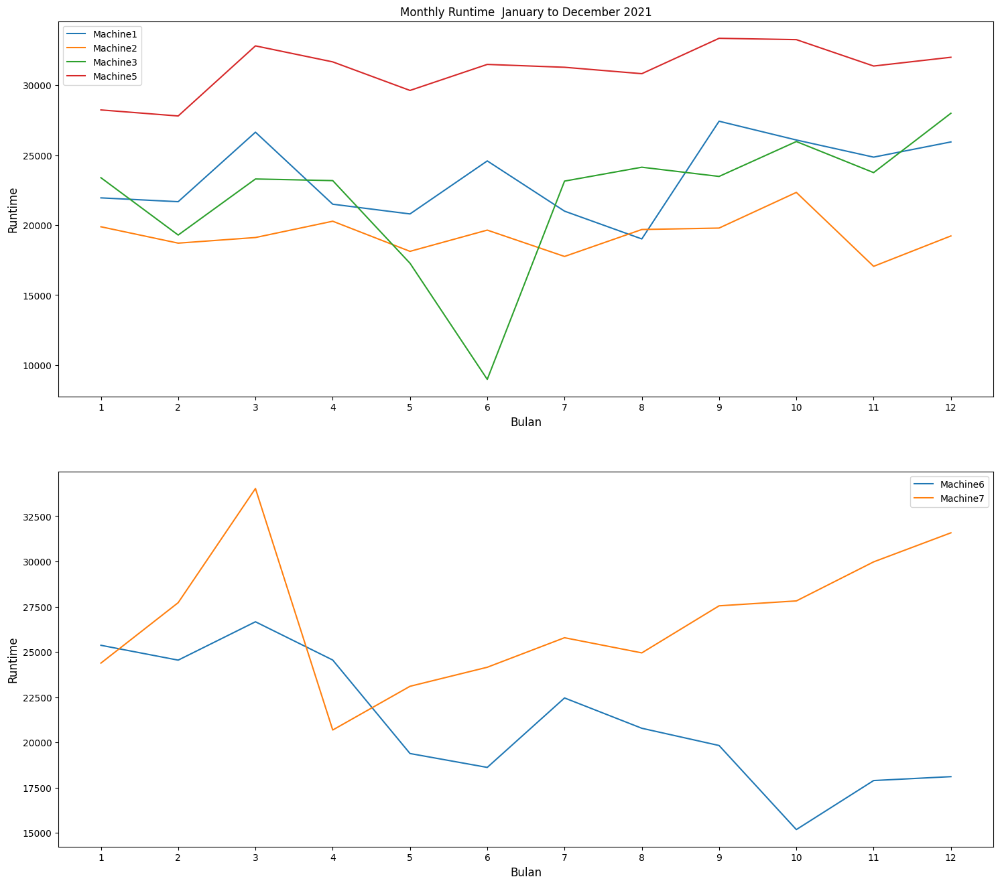

In [ ]:
# plotting daily runtime by machine
f, ax = plt.subplots(nrows=2,ncols=1,figsize=(18, 16))
line1, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['Machine1'],label='Machine1')
line2, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['Machine2'],label='Machine2')
line3, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['Machine3'],label='Machine3')
line5, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['Machine5'],label='Machine5')
ax[0].legend()
ax[0].set_xlabel('Bulan', fontsize=12)
ax[0].set_ylabel('Runtime', fontsize=12)
ax[0].set_title('Monthly Runtime  January to December 2021', fontsize=12)
ax[0].set_xticks(rmc_monthly['Bulan'])

line1, = ax[1].plot(rmc_monthly['Bulan'],rmc_monthly['Machine6'],label='Machine6')
line2, = ax[1].plot(rmc_monthly['Bulan'],rmc_monthly['Machine7'],label='Machine7')
ax[1].legend()
ax[1].set_xlabel('Bulan', fontsize=12)
ax[1].set_ylabel('Runtime', fontsize=12)
ax[1].set_xticks(rmc_monthly['Bulan'])

plt.xticks(run_monthly['Bulan'])
plt.show()

## **3. Output by Material**

In [ ]:
op_films = op.pivot_table(values='Output',index=['KdMesin'],columns='FILM',aggfunc='sum').reset_index().rename_axis(None, axis=1)
op_films

,KdMesin,Material1,Material2,Material3,Material6
0,Machine1,23650404.0,11704891.0,22761432.0,1800.0
1,Machine2,33817265.0,5847204.0,7166236.0,NaN
2,Machine3,50690800.0,10473558.0,9322436.0,65466.0
3,Machine5,86311408.0,2854057.0,36327346.0,NaN
4,Machine6,58013533.0,29496510.0,5686715.0,NaN
5,Machine7,117228383.0,2089210.0,11726848.0,NaN


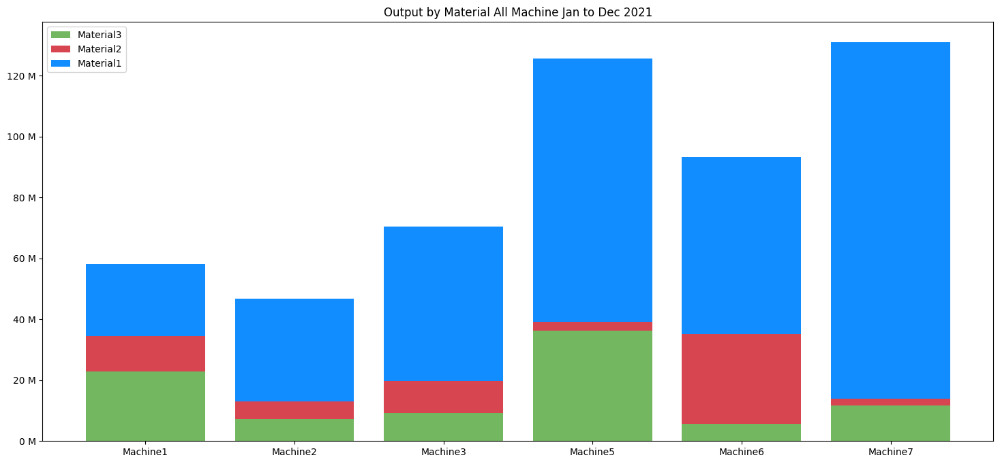

In [ ]:
# function for y-axis format in millions
@ticker.FuncFormatter
def million_formatter(x, pos):
    return "%.0f M" % (x/1E6)
    
# plotting output per film per machine
fig, ax = plt.subplots(figsize=(18, 8))
ax.bar(op_films['KdMesin'], op_films['Material3'], label='Material3',color='#73b761')
ax.bar(op_films['KdMesin'], op_films['Material2'], bottom=op_films['Material3'],label='Material2',color='#d64550')
ax.bar(op_films['KdMesin'], op_films['Material1'], 
       bottom=op_films['Material3']+np.array(op_films['Material2']),
       label='Material1',color='#118dff')
ax.set_title('Output by Material All Machine Jan to Dec 2021')
ax.yaxis.set_major_formatter(million_formatter)
ax.legend(loc='upper left')
plt.show()

In [ ]:
# output monthly per film
op_order = op.pivot_table(values='Output',index=['Bulan'],columns='FILM',aggfunc='sum').reset_index().rename_axis(None, axis=1)
op_order

,Bulan,Material1,Material2,Material3,Material6
0,1,34478729.0,5295750.0,4728623.0,NaN
1,2,31304835.0,6673235.0,4482156.0,NaN
2,3,36470796.0,6959086.0,8154028.0,NaN
3,4,31345912.0,4757298.0,6883186.0,NaN
4,5,25225076.0,4499931.0,9313111.0,NaN
5,6,27189112.0,3172105.0,7127125.0,NaN
6,7,28740114.0,4931477.0,7728238.0,NaN
7,8,27039649.0,4384153.0,9216295.0,NaN
8,9,28927404.0,4988521.0,10771505.0,NaN
9,10,31369468.0,5216090.0,9283590.0,NaN


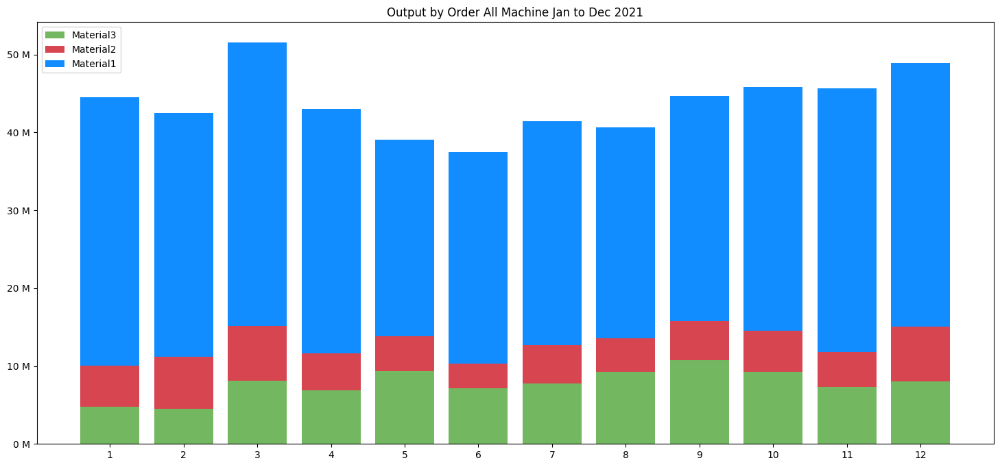

In [ ]:
# plotting output per film per month
fig, ax = plt.subplots(figsize=(18, 8))
ax.bar(op_order['Bulan'], op_order['Material3'], label='Material3',color='#73b761')
ax.bar(op_order['Bulan'], op_order['Material2'], bottom=op_order['Material3'],label='Material2',color='#d64550')
ax.bar(op_order['Bulan'], op_order['Material1'], bottom=op_order['Material3']+np.array(op_order['Material2']),
       label='Material1',color='#118dff')
ax.set_title('Output by Order All Machine Jan to Dec 2021')
ax.yaxis.set_major_formatter(million_formatter)
ax.legend(loc='upper left')
ax.set_xticks(op_order['Bulan'])
plt.show()

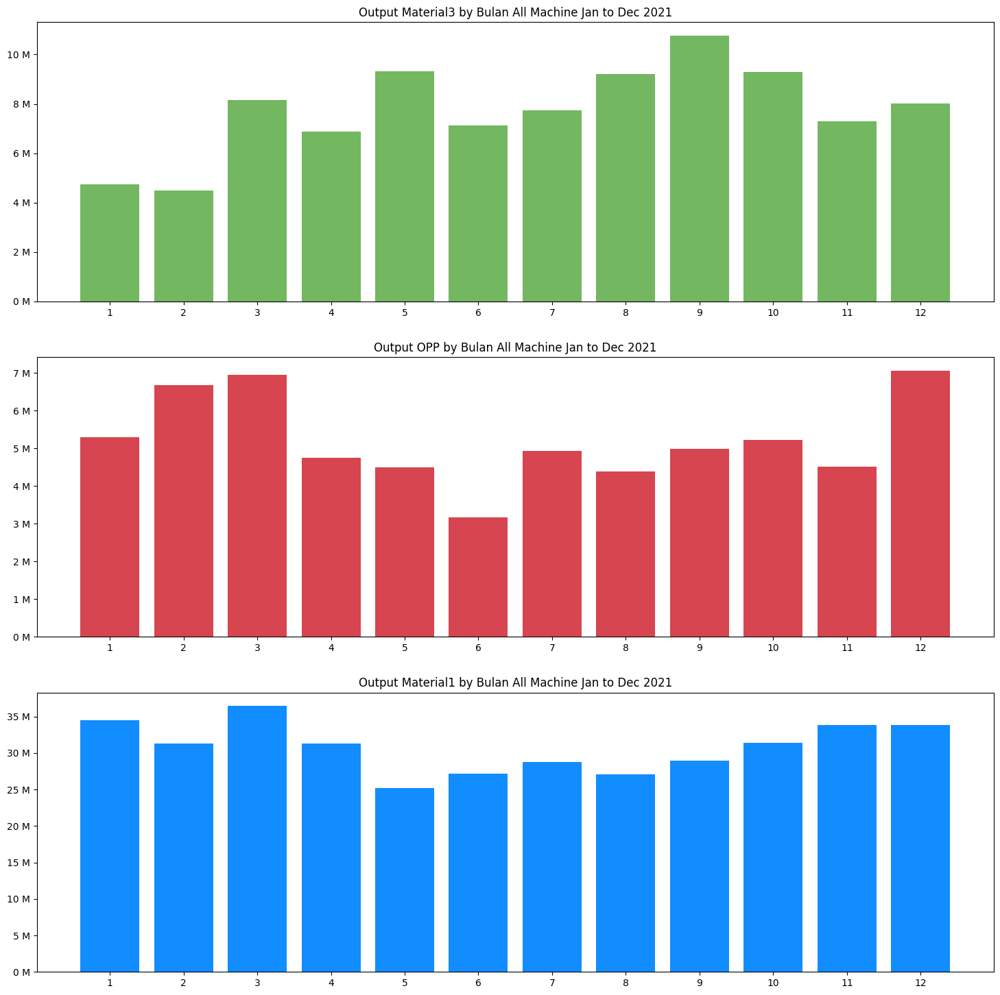

In [ ]:
# plotting output Material3 per month
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(18, 18))
ax[0].bar(op_order['Bulan'], op_order['Material3'], label='Material3',color='#73b761')
ax[0].set_title('Output Material3 by Bulan All Machine Jan to Dec 2021')
ax[0].yaxis.set_major_formatter(million_formatter)
ax[0].set_xticks(op_order['Bulan'])

ax[1].bar(op_order['Bulan'], op_order['Material2'], label='Material2',color='#d64550')
ax[1].set_title('Output OPP by Bulan All Machine Jan to Dec 2021')
ax[1].yaxis.set_major_formatter(million_formatter)
ax[1].set_xticks(op_order['Bulan'])

ax[2].bar(op_order['Bulan'], op_order['Material1'], label='Material1',color='#118dff')
ax[2].set_title('Output Material1 by Bulan All Machine Jan to Dec 2021')
ax[2].yaxis.set_major_formatter(million_formatter)
ax[2].set_xticks(op_order['Bulan'])

plt.show()

## **4. Monthly Output by Material All Machine**

### **January**

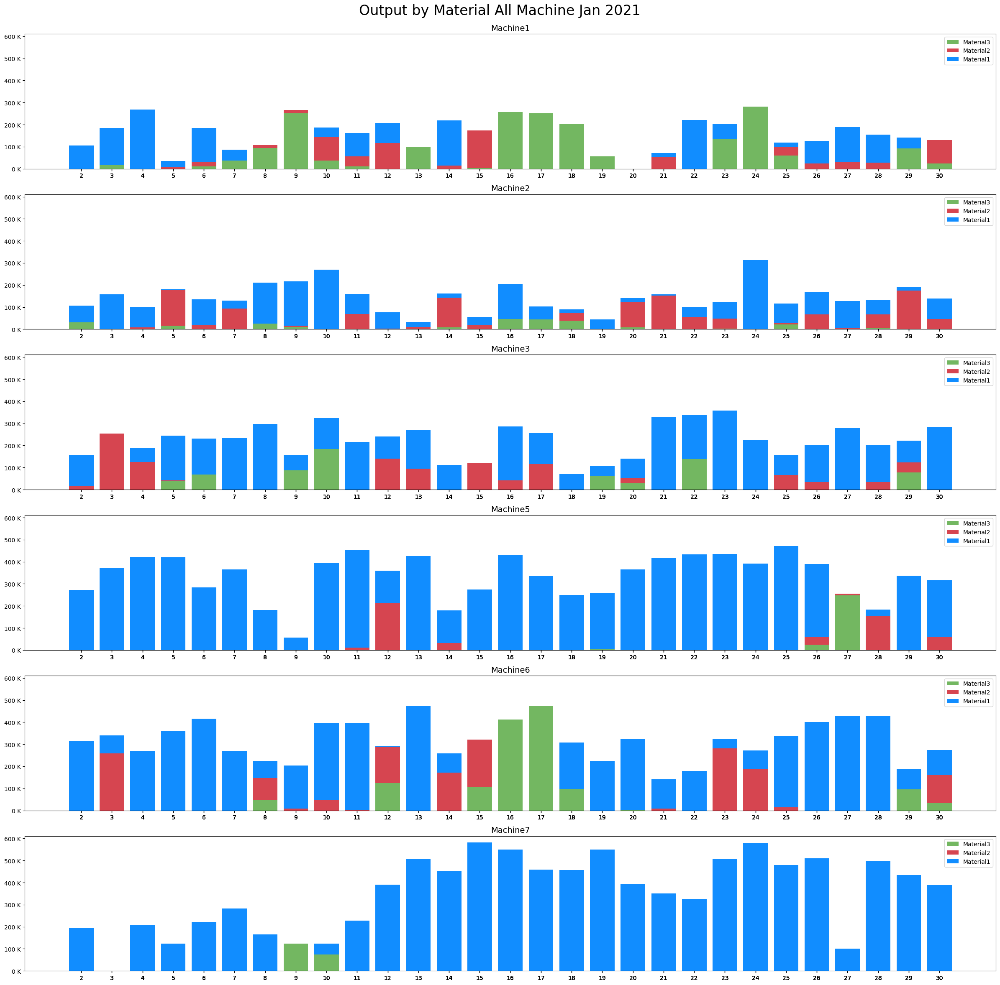

In [ ]:
# function for y-axis format in thousands
@ticker.FuncFormatter
def thousand_formatter(x, pos):
    return "%.0f K" % (x/1E3)

op_month = op[op['Bulan']==1].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Jan 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **February**

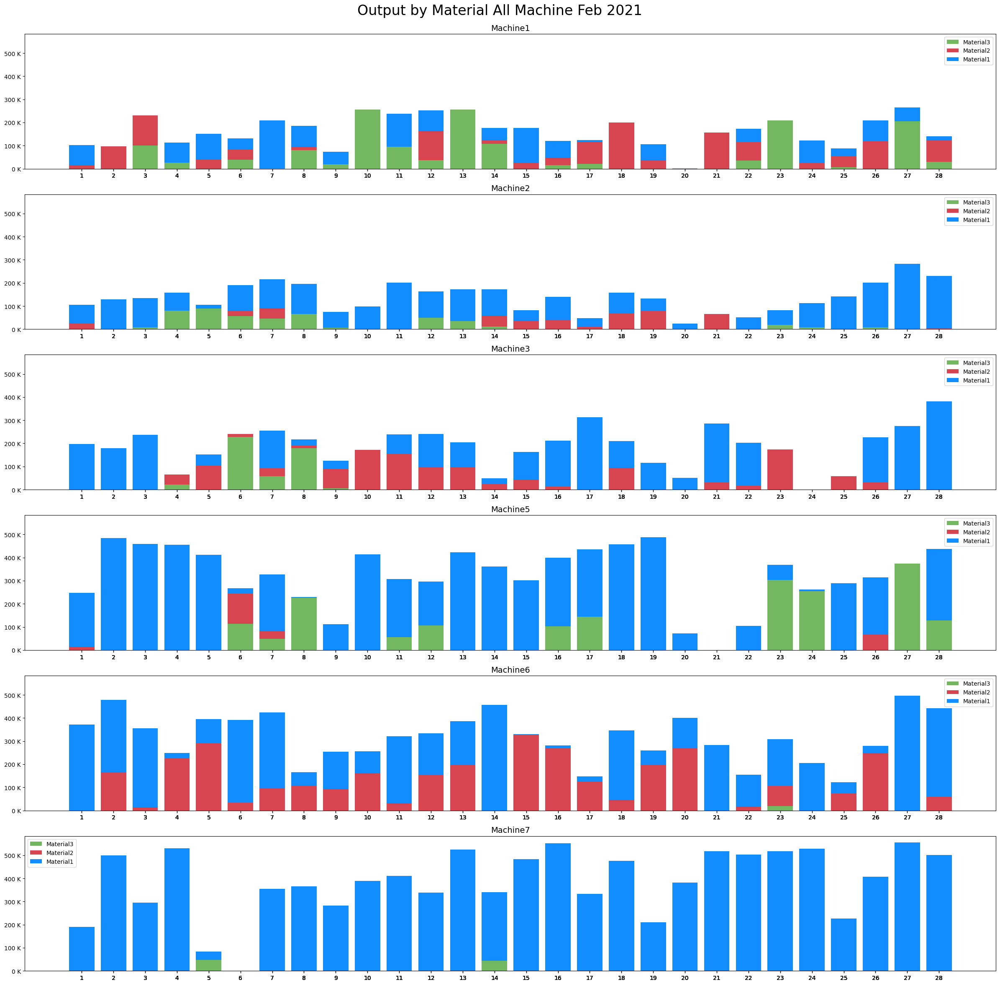

In [ ]:
op_month = op[op['Bulan']==2].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Feb 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **March**

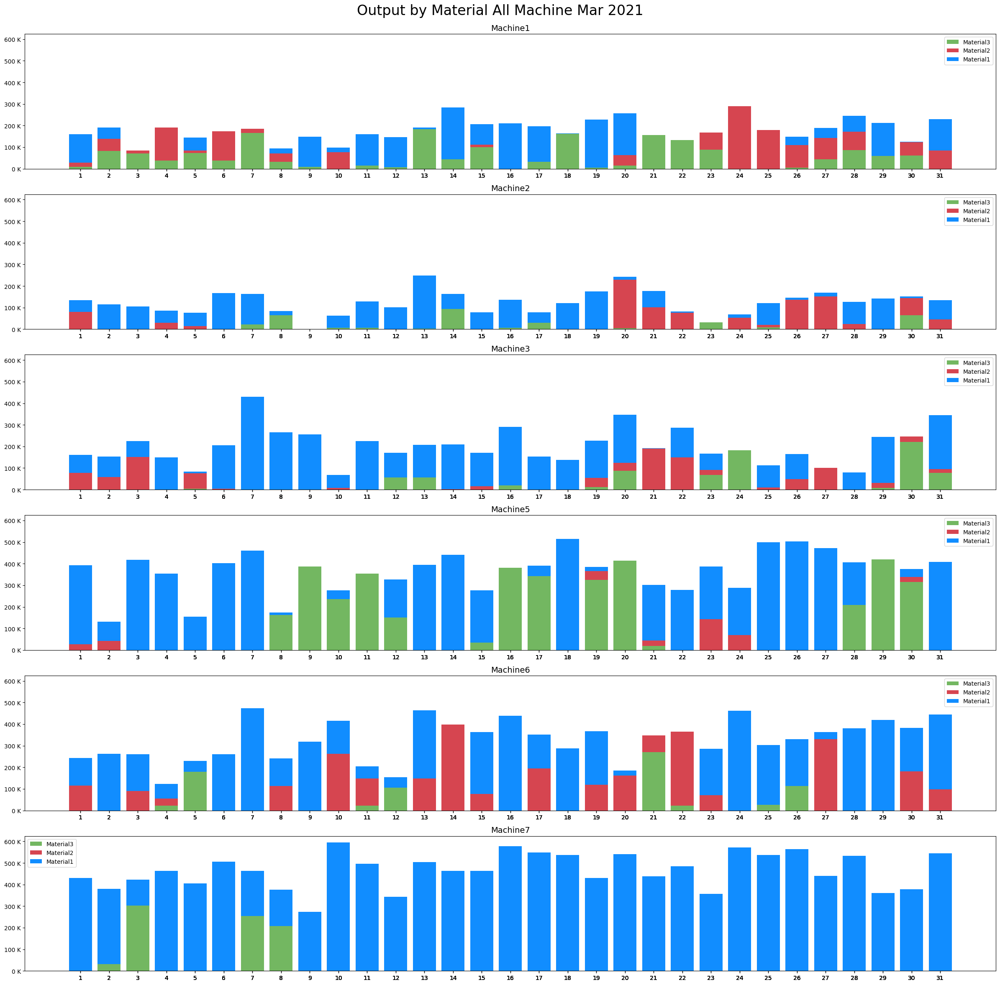

In [ ]:
op_month = op[op['Bulan']==3].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Mar 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **April**

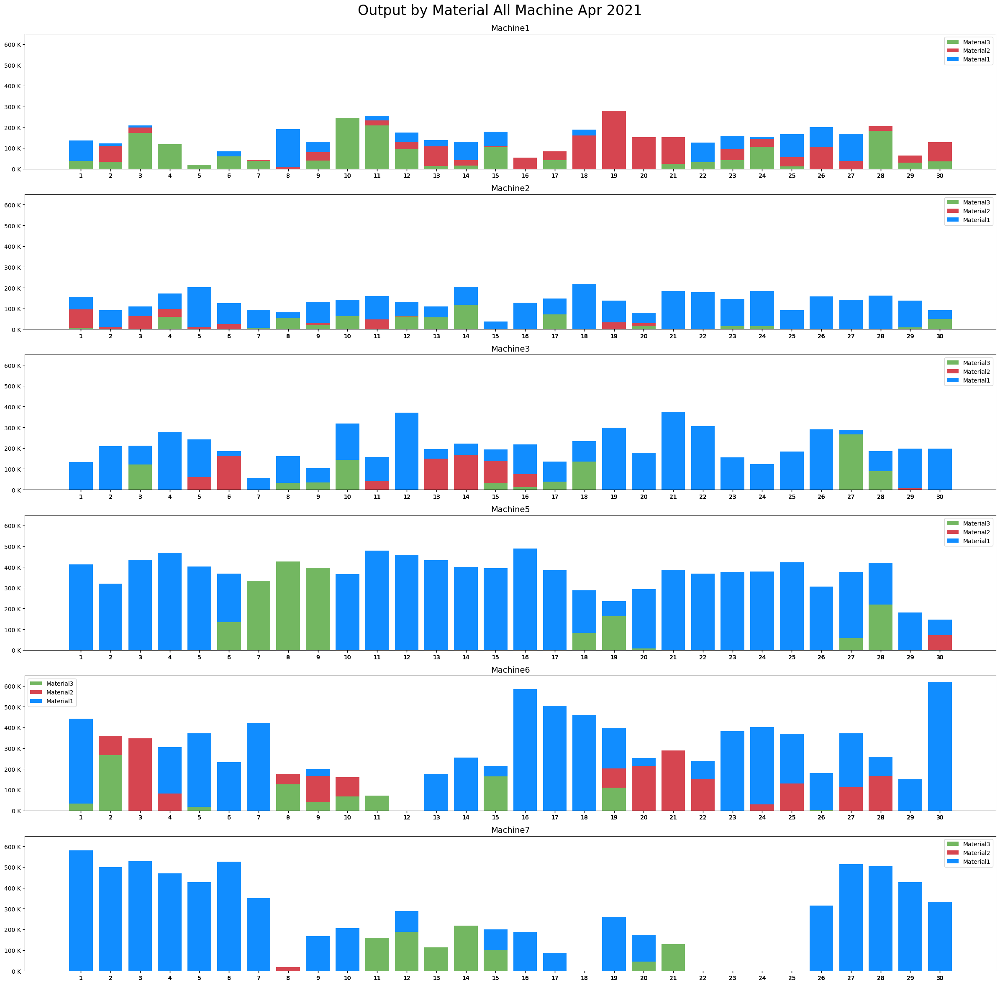

In [ ]:
op_month = op[op['Bulan']==4].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Apr 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **May**

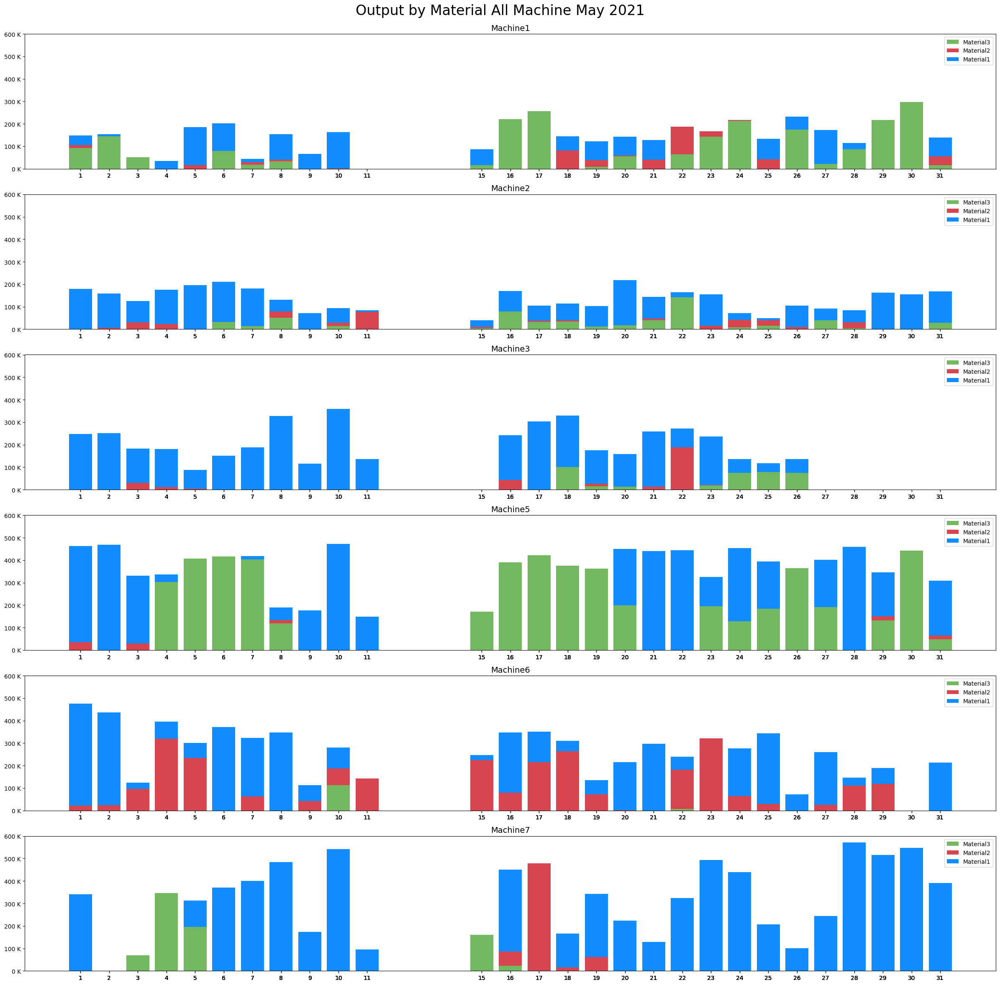

In [ ]:
op_month = op[op['Bulan']==5].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine May 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **June**

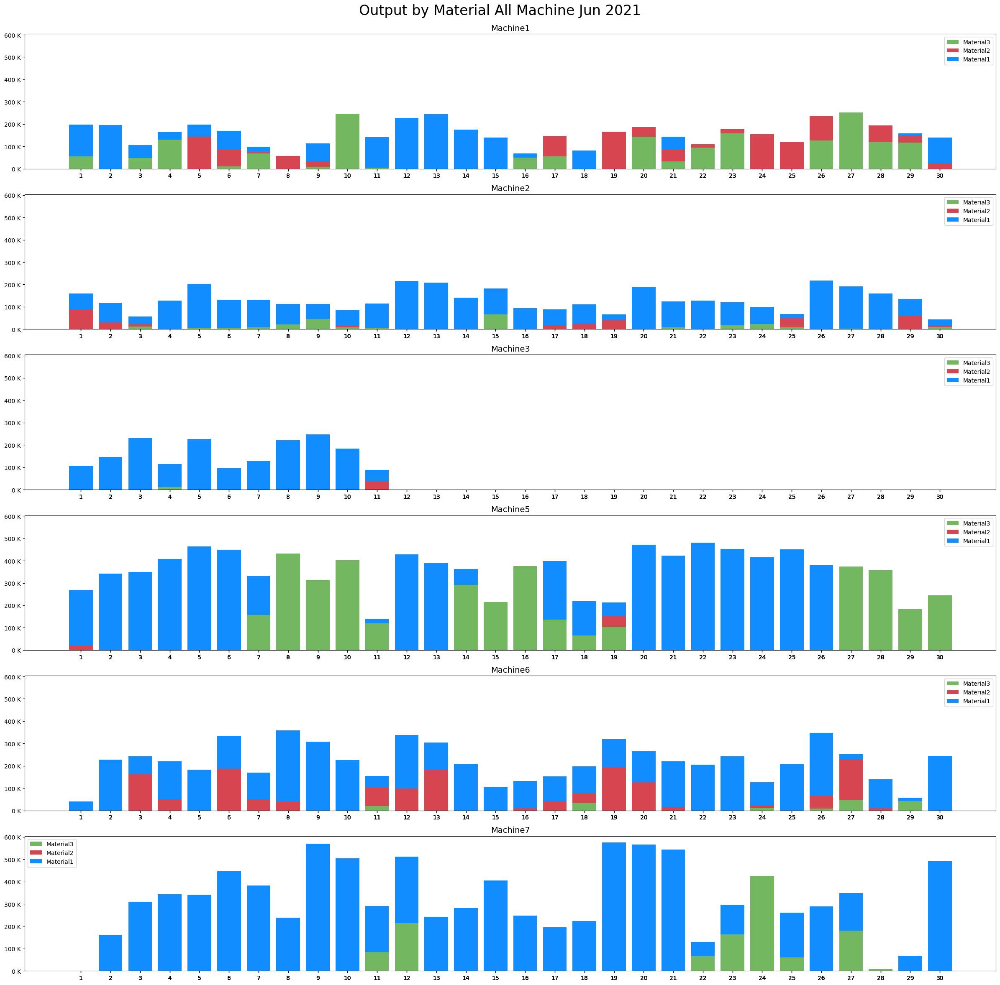

In [ ]:
op_month = op[op['Bulan']==6].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Jun 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **July**

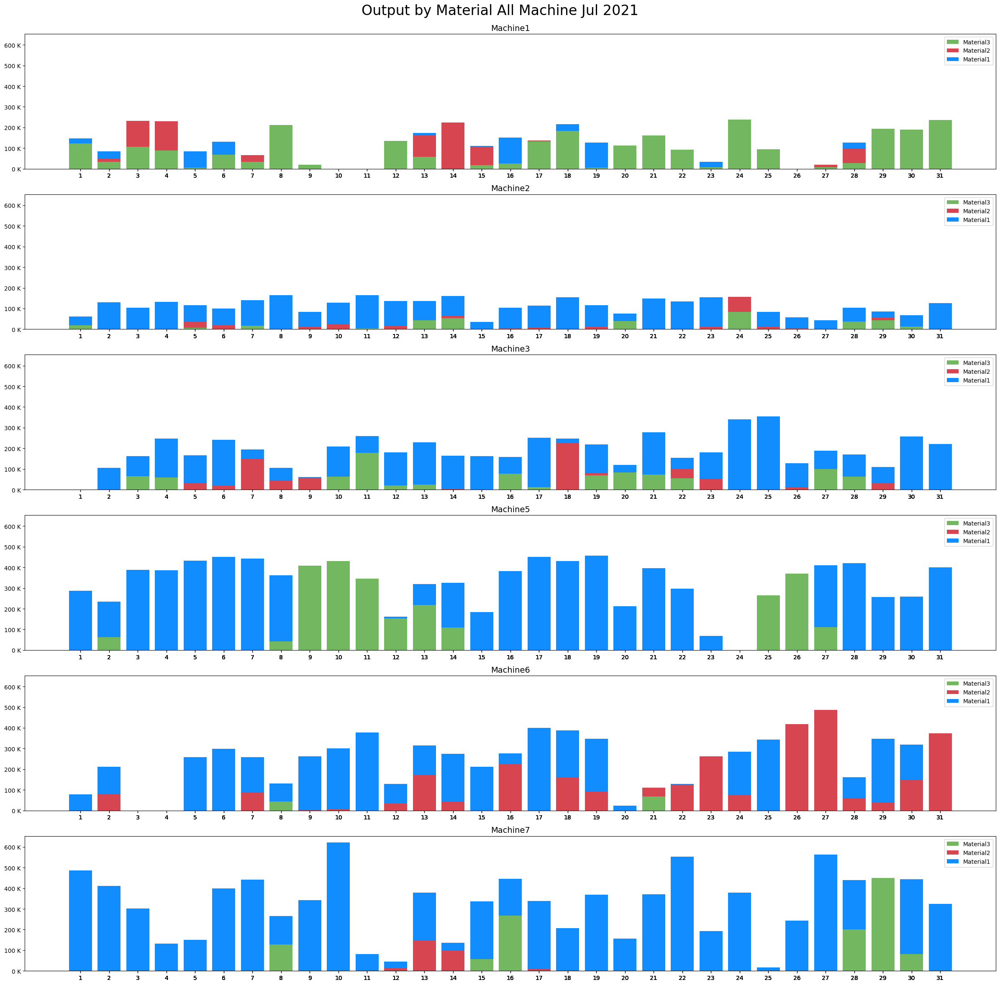

In [ ]:
op_month = op[op['Bulan']==7].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Jul 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **August**

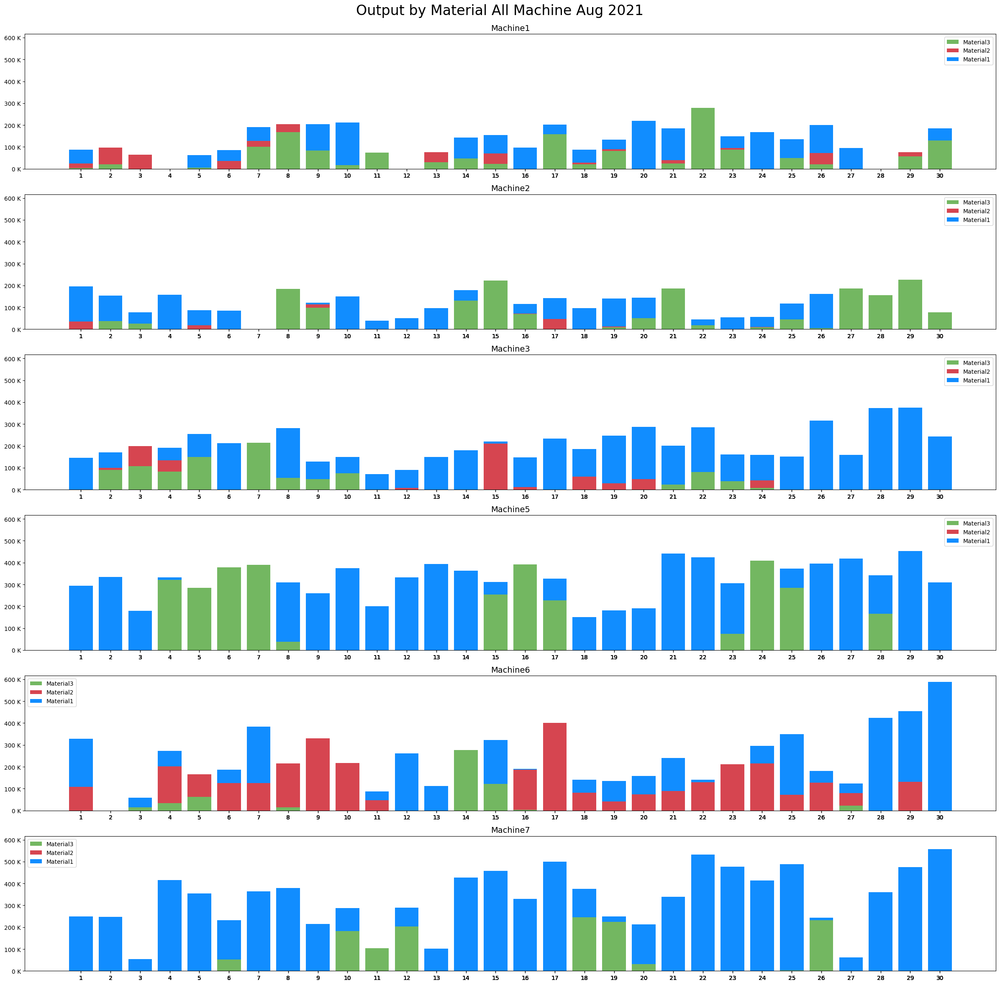

In [ ]:
op_month = op[op['Bulan']==8].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Aug 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **September**

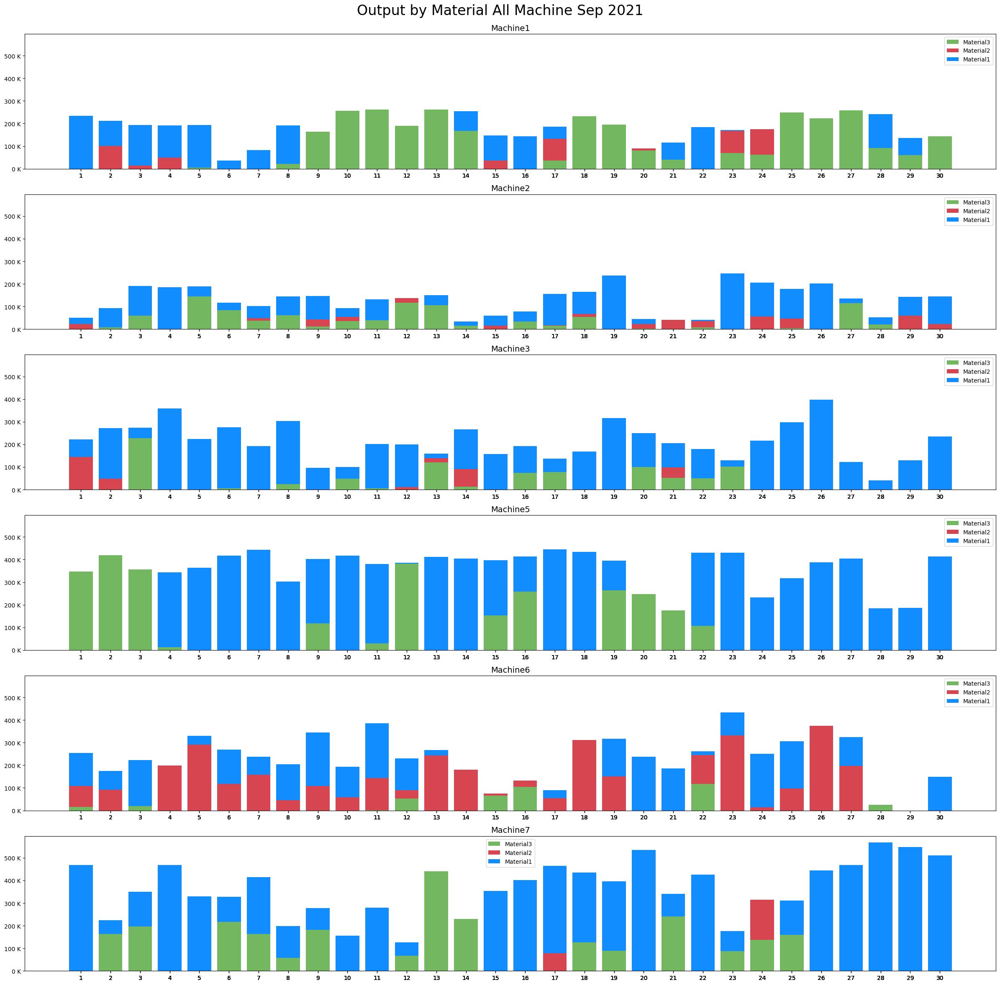

In [ ]:
op_month = op[op['Bulan']==9].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Sep 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **October**

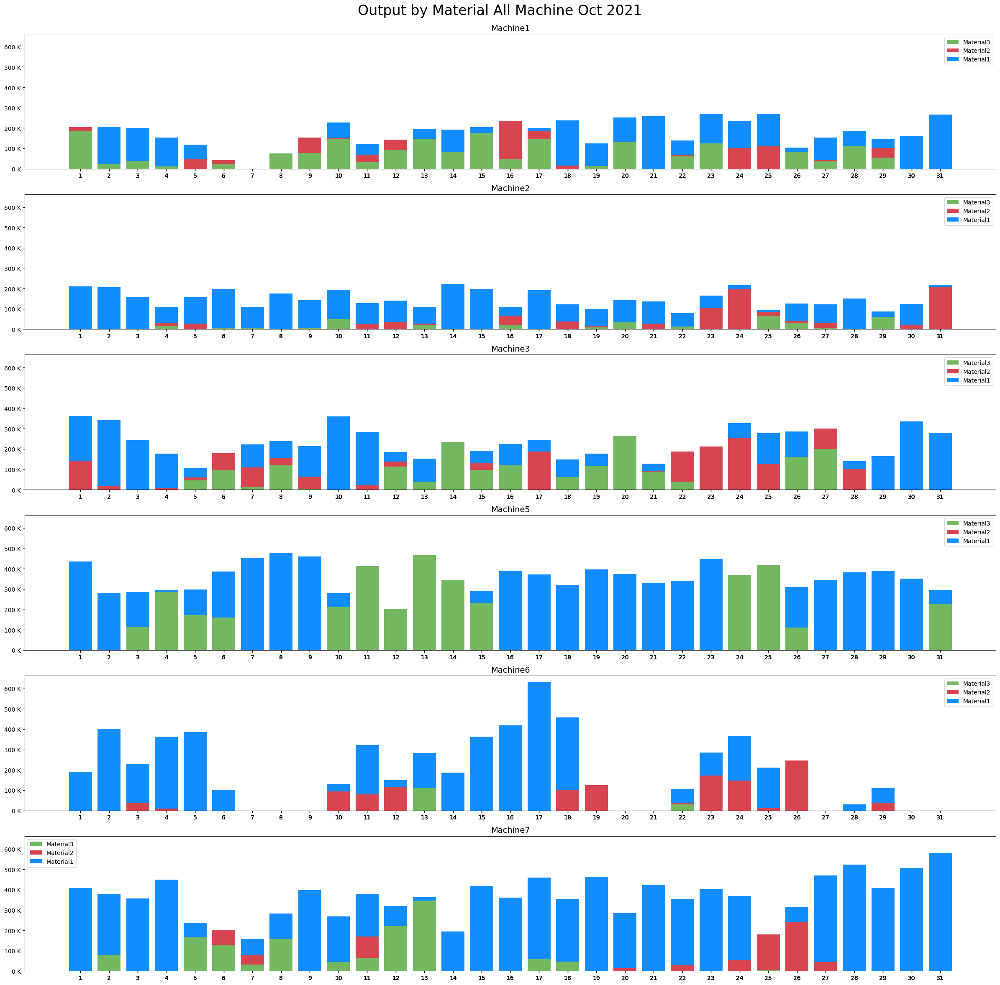

In [ ]:
op_month = op[op['Bulan']==10].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Oct 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **November**

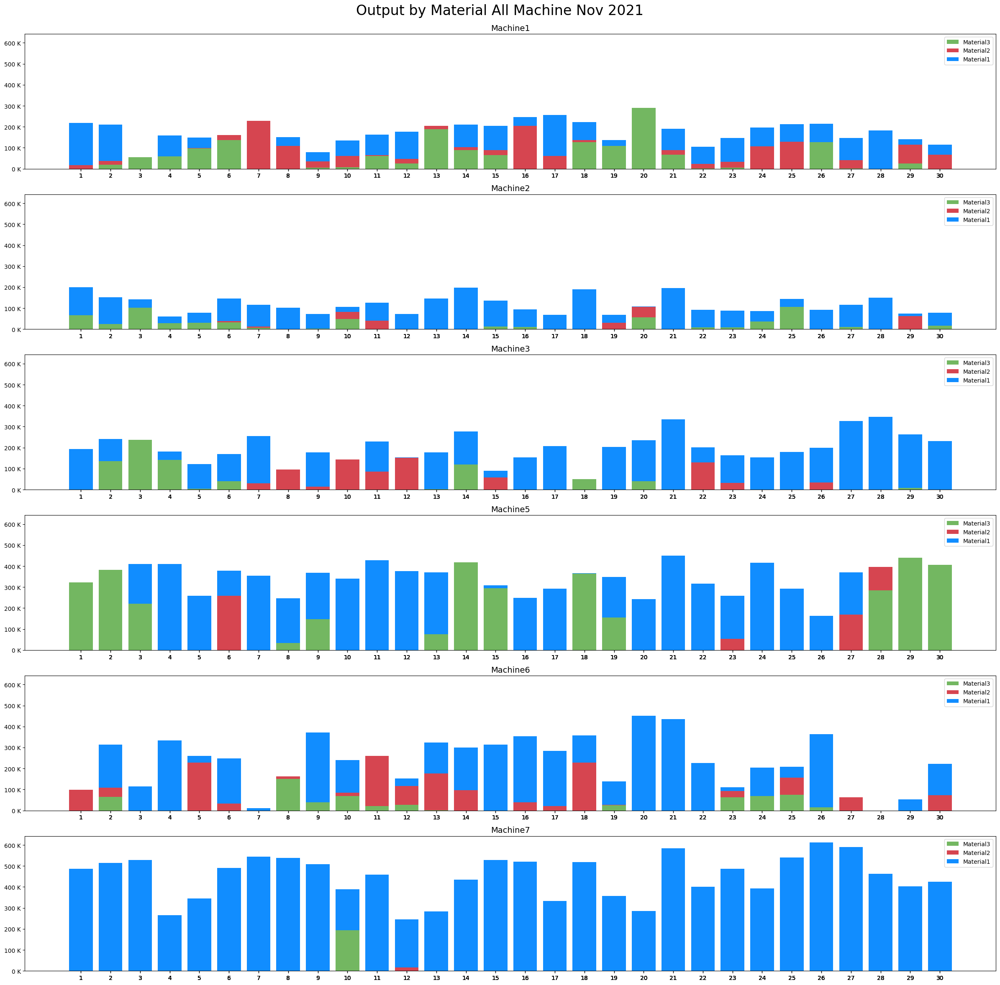

In [ ]:
op_month = op[op['Bulan']==11].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Nov 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

### **December**

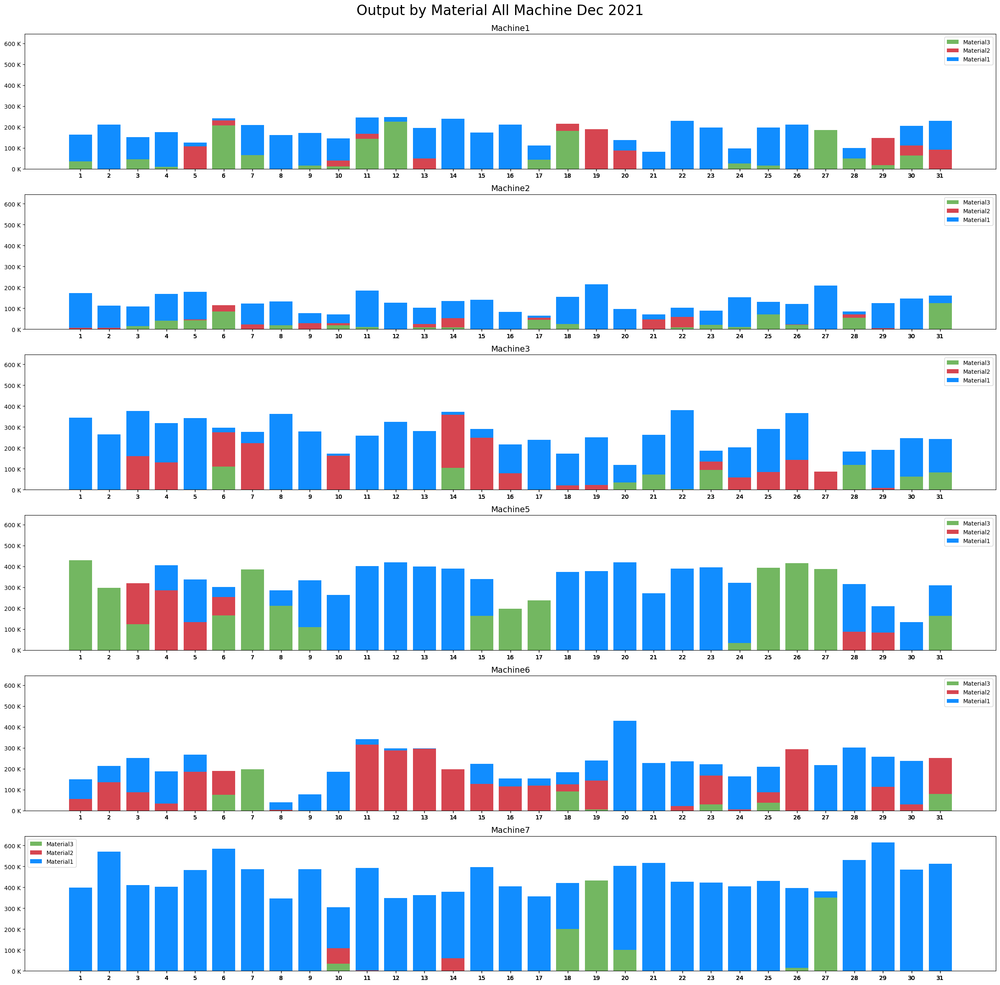

In [ ]:
op_month = op[op['Bulan']==12].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material1'], 
          bottom=op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material3']+np.array(op_month[op_month['KdMesin']=='Machine'+str(list[i])]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('Machine'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)

## **5. Monthly Output by Material per Machine**

### **Machine1**

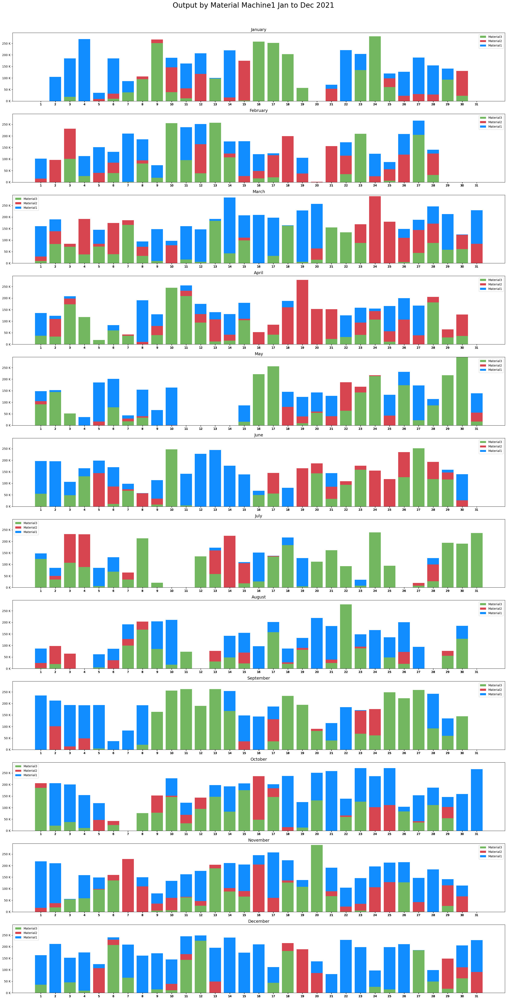

In [ ]:
op_pr= op[op['KdMesin']=='Machine1'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine1 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **Machine2**

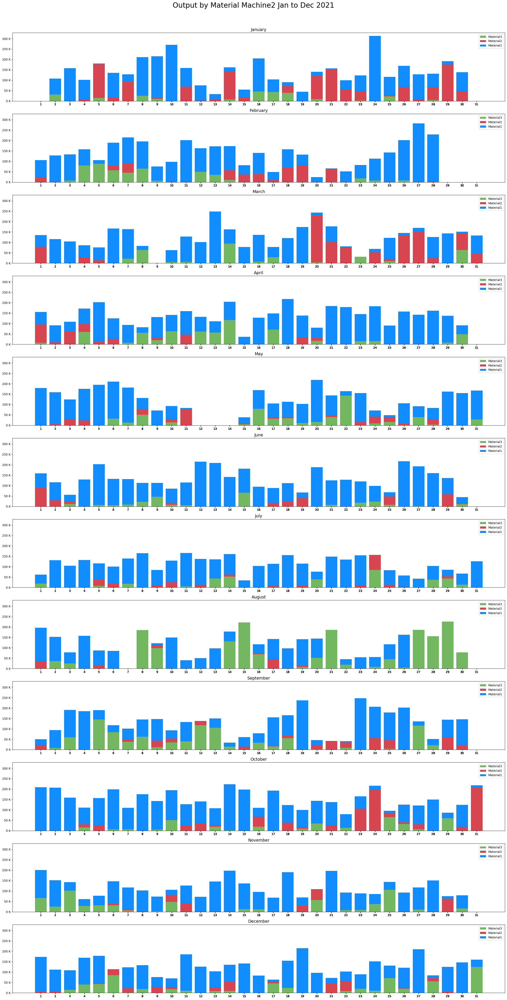

In [ ]:
op_pr= op[op['KdMesin']=='Machine2'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine2 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **Machine3**

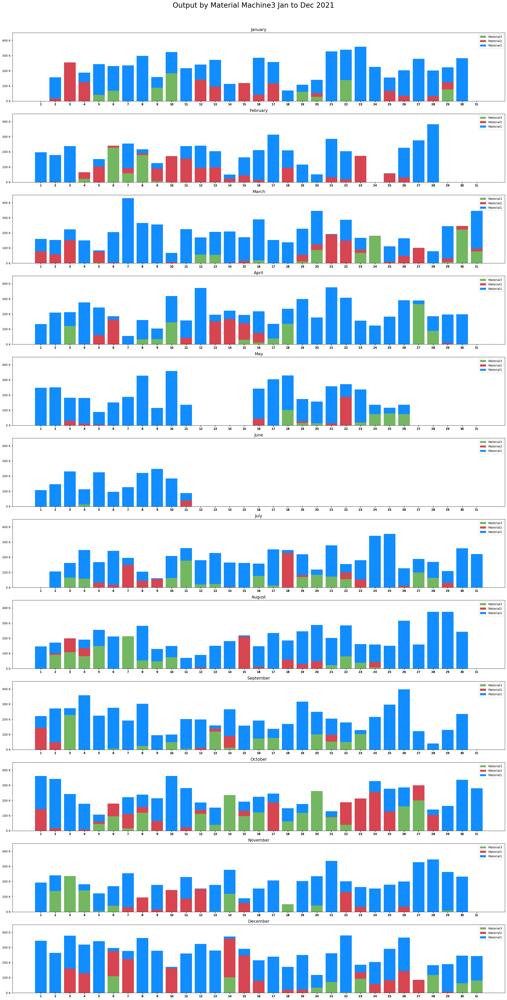

In [ ]:
op_pr= op[op['KdMesin']=='Machine3'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine3 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **Machine5**

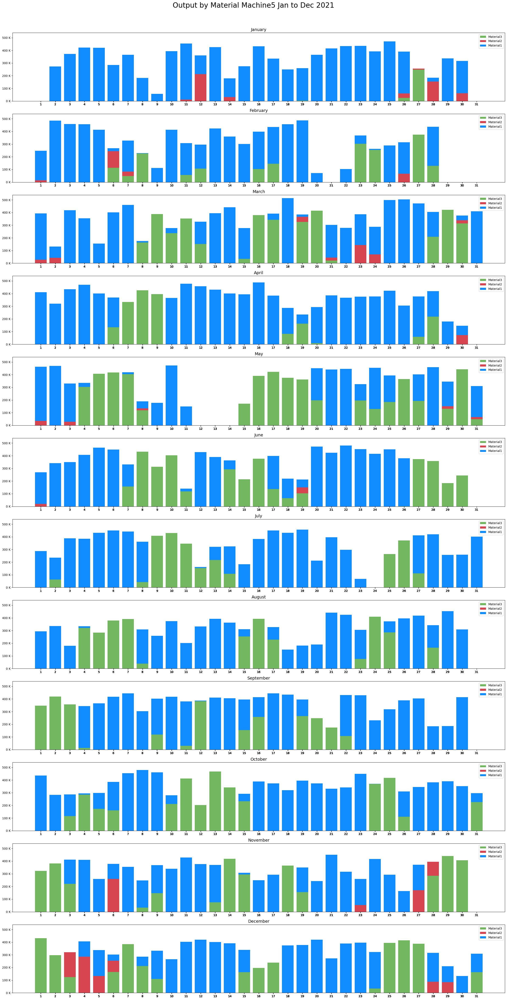

In [ ]:
op_pr= op[op['KdMesin']=='Machine5'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine5 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **Machine6**

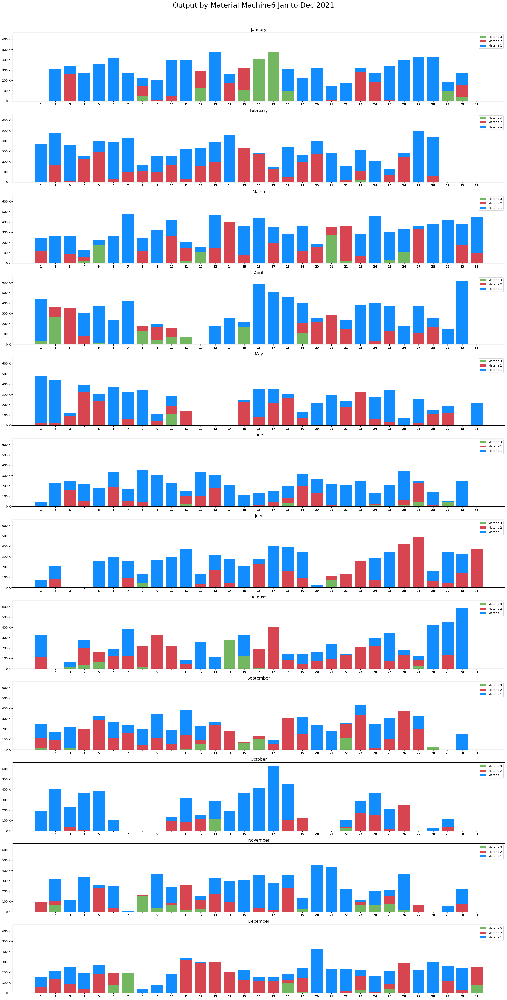

In [ ]:
op_pr= op[op['KdMesin']=='Machine6'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine6 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **Machine7**

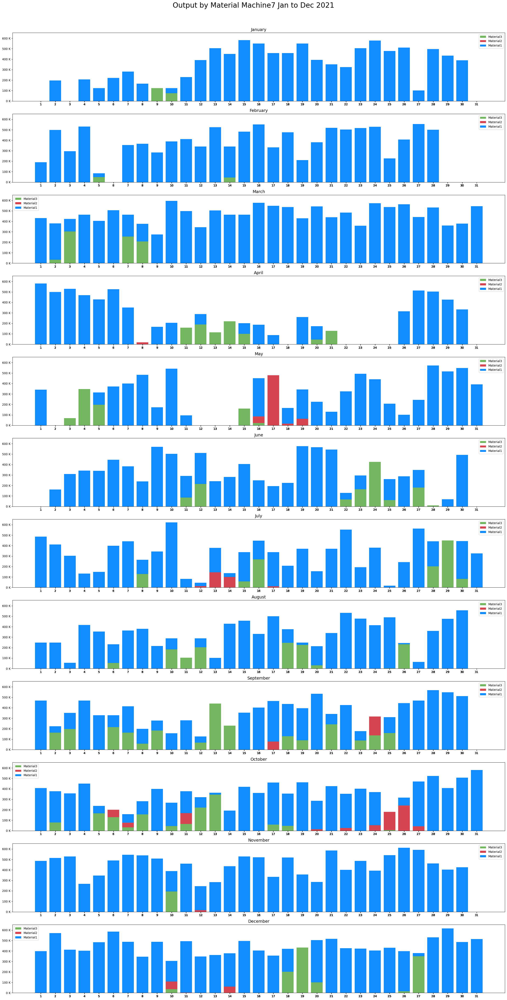

In [ ]:
op_pr= op[op['KdMesin']=='Machine7'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material3'], label='Material3',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material2'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3'],label='Material2',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['Material1'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['Material3']+np.array(op_pr[op_pr['Bulan']==i+1]['Material2']),label='Material1',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material Machine7 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

## **6. Downtime by Material**

In [ ]:
# downtime data by material per machine
down_Material1= down[down['FILM']=='Material1'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()
down_Material2= down[down['FILM']=='Material2'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()
down_Material3= down[down['FILM']=='Material3'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()

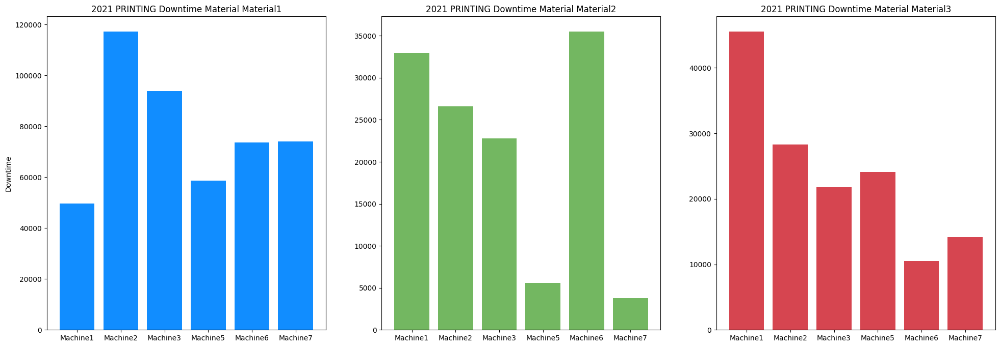

In [ ]:
# plotting Downtime by material per machine
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))

# plot material Material1
plt.sca(axarr[0]);
plt.bar(down_Material1['KdMesin'],down_Material1['Downtime'], color='#118dff')
plt.ylabel('Downtime')
plt.title('2021 PRINTING Downtime Material Material1')

# plot material Material2
plt.sca(axarr[1]);
plt.bar(down_Material2['KdMesin'],down_Material2['Downtime'],color='#73b761')
plt.title('2021 PRINTING Downtime Material Material2')

# plot material Material3
plt.sca(axarr[2]);
plt.bar(down_Material3['KdMesin'],down_Material3['Downtime'],color='#d64550')
plt.title('2021 PRINTING Downtime Material Material3')

plt.show()

In [ ]:
# downtime data by material per breakdown code
down_Material1= down[down['FILM']=='Material1'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()
down_Material2= down[down['FILM']=='Material2'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()
down_Material3= down[down['FILM']=='Material3'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()

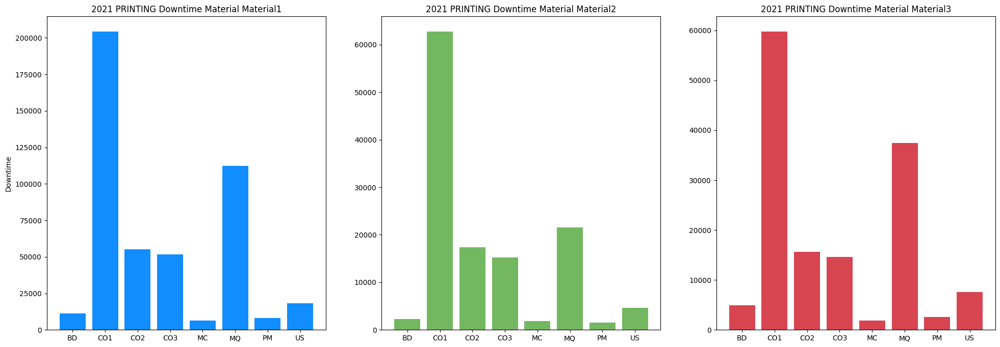

In [ ]:
# plotting Downtime by material per machine
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))

# plot material Material1
plt.sca(axarr[0]);
plt.bar(down_Material1['KodeBD'],down_Material1['Downtime'], color='#118dff')
plt.ylabel('Downtime')
plt.title('2021 PRINTING Downtime Material Material1')

# plot material Material2
plt.sca(axarr[1]);
plt.bar(down_Material2['KodeBD'],down_Material2['Downtime'],color='#73b761')
plt.title('2021 PRINTING Downtime Material Material2')

# plot material Material3
plt.sca(axarr[2]);
plt.bar(down_Material3['KodeBD'],down_Material3['Downtime'],color='#d64550')
plt.title('2021 PRINTING Downtime Material Material3')

plt.show()

### **Line Plot**

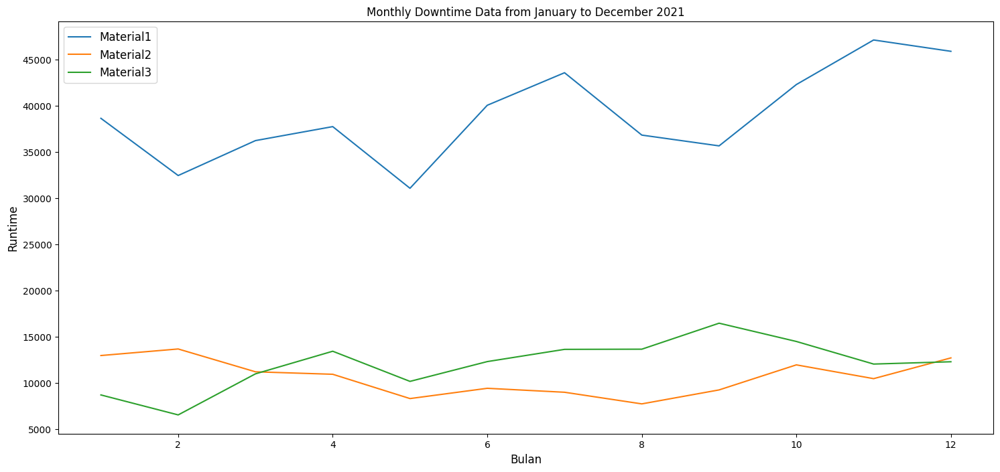

In [ ]:
# plotting daily runtime per material
down_monthly.plot('Bulan',['Material1','Material2','Material3'],figsize=(18 , 8)).legend(loc='best', fontsize=12)
plt.xlabel('Bulan', fontsize=12)
plt.ylabel('Runtime', fontsize=12)
plt.title('Monthly Downtime Data from January to December 2021', fontsize=12)
plt.show()

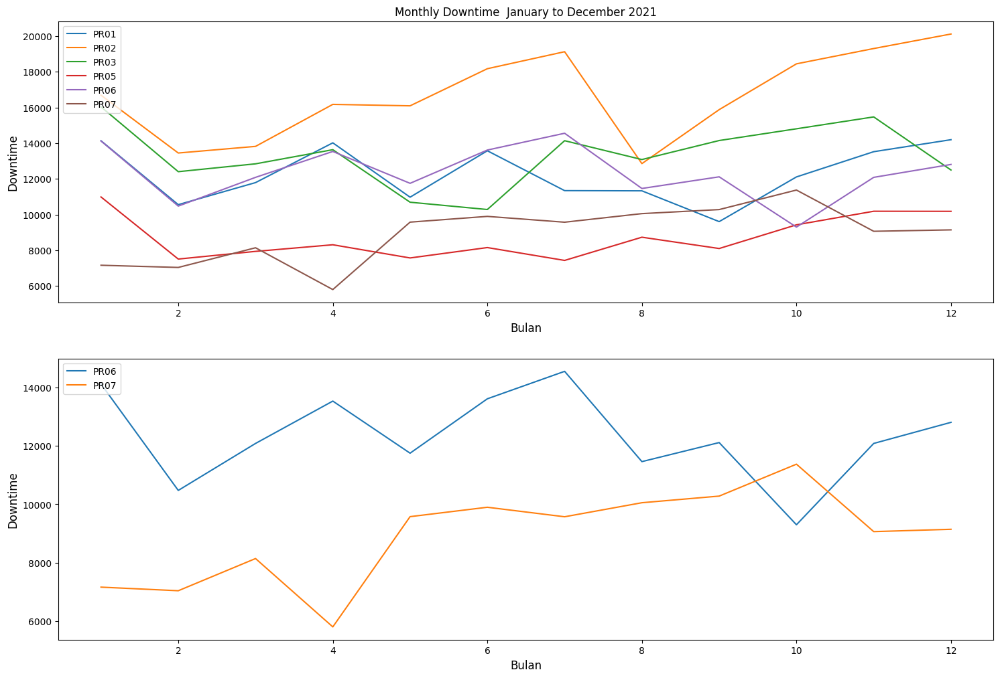

In [ ]:
# plotting daily Downtime by machine
f, ax = plt.subplots(nrows=2,ncols=1,figsize=(18, 12))
line1, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR01'],label='PR01')
line2, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR02'],label='PR02')
line3, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR03'],label='PR03')
line5, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR05'],label='PR05')
line6, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR06'],label='PR06')
line7, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR07'],label='PR07')
ax[0].legend(loc='upper left')
ax[0].set_xlabel('Bulan', fontsize=12)
ax[0].set_ylabel('Downtime', fontsize=12)
ax[0].set_title('Monthly Downtime  January to December 2021', fontsize=12)

line1, = ax[1].plot(dmc_monthly['Bulan'],dmc_monthly['PR06'],label='PR06')
line2, = ax[1].plot(dmc_monthly['Bulan'],dmc_monthly['PR07'],label='PR07')
ax[1].legend(loc= 'upper left')
ax[1].set_xlabel('Bulan', fontsize=12)
ax[1].set_ylabel('Downtime', fontsize=12)
plt.show()

# **Forecasting using model to get new insights after doing data mining with machine learning or deep learning methods**
Forecasting is a technique that uses historical data as inputs to make informed estimates that are predictive in determining the direction of future trends. In future planning, forecasts will become the basis for every company. if a company can predict what will happen in the future then they can change their current habits and take a position that will be much more developed in the future.

## **Forecasting Daily Runtime Data with N-Beats**


In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
run_all = df[df['KodeBD']=='RUN'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
run_all = run_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series
run_series = TimeSeries.from_dataframe(run_all, 'index','RunTime')

### **Forecasting Daily Runtime by Material With N-Beats**

In [ ]:
Material1 = run[run['FILM']=='Material1'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = run[run['FILM']=='Material2'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = run[run['FILM']=='Material3'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','RunTime')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','RunTime')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','RunTime')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 7.0
Material2_periodicity (~months) : 0.2


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 7.0
Material3_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
Material1.iloc[-73:].to_csv('/content/run_Material1.csv')
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
Material2.iloc[-73:].to_csv('/content/run_Material2.csv')
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]
Material3.iloc[-73:].to_csv('/content/run_Material3.csv')

In [ ]:
# defining and training the model for Material1
nbeats_Material1= NBEATSModel(
    input_chunk_length=Material1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material1.fit(train_Material1)

[2022-06-22 04:25:42,429] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:25:42,429] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:25:42,663] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 04:25:42,663] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
nbeats_Material2= NBEATSModel(
    input_chunk_length=Material2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material2.fit(train_Material2)

[2022-06-22 04:40:28,493] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:40:28,493] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:40:28,584] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 04:40:28,584] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
nbeats_Material3= NBEATSModel(
    input_chunk_length=Material3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material3.fit(train_Material3)

[2022-06-22 04:49:25,009] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:49:25,009] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 04:49:25,123] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 04:49:25,123] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.187
MAE = 0.149
MSE = 0.035
SMAPE = 28.157
OPE = 6.571%


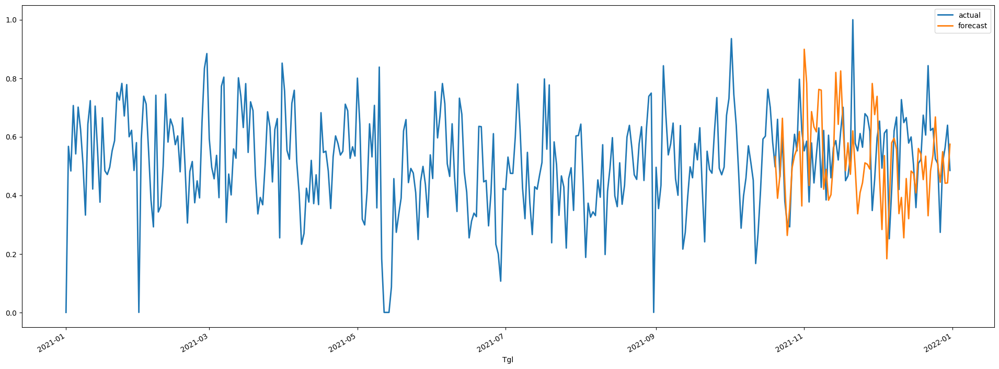

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = nbeats_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

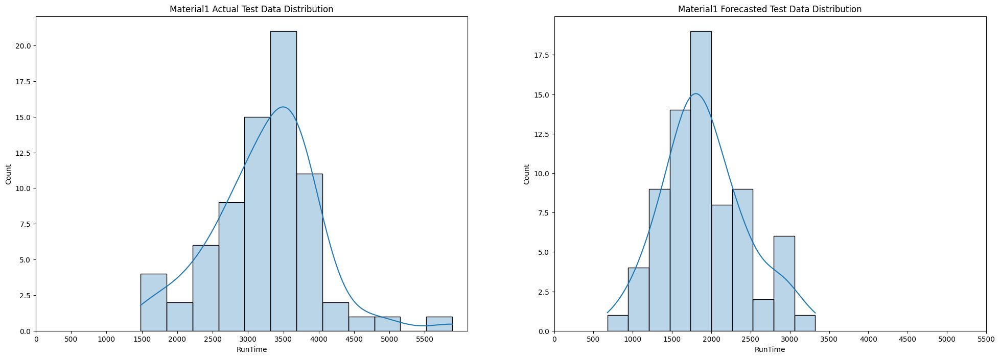

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_run_Material1_nbeats.csv')
f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_Material1['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.242
MAE = 0.182
MSE = 0.059
SMAPE = 81.73
OPE = 21.678%


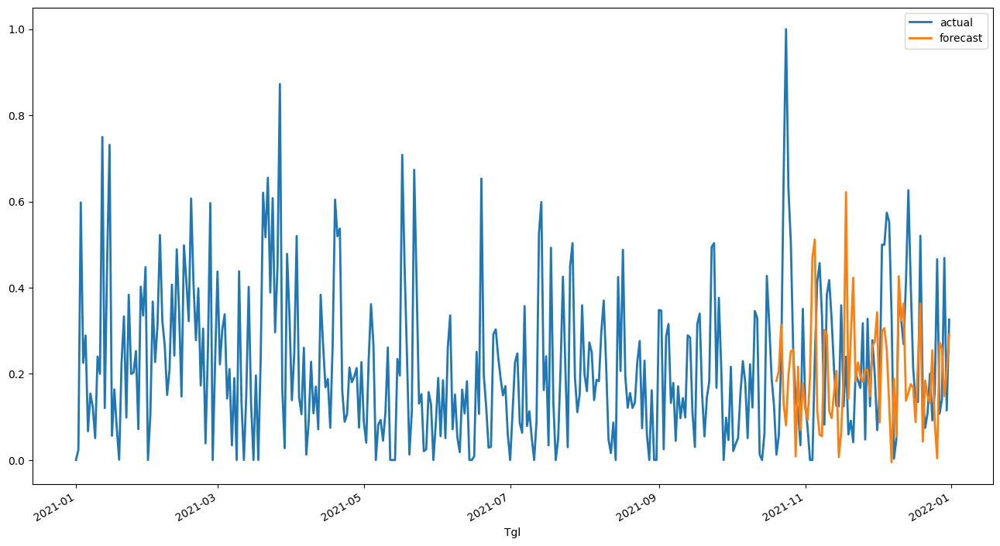

In [ ]:
# prediction for Material2
pred = nbeats_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material2_nbeats.csv')
# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

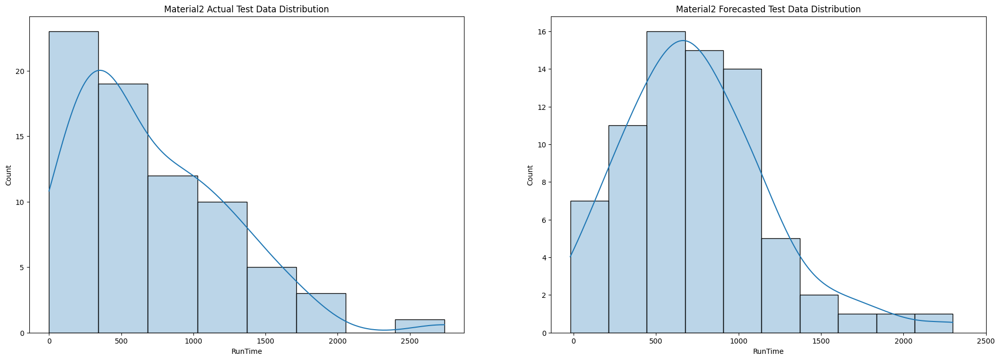

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_run_Material2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material2['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.233
MAE = 0.188
MSE = 0.054
SMAPE = 84.55
OPE = 15.348%


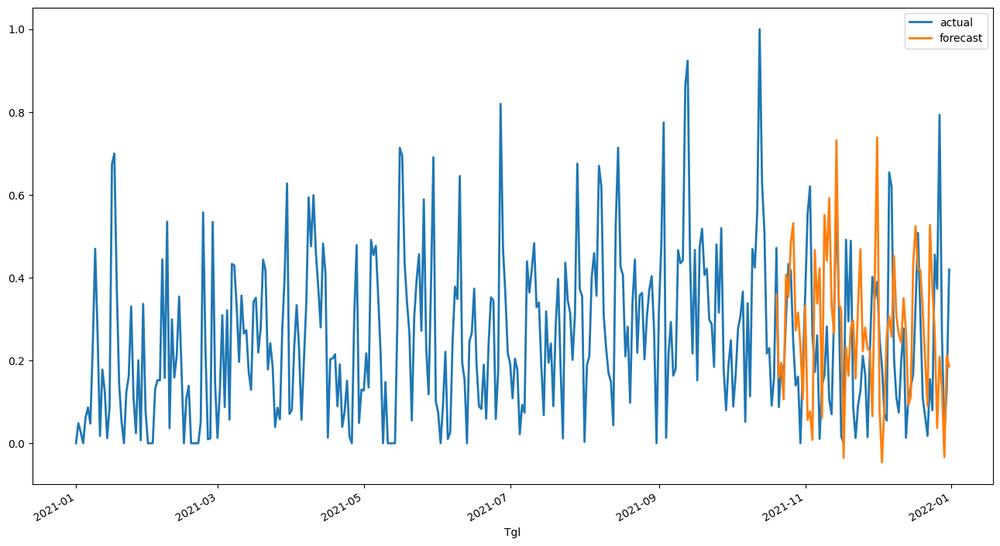

In [ ]:
# prediction for Material3
pred = nbeats_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material3_nbeats.csv')
# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

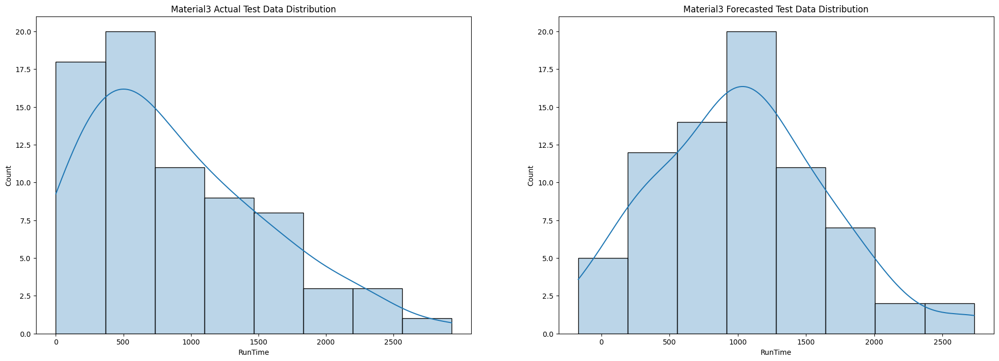

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_run_Material3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material3['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With N-Beats**

In [ ]:
Machine1 = run[run['KdMesin']=='Machine1'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = run[run['KdMesin']=='Machine2'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = run[run['KdMesin']=='Machine3'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = run[run['KdMesin']=='Machine5'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = run[run['KdMesin']=='Machine6'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = run[run['KdMesin']=='Machine7'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','RunTime')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','RunTime')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','RunTime')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','RunTime')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','RunTime')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','RunTime')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 7.0
Machine1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 7.0
Machine2_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 6.0
Machine3_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 3.0
Machine5_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 8.0
Machine6_periodicity (~months) : 0.3


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 6.0
Machine7_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
Machine1.iloc[-73:].to_csv('/content/run_Machine1.csv')
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
Machine2.iloc[-73:].to_csv('/content/run_Machine2.csv')
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
Machine3.iloc[-73:].to_csv('/content/run_Machine3.csv')
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
Machine5.iloc[-73:].to_csv('/content/run_Machine5.csv')
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
Machine6.iloc[-73:].to_csv('/content/run_Machine6.csv')
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]
Machine7.iloc[-73:].to_csv('/content/run_Machine7.csv')

In [ ]:
# defining and training the model for Machine1
nbeats_Machine1= NBEATSModel(
    input_chunk_length=Machine1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine1.fit(train_Machine1)

[2022-06-22 05:41:12,339] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 05:41:12,339] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 05:41:12,823] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 05:41:12,823] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
nbeats_Machine2= NBEATSModel(
    input_chunk_length=Machine2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine2.fit(train_Machine2)

[2022-06-22 05:54:16,571] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 05:54:16,571] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 05:54:16,672] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 05:54:16,672] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
nbeats_Machine3= NBEATSModel(
    input_chunk_length=Machine3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine3.fit(train_Machine3)

[2022-06-22 06:03:38,849] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 06:03:38,849] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 06:03:38,949] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 06:03:38,949] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
nbeats_Machine5= NBEATSModel(
    input_chunk_length=Machine5_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine5.fit(train_Machine5)

[2022-06-22 06:13:22,479] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-06-22 06:13:22,479] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-06-22 06:13:22,572] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 06:13:22,572] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine6
nbeats_Machine6= NBEATSModel(
    input_chunk_length=Machine6_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine6.fit(train_Machine6)

[2022-06-22 06:23:10,368] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-06-22 06:23:10,368] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-06-22 06:23:10,464] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 06:23:10,464] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine7
nbeats_Machine7= NBEATSModel(
    input_chunk_length=Machine7_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine7.fit(train_Machine7)

[2022-06-22 06:32:10,412] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 06:32:10,412] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 06:32:10,499] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 06:32:10,499] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.221
MAE = 0.181
MSE = 0.049
SMAPE = 30.073
OPE = 1.841%


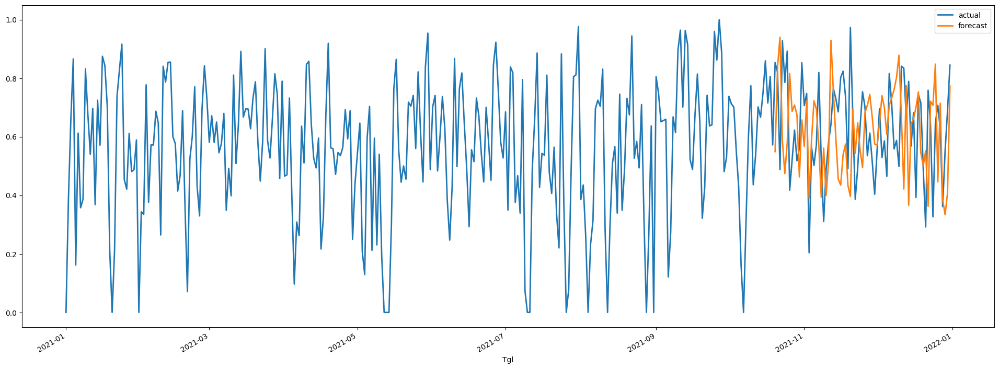

In [ ]:
# prediction for Machine1
mpl.style.use('default')
pred = nbeats_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

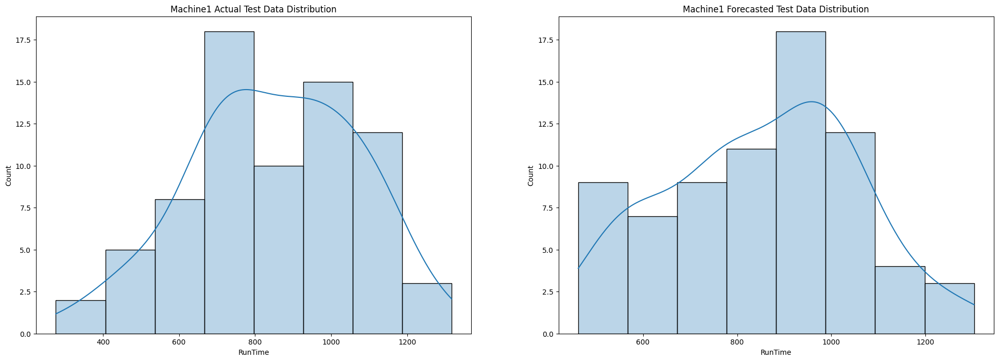

In [ ]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_run_Machine1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.204
MAE = 0.173
MSE = 0.042
SMAPE = 38.77
OPE = 1.986%


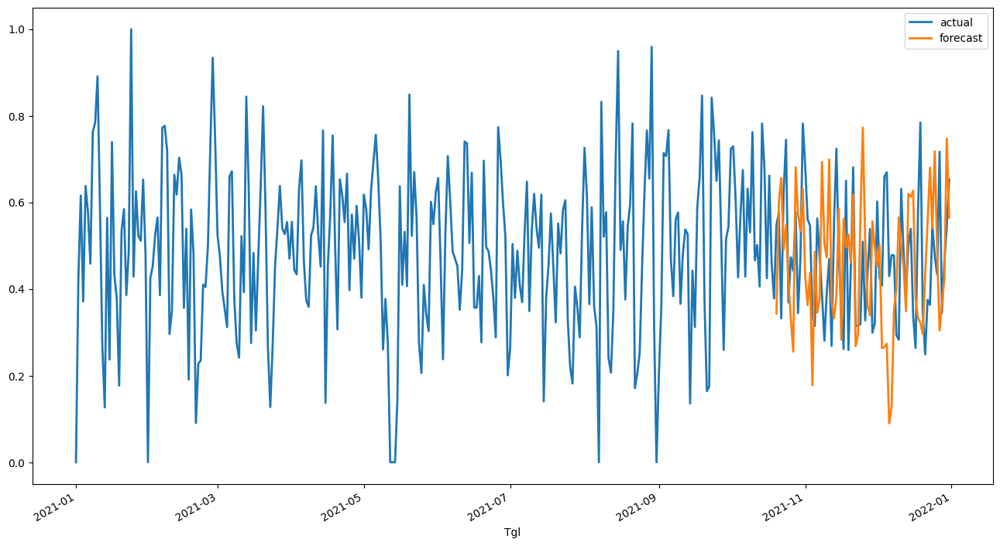

In [ ]:
# prediction for Machine2
pred = nbeats_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

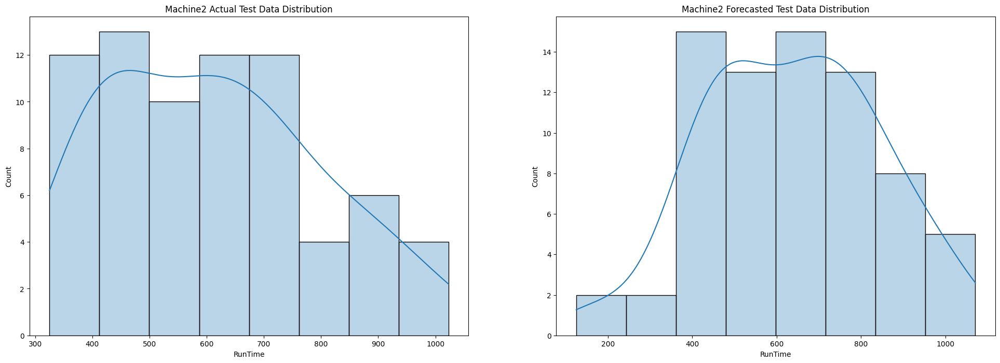

In [ ]:
# normal distribution for Machine2

pred_Machine2 = pd.read_csv('/content/pred_run_Machine2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.260
MAE = 0.205
MSE = 0.068
SMAPE = 37.32
OPE = 14.920%


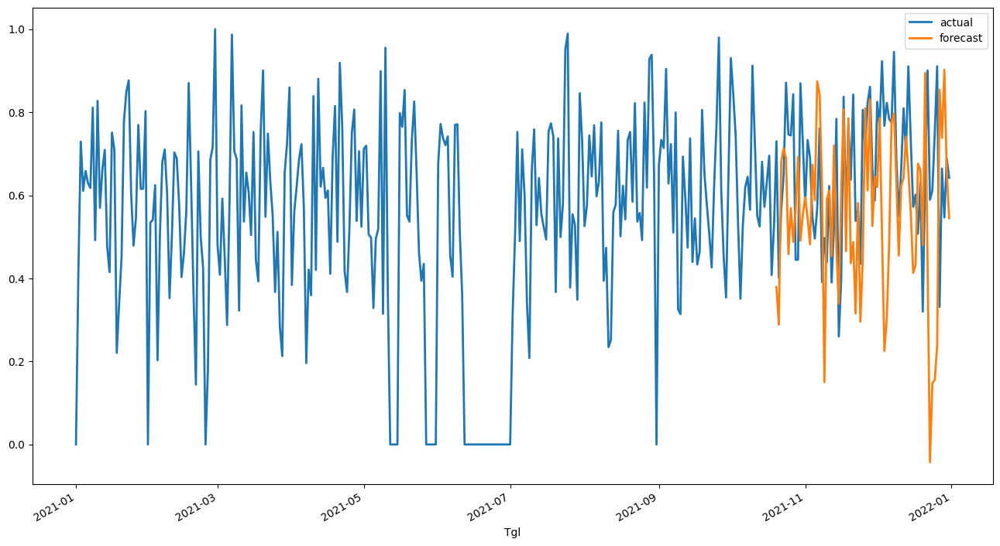

In [ ]:
# prediction for Machine3
pred = nbeats_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

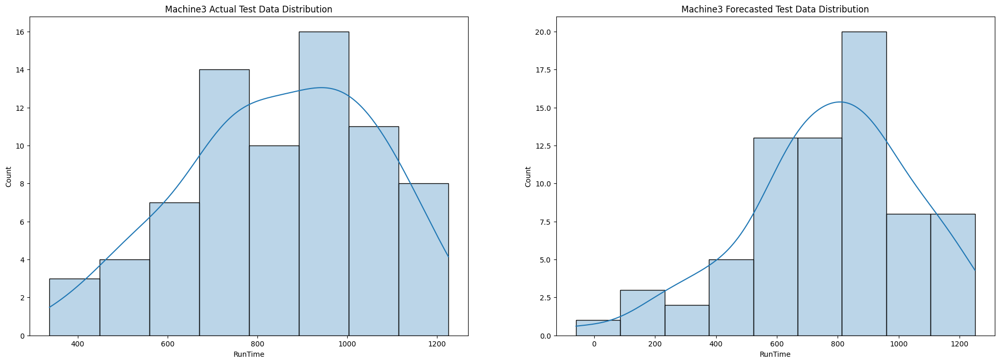

In [ ]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_run_Machine3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.155
MAE = 0.119
MSE = 0.024
SMAPE = 16.31
OPE = 0.820%


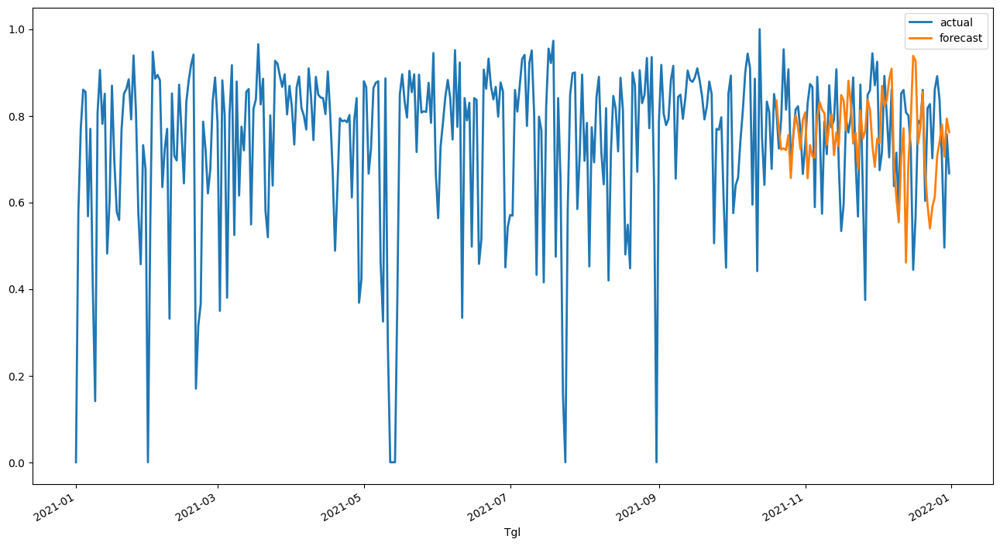

In [ ]:
# prediction for Machine5
pred = nbeats_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine5_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

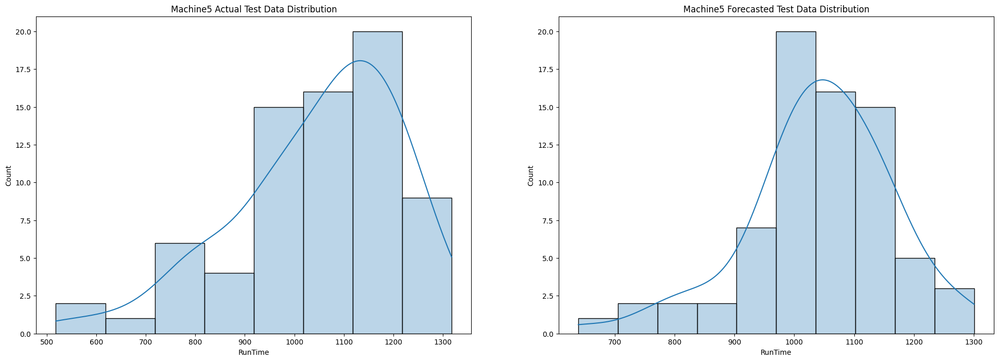

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_run_Machine5_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.308
MAE = 0.249
MSE = 0.095
SMAPE = 62.66
OPE = 34.978%


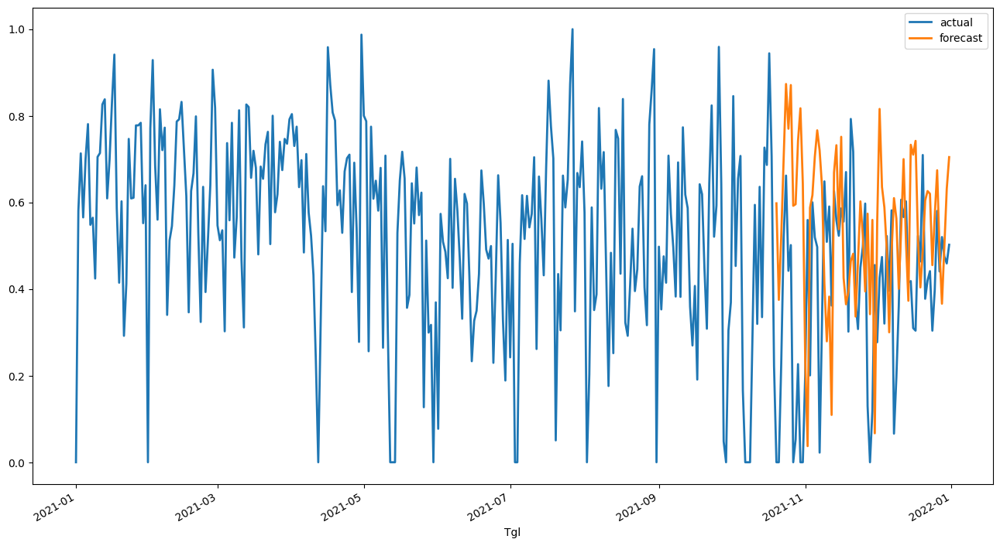

In [ ]:
# prediction for Machine6
pred = nbeats_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine6_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

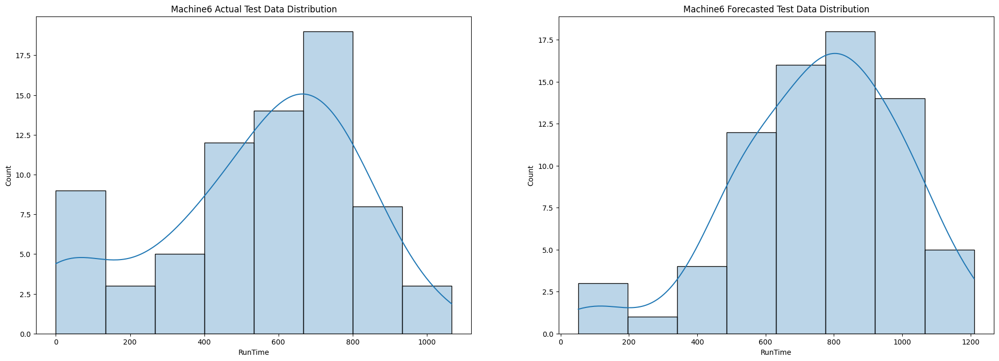

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_run_Machine6_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.253
MAE = 0.196
MSE = 0.064
SMAPE = 33.92
OPE = 21.154%


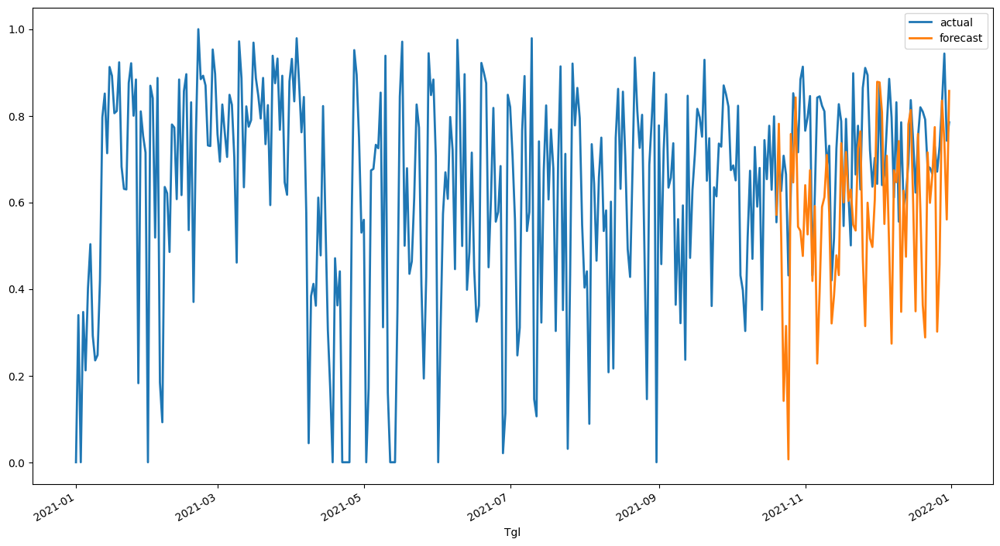

In [ ]:
# prediction for Machine7
pred = nbeats_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine7_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

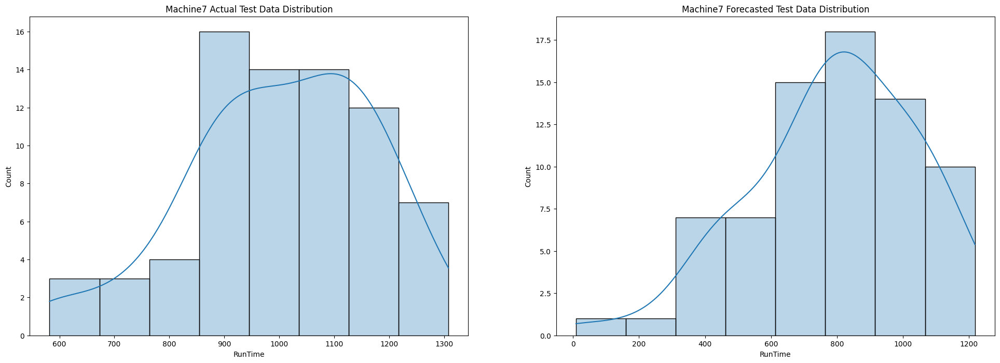

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_run_Machine7_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Speed Data with N-Beats**


### **Forecasting Daily Speed by Material with N-Beats**

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
Material1 = run[run['FILM']=='Material1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = run[run['FILM']=='Material2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = run[run['FILM']=='Material3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Speed')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Speed')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Speed')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 6.0
Material2_periodicity (~months) : 0.2


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 7.0
Material3_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
Material1.iloc[-73:].to_csv('/content/run_Material1.csv')
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
Material2.iloc[-73:].to_csv('/content/run_Material2.csv')
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]
Material3.iloc[-73:].to_csv('/content/run_Material3.csv')

In [ ]:
# defining and training the model for Material1
nbeats_Material1= NBEATSModel(
    input_chunk_length=Material1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material1.fit(train_Material1)

[2022-06-22 06:57:19,322] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 06:57:19,322] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 06:57:19,513] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 06:57:19,513] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
nbeats_Material2= NBEATSModel(
    input_chunk_length=Material2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material2.fit(train_Material2)

[2022-06-22 07:08:57,153] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 07:08:57,153] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 07:08:57,245] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 07:08:57,245] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
nbeats_Material3= NBEATSModel(
    input_chunk_length=Material3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material3.fit(train_Material3)

[2022-06-22 07:18:39,746] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 07:18:39,746] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 07:18:39,838] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 07:18:39,838] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.157
MAE = 0.117
MSE = 0.025
SMAPE = 17.509
OPE = 10.397%


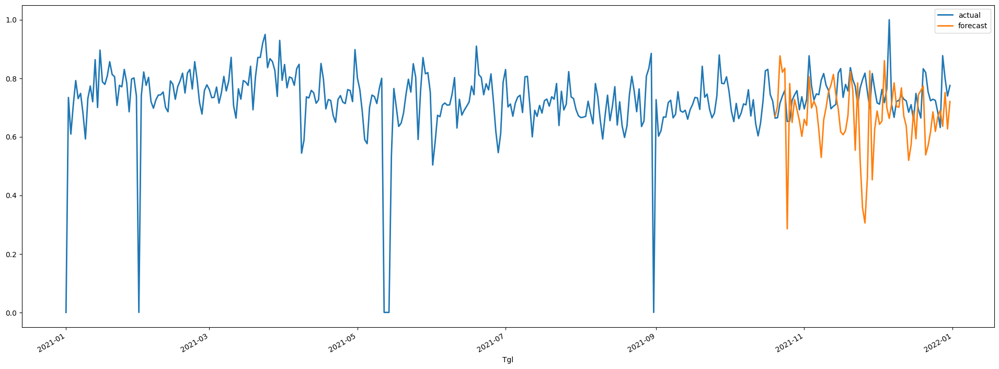

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = nbeats_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

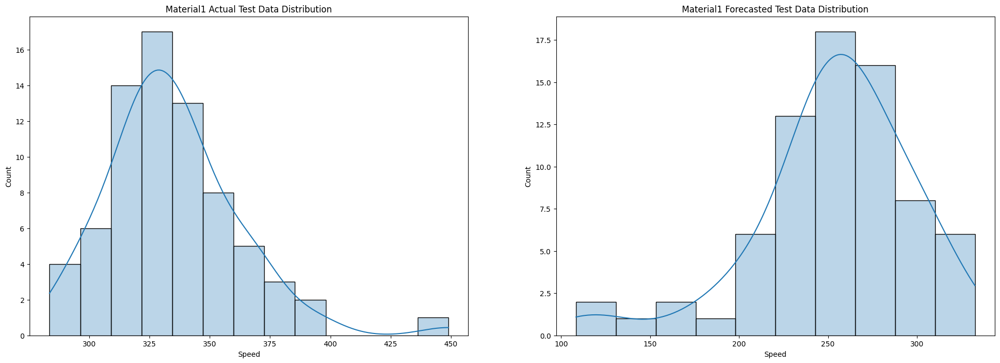

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_speed_Material1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material1['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.277
MAE = 0.215
MSE = 0.077
SMAPE = 41.76
OPE = 13.402%


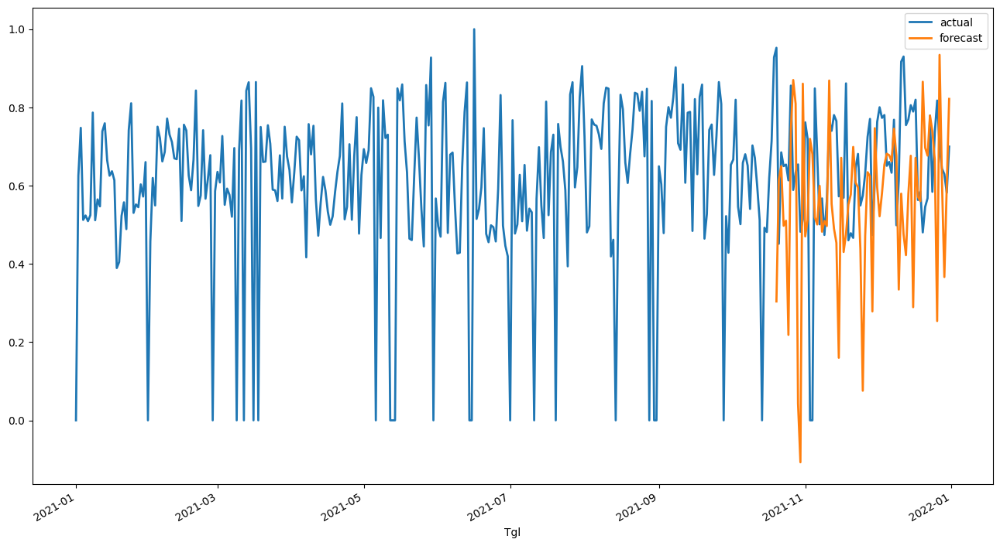

In [ ]:
# prediction for Material2
pred = nbeats_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

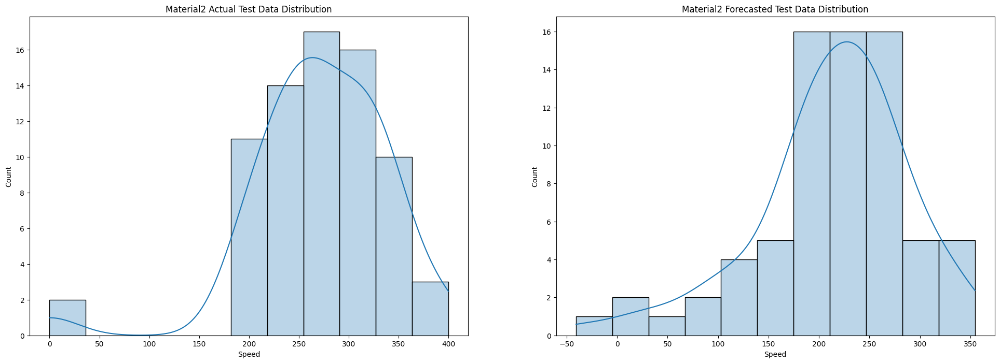

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_speed_Material2_nbeats.csv')
f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material2['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.269
MAE = 0.207
MSE = 0.073
SMAPE = 35.41
OPE = 11.424%


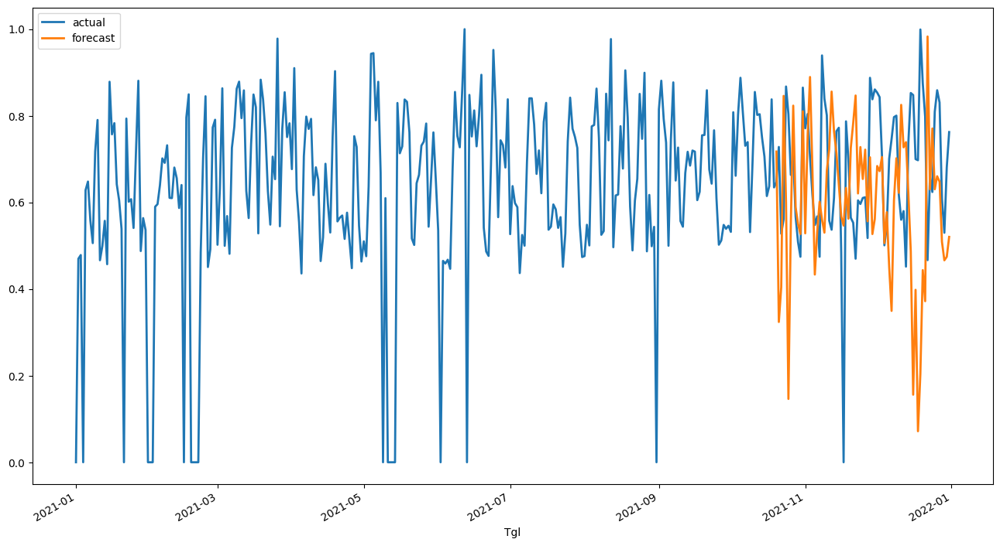

In [ ]:
# prediction for Material3
pred = nbeats_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

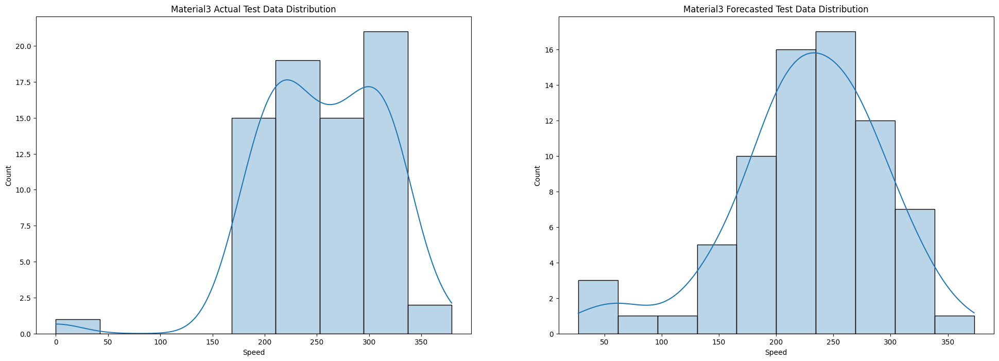

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_speed_Material3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material3['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Speed by Machine with N-Beats**

In [ ]:
Machine1 = run[run['KdMesin']=='Machine1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = run[run['KdMesin']=='Machine2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = run[run['KdMesin']=='Machine3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = run[run['KdMesin']=='Machine5'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = run[run['KdMesin']=='Machine6'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = run[run['KdMesin']=='Machine7'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Speed')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Speed')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Speed')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Speed')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Speed')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Speed')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 5.0
Machine1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 4.0
Machine2_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 16.0
Machine3_periodicity (~months) : 0.5


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 6.0
Machine5_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 11.0
Machine6_periodicity (~months) : 0.4


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 7.0
Machine7_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
Machine1.iloc[-73:].to_csv('/content/run_Machine1.csv')
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
Machine2.iloc[-73:].to_csv('/content/run_Machine2.csv')
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
Machine3.iloc[-73:].to_csv('/content/run_Machine3.csv')
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
Machine5.iloc[-73:].to_csv('/content/run_Machine5.csv')
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
Machine6.iloc[-73:].to_csv('/content/run_Machine6.csv')
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]
Machine7.iloc[-73:].to_csv('/content/run_Machine7.csv')

In [ ]:
# defining and training the model for Machine1
nbeats_Machine1= NBEATSModel(
    input_chunk_length=Machine1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine1.fit(train_Machine1)

[2022-06-22 07:51:06,146] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-06-22 07:51:06,146] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-06-22 07:51:06,241] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 07:51:06,241] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
nbeats_Machine2= NBEATSModel(
    input_chunk_length=Machine2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine2.fit(train_Machine2)

[2022-03-29 02:50:56,570] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 02:50:56,570] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 02:50:56,665] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:50:56,665] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
nbeats_Machine3= NBEATSModel(
    input_chunk_length=Machine3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine3.fit(train_Machine3)

[2022-03-29 03:00:56,965] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 247 samples.
[2022-03-29 03:00:56,965] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 247 samples.
[2022-03-29 03:00:57,058] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 03:00:57,058] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.4 K     Non-trainable params
6.1 M     Total params
49.098    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
nbeats_Machine5= NBEATSModel(
    input_chunk_length=Machine5_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine5.fit(train_Machine5)

[2022-06-22 08:01:15,976] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 08:01:15,976] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-06-22 08:01:16,087] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 08:01:16,087] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine6
nbeats_Machine6= NBEATSModel(
    input_chunk_length=Machine6_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine6.fit(train_Machine6)

[2022-06-22 08:11:29,568] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 252 samples.
[2022-06-22 08:11:29,568] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 252 samples.
[2022-06-22 08:11:29,669] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 08:11:29,669] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine7
nbeats_Machine7= NBEATSModel(
    input_chunk_length=Machine7_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine7.fit(train_Machine7)

[2022-06-22 08:20:44,924] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:20:44,924] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:20:45,030] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 08:20:45,030] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.120
MAE = 0.104
MSE = 0.014
SMAPE = 13.133
OPE = 11.752%


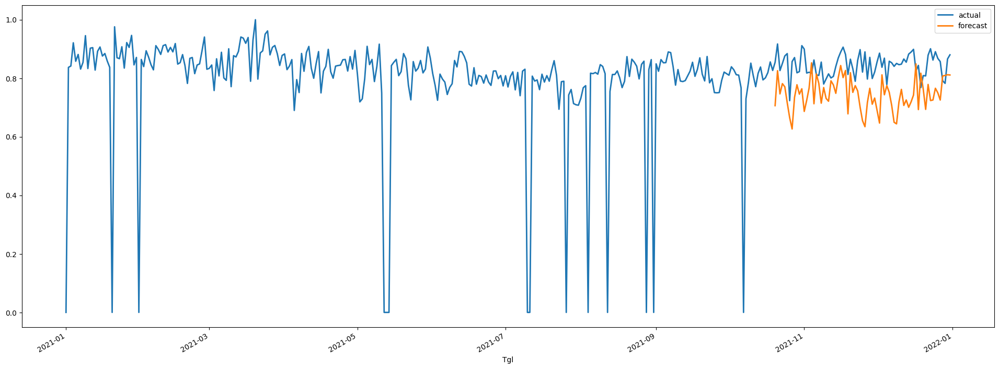

In [ ]:
# prediction for Machine1
mpl.style.use('default')
pred = nbeats_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

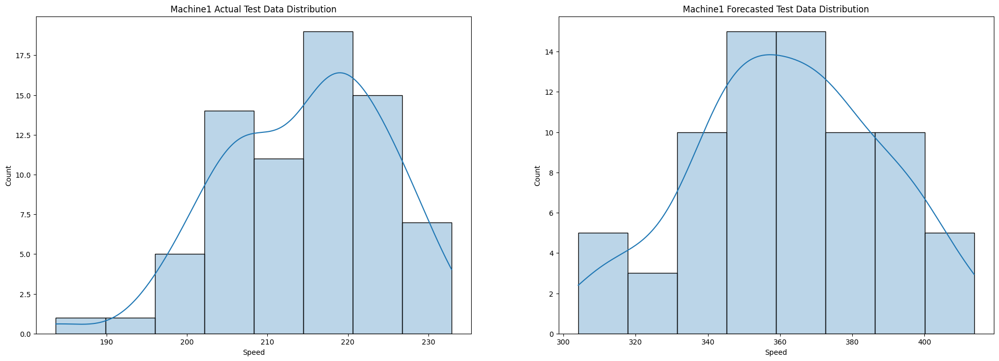

In [ ]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_speed_Machine1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.446
MAE = 0.398
MSE = 0.199
SMAPE = 71.31
OPE = 46.469%


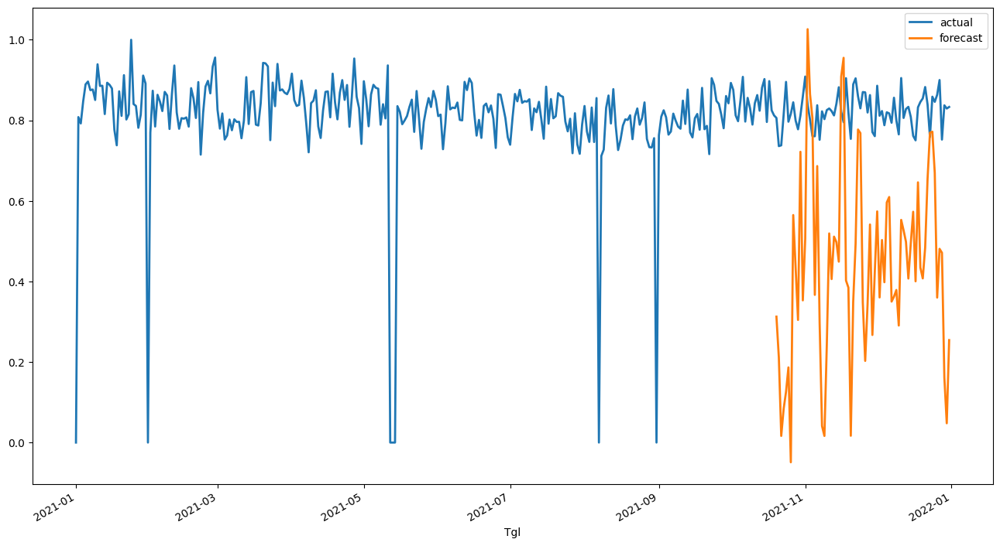

In [ ]:
# prediction for Machine2
pred = nbeats_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

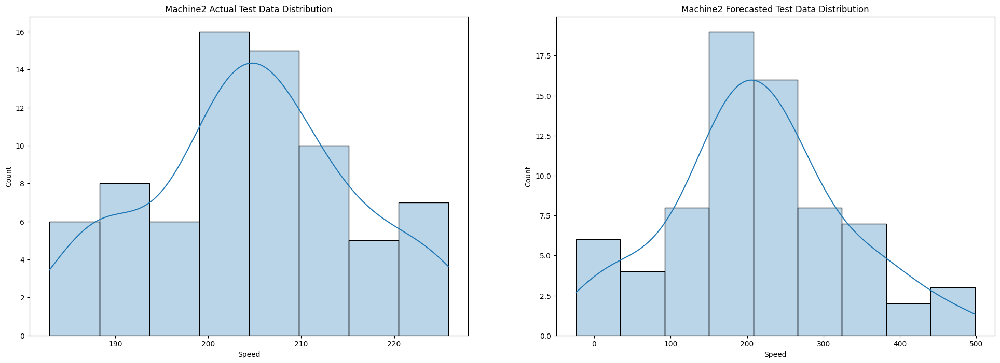

In [ ]:
# normal distribution for Machine2

pred_Machine2 = pd.read_csv('/content/pred_speed_Machine2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.424
MAE = 0.361
MSE = 0.180
SMAPE = 60.92
OPE = 43.052%


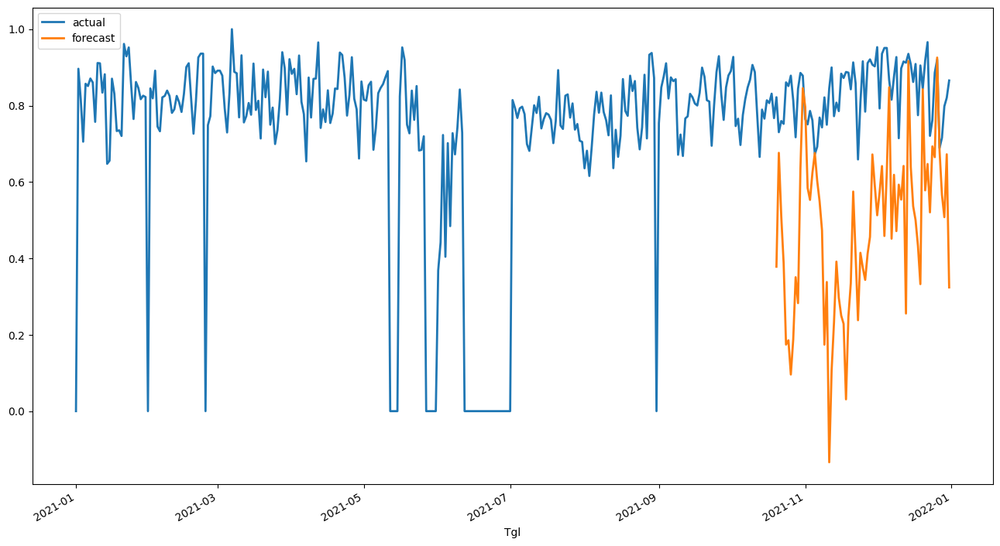

In [ ]:
# prediction for Machine3
pred = nbeats_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

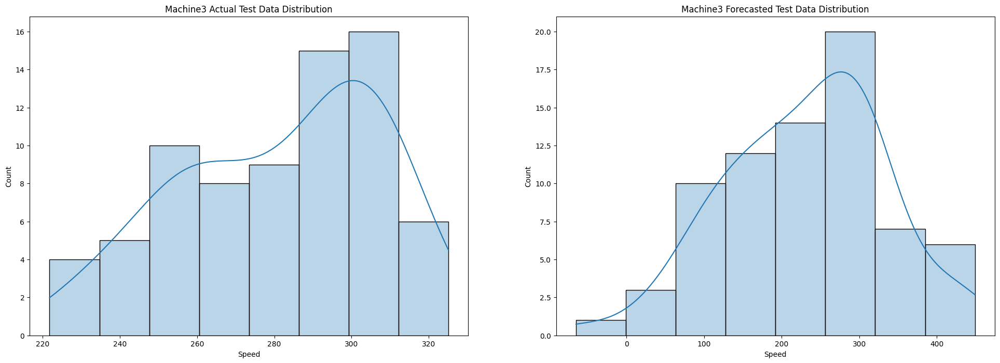

In [ ]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_speed_Machine3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.055
MAE = 0.046
MSE = 0.003
SMAPE = 5.56
OPE = 0.491%


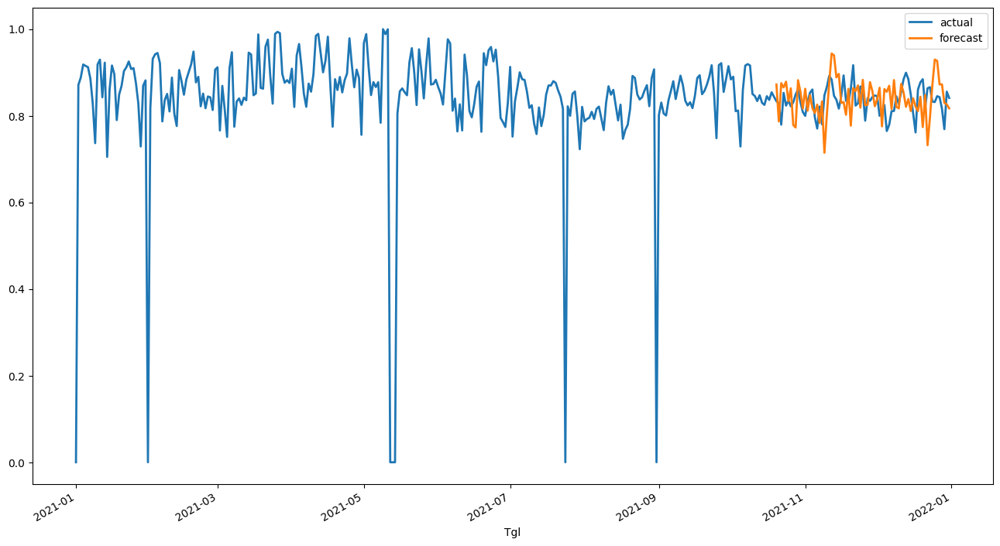

In [ ]:
# prediction for Machine5
pred = nbeats_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine5_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

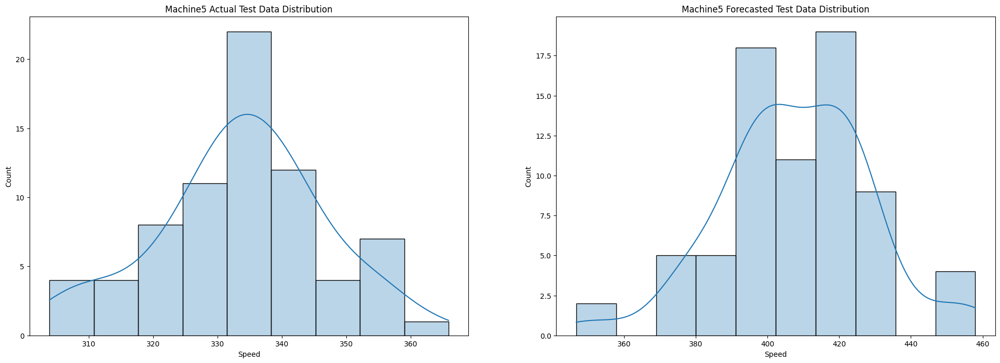

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_speed_Machine5_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.281
MAE = 0.204
MSE = 0.079
SMAPE = 39.20
OPE = 5.547%


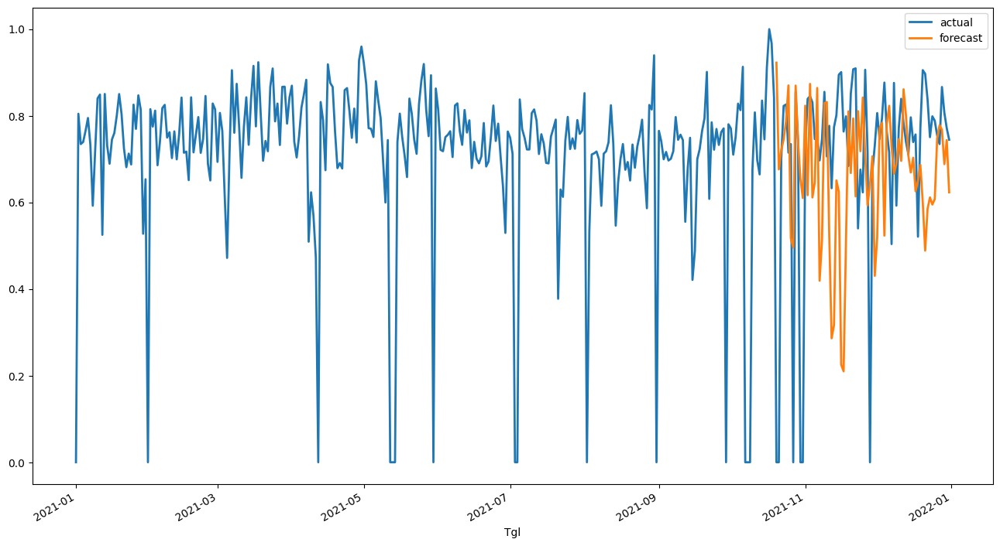

In [ ]:
# prediction for Machine6
pred = nbeats_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine6_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

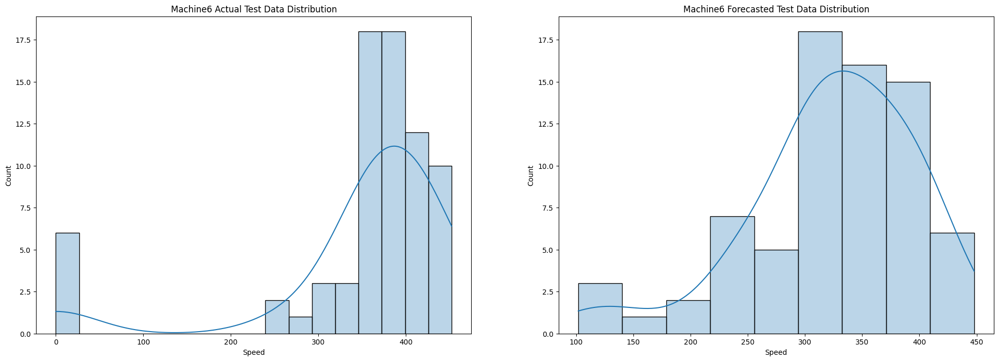

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_speed_Machine6_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.088
MAE = 0.073
MSE = 0.008
SMAPE = 8.33
OPE = 2.106%


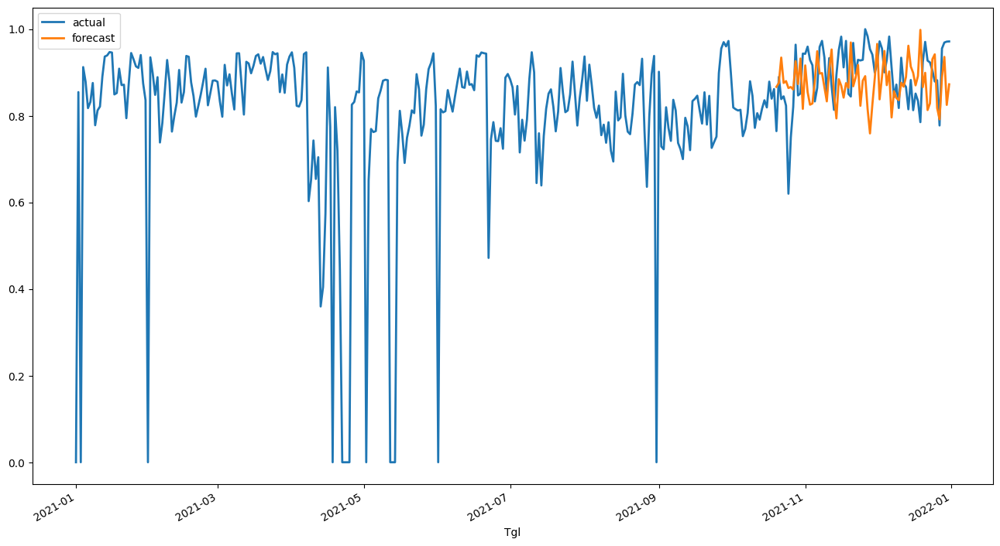

In [ ]:
# prediction for Machine7
pred = nbeats_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine7_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

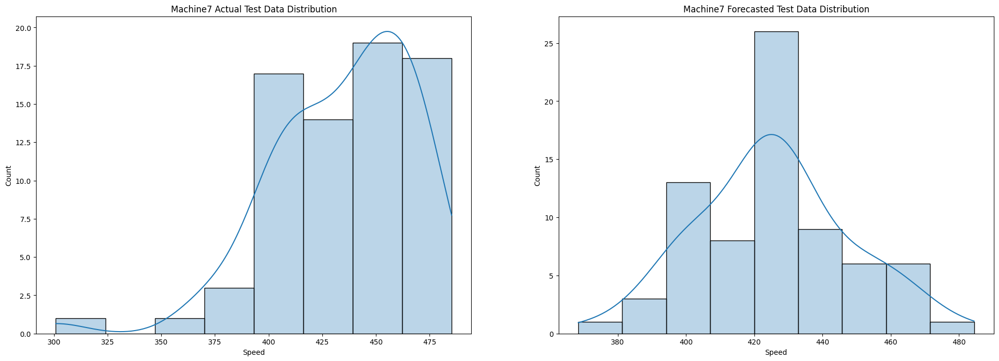

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_speed_Machine7_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Output Data with N-Beats**

### **Forecasting Daily Output by Material with N-Beats**

In [ ]:
op = run.pivot_table(values='Speed',index=['Tgl','OrderID','KdMesin','FILM'],aggfunc='mean').reset_index().rename_axis(None, axis=1)
op['Speed'] = op['Speed'].round(0).astype(int)
op['RunTime'] = run.groupby(['Tgl','OrderID','KdMesin','FILM'])['RunTime'].sum().reset_index().drop(columns=['Tgl','OrderID','KdMesin','FILM'])
op['Output'] = (op['RunTime'] * op['Speed']).astype(int)
op.drop(op[(op['FILM']=='BOP')|(op['FILM']=='CPP')|(op['FILM']=='LIT')|(op['FILM']=='OTHER')].index, inplace=True)

op_all = op.pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
op_all = op_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
Material1 = op[op['FILM']=='Material1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = op[op['FILM']=='Material2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = op[op['FILM']=='Material3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Output')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Output')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Output')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 7.0
Material2_periodicity (~months) : 0.2


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 10.0
Material3_periodicity (~months) : 0.3


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
Material1.iloc[-73:].to_csv('/content/run_Material1.csv')
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
Material2.iloc[-73:].to_csv('/content/run_Material2.csv')
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]
Material3.iloc[-73:].to_csv('/content/run_Material3.csv')

In [ ]:
# defining and training the model for Material1
nbeats_Material1= NBEATSModel(
    input_chunk_length=Material1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material1.fit(train_Material1)

[2022-06-22 08:43:45,505] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:43:45,505] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:43:45,804] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 08:43:45,804] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
nbeats_Material2= NBEATSModel(
    input_chunk_length=Material2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material2.fit(train_Material2)

[2022-06-22 08:56:34,080] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:56:34,080] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-06-22 08:56:34,186] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 08:56:34,186] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
nbeats_Material3= NBEATSModel(
    input_chunk_length=Material3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material3.fit(train_Material3)

[2022-06-22 09:05:35,998] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 253 samples.
[2022-06-22 09:05:35,998] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 253 samples.
[2022-06-22 09:05:36,098] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-06-22 09:05:36,098] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.174
MAE = 0.142
MSE = 0.030
SMAPE = 28.693
OPE = 1.539%


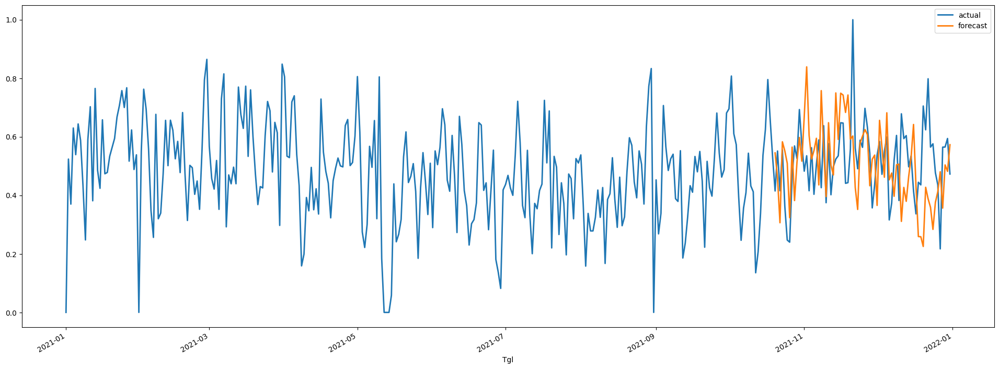

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = nbeats_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

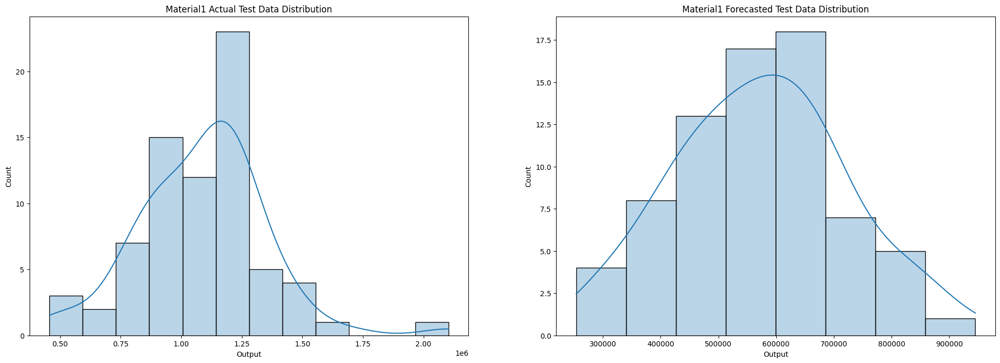

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_op_Material1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material1['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.272
MAE = 0.211
MSE = 0.074
SMAPE = 97.97
OPE = 29.981%


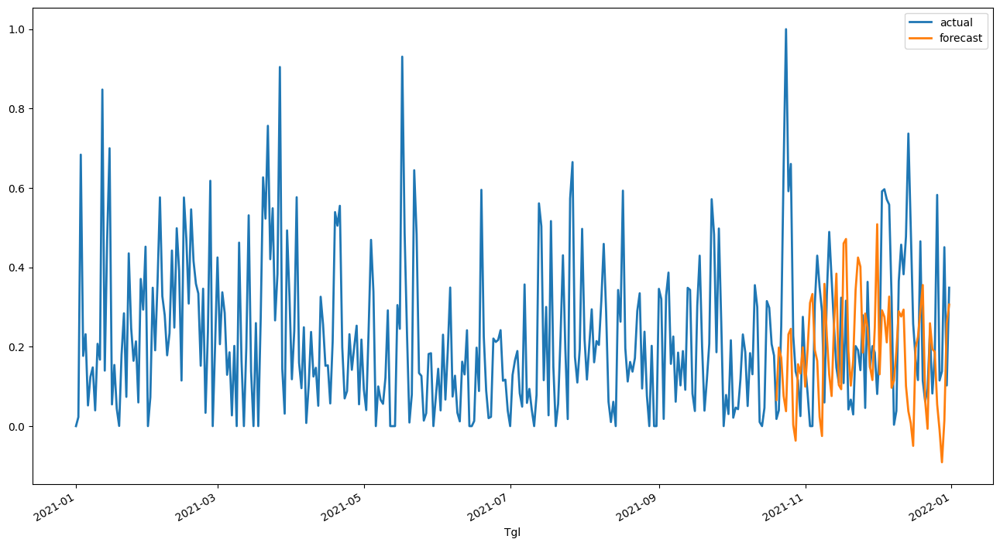

In [ ]:
# prediction for Material2
pred = nbeats_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

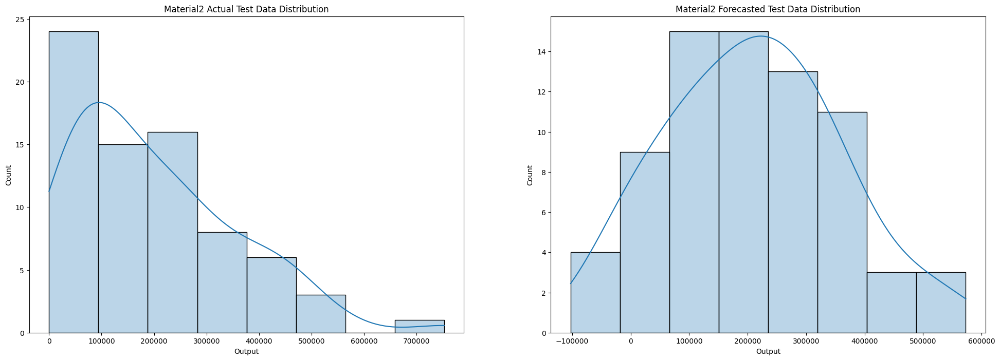

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_op_Material2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material2['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.225
MAE = 0.186
MSE = 0.051
SMAPE = 96.18
OPE = 12.433%


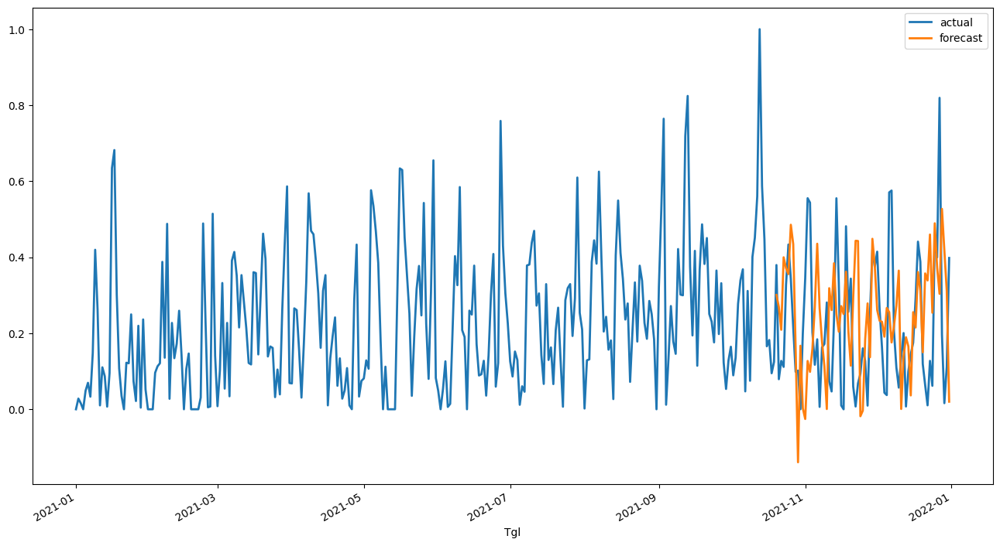

In [ ]:
# prediction for Material3
pred = nbeats_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

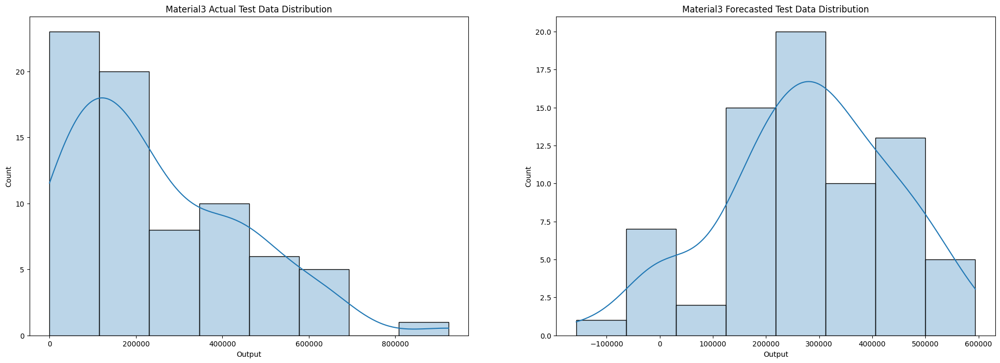

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_op_Material3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material3['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Output by Machine with N-Beats**

In [ ]:
Machine1 = op[op['KdMesin']=='Machine1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = op[op['KdMesin']=='Machine2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = op[op['KdMesin']=='Machine3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = op[op['KdMesin']=='Machine5'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = op[op['KdMesin']=='Machine6'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = op[op['KdMesin']=='Machine7'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by machine
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Output')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Output')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Output')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Output')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Output')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Output')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 8.0
Machine1_periodicity (~months) : 0.3


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 7.0
Machine2_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 6.0
Machine3_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 3.0
Machine5_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 8.0
Machine6_periodicity (~months) : 0.3


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 6.0
Machine7_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
Machine1.iloc[-73:].to_csv('/content/run_Machine1.csv')
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
Machine2.iloc[-73:].to_csv('/content/run_Machine2.csv')
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
Machine3.iloc[-73:].to_csv('/content/run_Machine3.csv')
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
Machine5.iloc[-73:].to_csv('/content/run_Machine5.csv')
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
Machine6.iloc[-73:].to_csv('/content/run_Machine6.csv')
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]
Machine7.iloc[-73:].to_csv('/content/run_Machine7.csv')

In [ ]:
# defining and training the model for Machine1
nbeats_Machine1= NBEATSModel(
    input_chunk_length=Machine1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
nbeats_Machine2= NBEATSModel(
    input_chunk_length=Machine2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
nbeats_Machine3= NBEATSModel(
    input_chunk_length=Machine3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
nbeats_Machine5= NBEATSModel(
    input_chunk_length=Machine5_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine5.fit(train_Machine5)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine6
nbeats_Machine6= NBEATSModel(
    input_chunk_length=Machine6_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine6.fit(train_Machine6)

In [ ]:
# defining and training the model for Machine7
nbeats_Machine7= NBEATSModel(
    input_chunk_length=Machine7_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine7.fit(train_Machine7)

Training: 0it [00:00, ?it/s]

In [ ]:
# prediction for Machine1
mpl.style.use('default')
pred = nbeats_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

In [ ]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_op_Machine1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.200
MAE = 0.164
MSE = 0.040
SMAPE = 40.82
OPE = 0.482%


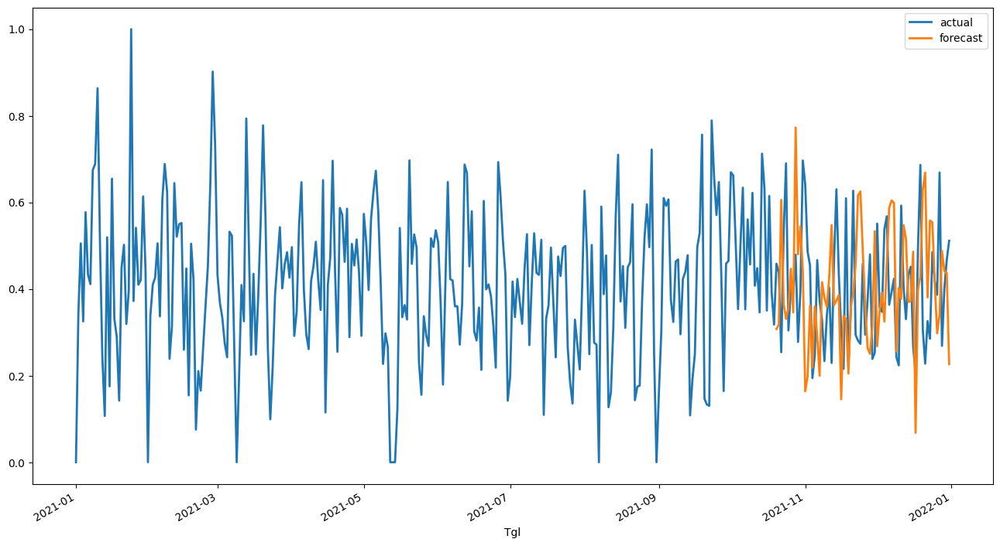

In [ ]:
# prediction for Machine2
pred = nbeats_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

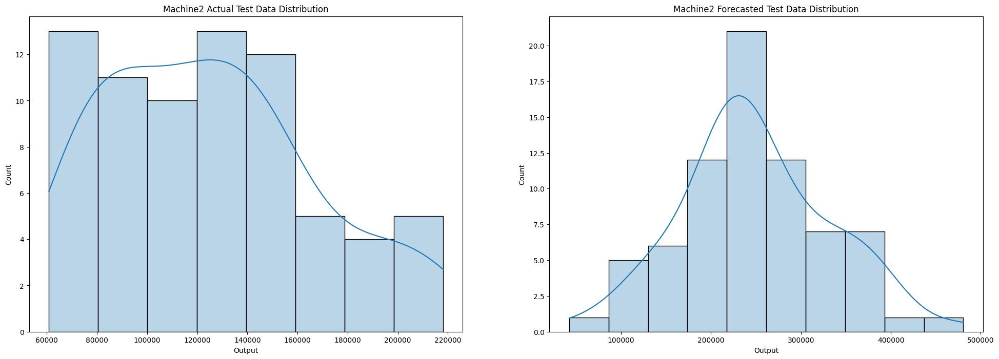

In [ ]:
# normal distribution for Machine2

pred_Machine2 = pd.read_csv('/content/pred_op_Machine2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.259
MAE = 0.206
MSE = 0.067
SMAPE = 43.84
OPE = 21.340%


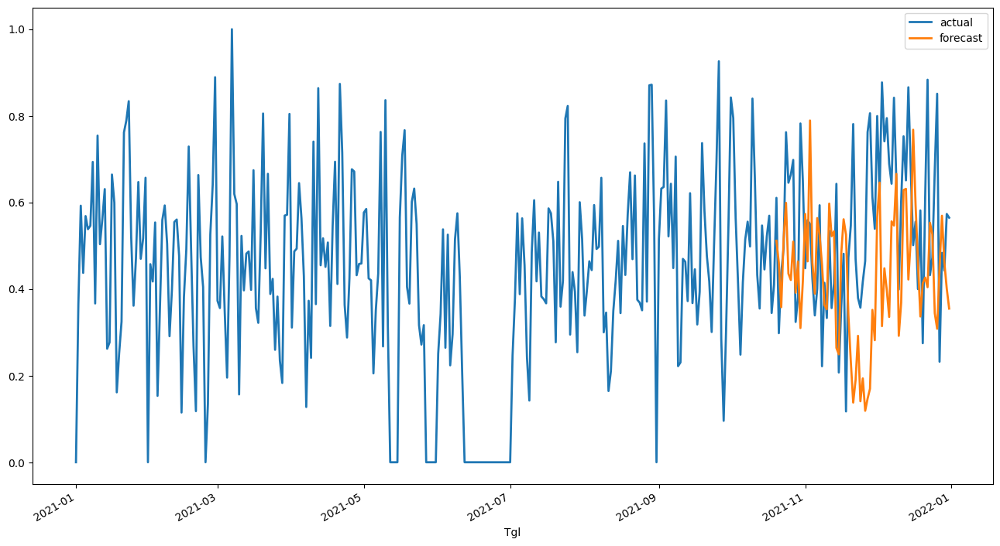

In [ ]:
# prediction for Machine3
pred = nbeats_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

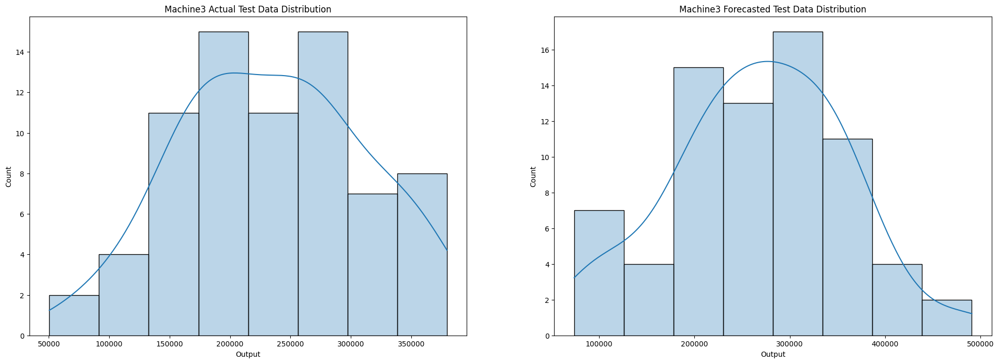

In [ ]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_op_Machine3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.162
MAE = 0.122
MSE = 0.026
SMAPE = 18.99
OPE = 0.542%


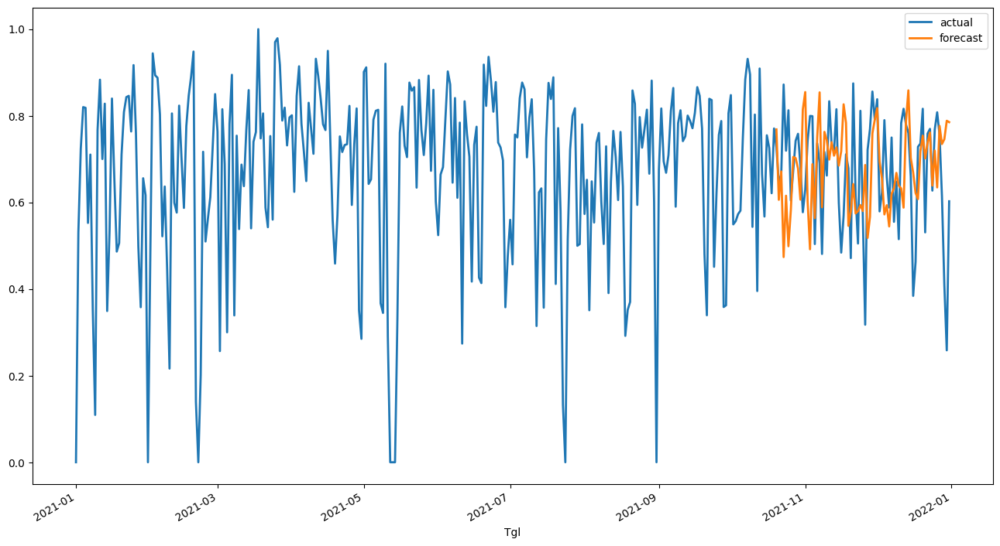

In [ ]:
# prediction for Machine5
pred = nbeats_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine5_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

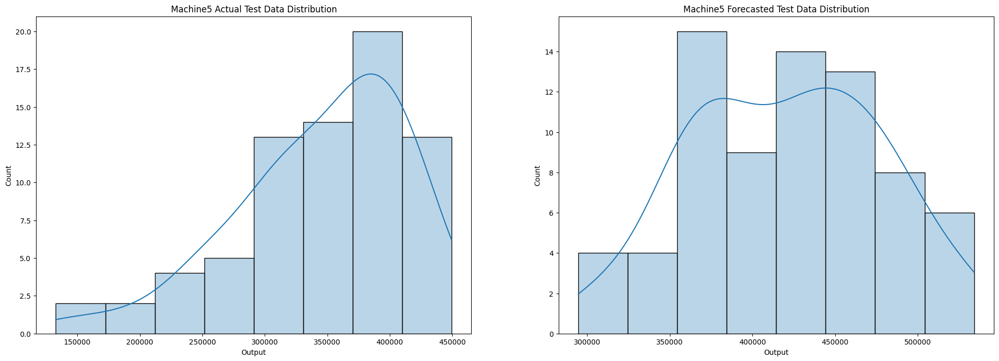

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_op_Machine5_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.250
MAE = 0.191
MSE = 0.062
SMAPE = 59.67
OPE = 32.862%


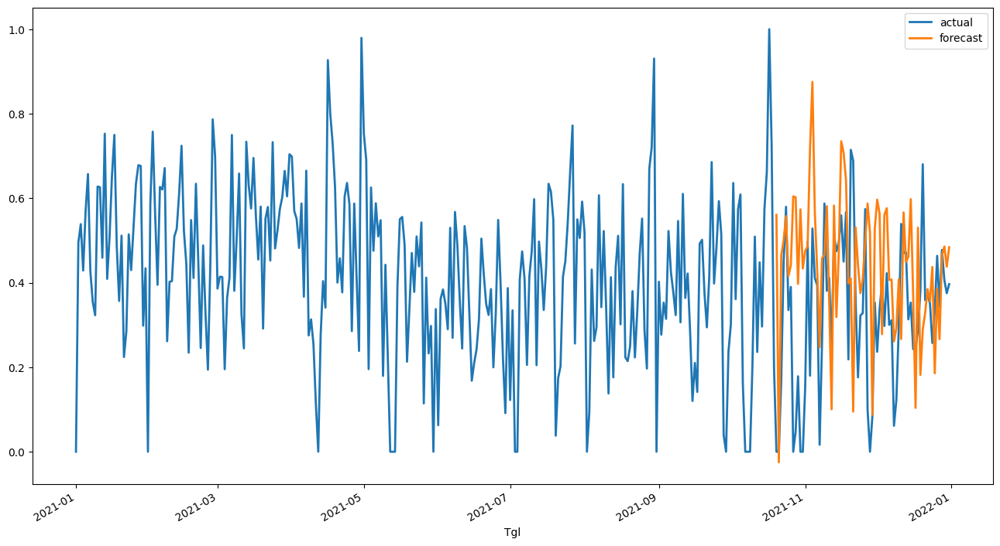

In [ ]:
# prediction for Machine6
pred = nbeats_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine6_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

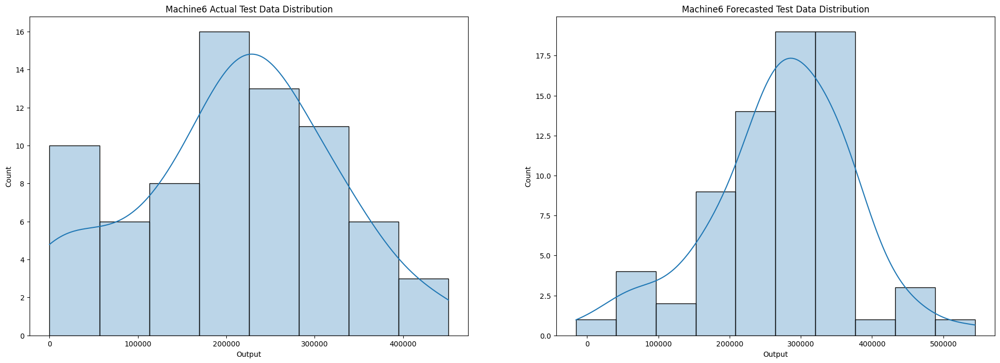

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_op_Machine6_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.200
MAE = 0.163
MSE = 0.040
SMAPE = 26.00
OPE = 12.525%


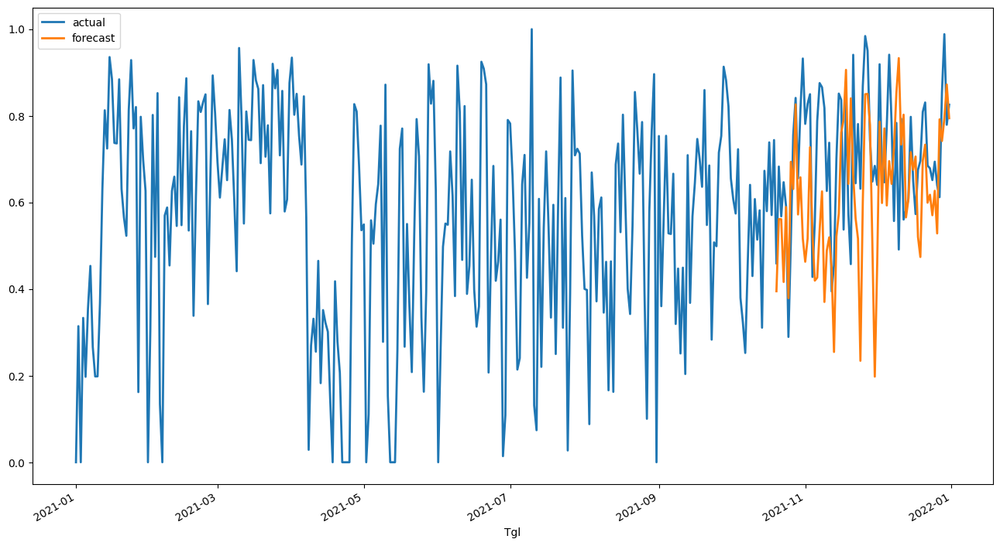

In [ ]:
# prediction for Machine7
pred = nbeats_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine7_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

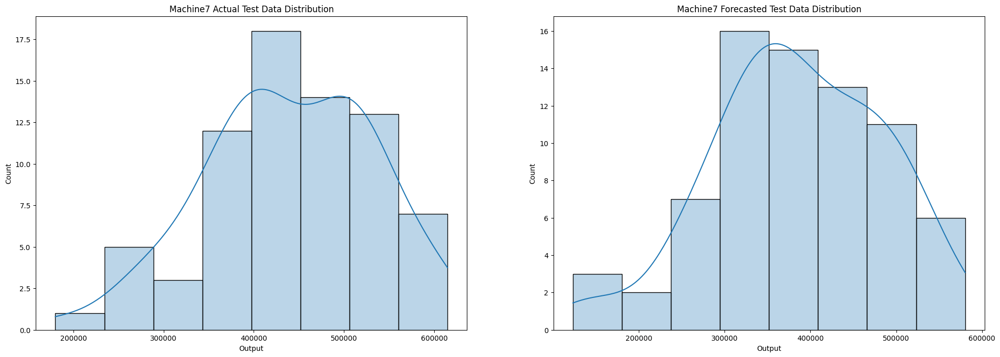

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_op_Machine7_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Downtime Data with N-Beats**


In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
down_all = df[df['KodeBD']!='RUN'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
down_all = down_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series
down_series = TimeSeries.from_dataframe(down_all, 'index','Downtime')

### **Forecasting Daily Downtime by Material With N-Beats**

In [ ]:
Material1 = down[down['FILM']=='Material1'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = down[down['FILM']=='Material2'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = down[down['FILM']=='Material3'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Downtime')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Downtime')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Downtime')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 6.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 3.0
Material2_periodicity (~months) : 0.1


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 4.0
Material3_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
Material1.iloc[-73:].to_csv('/content/down_Material1.csv')
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
Material2.iloc[-73:].to_csv('/content/down_Material2.csv')
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]
Material3.iloc[-73:].to_csv('/content/down_Material3.csv')

In [ ]:
# defining and training the model for Material1
nbeats_Material1= NBEATSModel(
    input_chunk_length=Material1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material1.fit(train_Material1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
nbeats_Material2= NBEATSModel(
    input_chunk_length=Material2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material2.fit(train_Material2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
nbeats_Material3= NBEATSModel(
    input_chunk_length=Material3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Material3.fit(train_Material3)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.259
MAE = 0.203
MSE = 0.067
SMAPE = 45.884
OPE = 22.186%


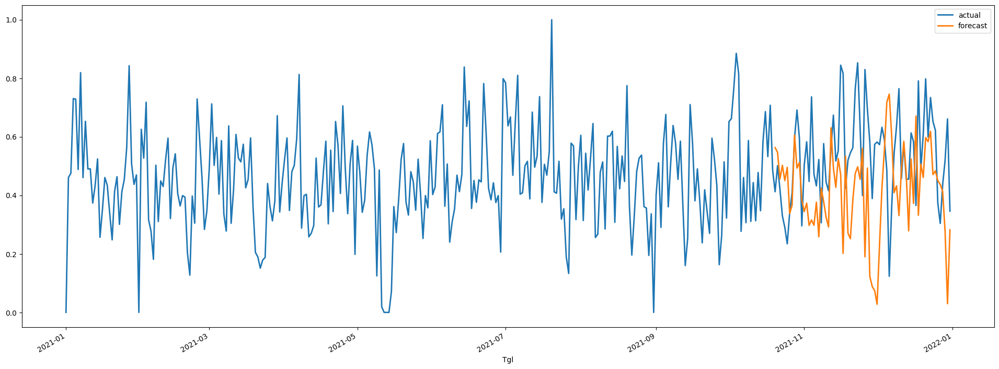

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = nbeats_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

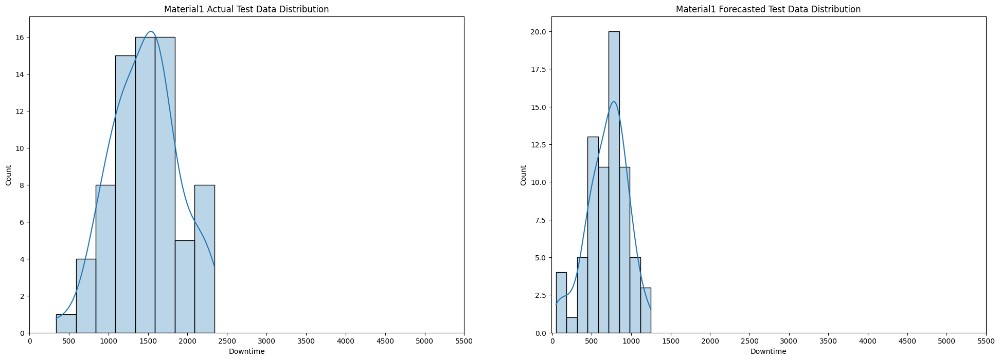

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_down_Material1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_Material1['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.254
MAE = 0.193
MSE = 0.065
SMAPE = 81.66
OPE = 23.530%


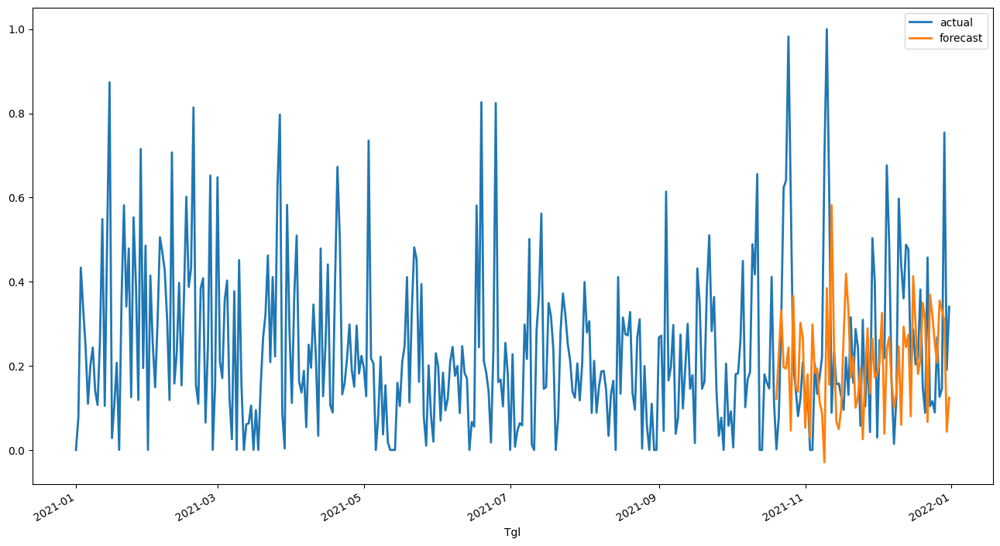

In [ ]:
# prediction for Material2
pred = nbeats_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

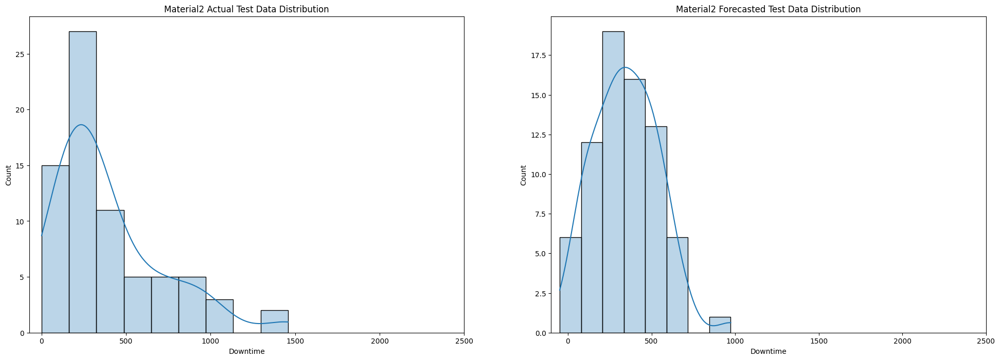

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_down_Material2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material2['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.206
MAE = 0.165
MSE = 0.042
SMAPE = 73.54
OPE = 3.276%


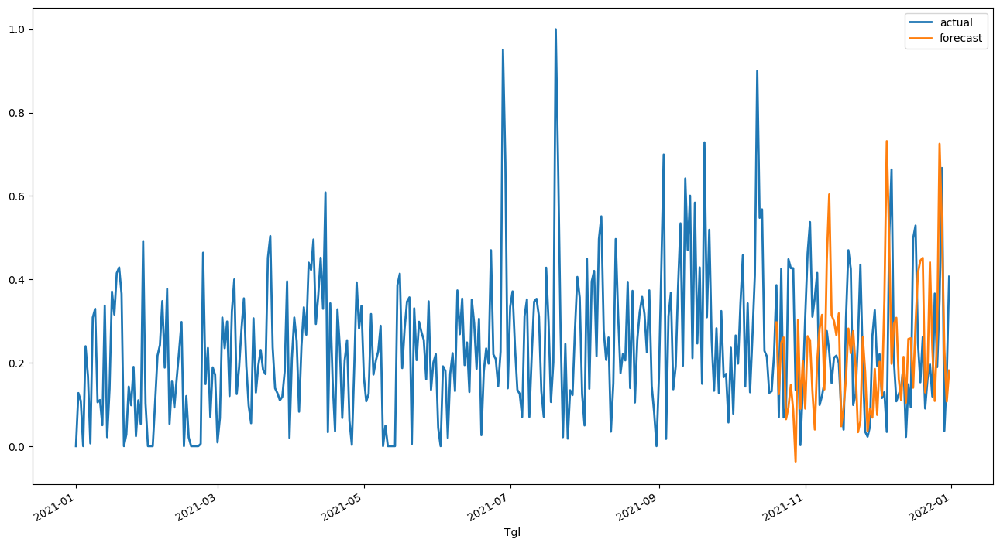

In [ ]:
# prediction for Material3
pred = nbeats_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

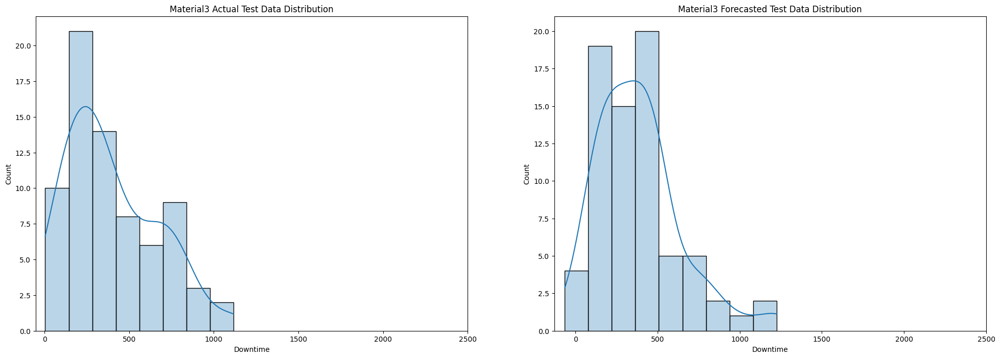

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_down_Material3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material3['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Downtime by Machine With N-Beats**

In [ ]:
Machine1 = down[down['KdMesin']=='Machine1'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = down[down['KdMesin']=='Machine2'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = down[down['KdMesin']=='Machine3'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = down[down['KdMesin']=='Machine5'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = down[down['KdMesin']=='Machine6'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = down[down['KdMesin']=='Machine7'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by machine
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Downtime')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Downtime')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Downtime')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Downtime')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Downtime')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Downtime')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 4.0
Machine1_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 3.0
Machine2_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 5.0
Machine3_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 4.0
Machine5_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 6.0
Machine6_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 4.0
Machine7_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
Machine1.iloc[-73:].to_csv('/content/down_Machine1.csv')
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
Machine2.iloc[-73:].to_csv('/content/down_Machine2.csv')
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
Machine3.iloc[-73:].to_csv('/content/down_Machine3.csv')
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
Machine5.iloc[-73:].to_csv('/content/down_Machine5.csv')
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
Machine6.iloc[-73:].to_csv('/content/down_Machine6.csv')
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]
Machine7.iloc[-73:].to_csv('/content/down_Machine7.csv')

In [ ]:
# defining and training the model for Machine1
nbeats_Machine1= NBEATSModel(
    input_chunk_length=Machine1_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
nbeats_Machine2= NBEATSModel(
    input_chunk_length=Machine2_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
nbeats_Machine3= NBEATSModel(
    input_chunk_length=Machine3_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
nbeats_Machine5= NBEATSModel(
    input_chunk_length=Machine5_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine5.fit(train_Machine5)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine6
nbeats_Machine6= NBEATSModel(
    input_chunk_length=Machine6_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine6.fit(train_Machine6)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine7
nbeats_Machine7= NBEATSModel(
    input_chunk_length=Machine7_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_Machine7.fit(train_Machine7)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.259
MAE = 0.203
MSE = 0.067
SMAPE = 45.884
OPE = 22.186%


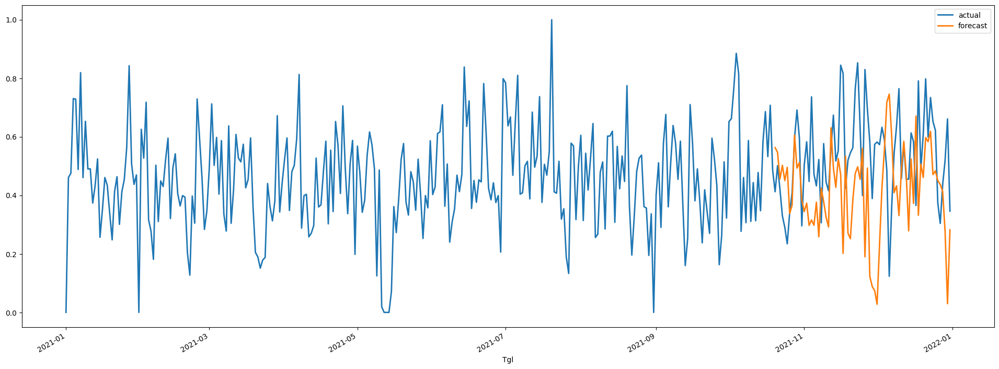

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = nbeats_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material1_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

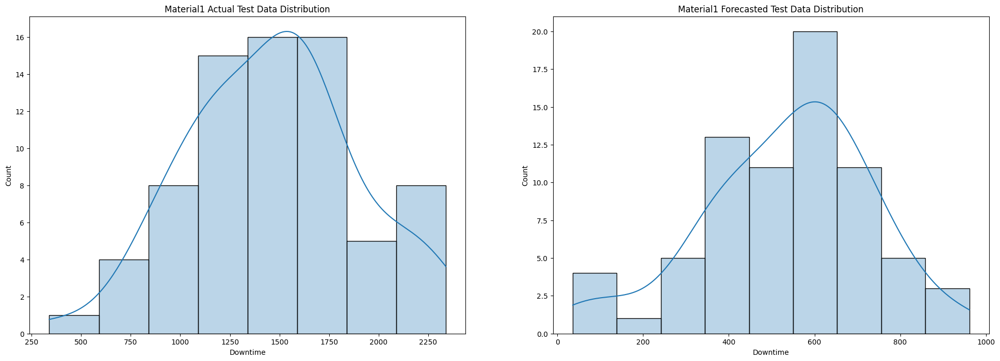

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_down_Material1_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material1['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.254
MAE = 0.193
MSE = 0.065
SMAPE = 81.66
OPE = 23.530%


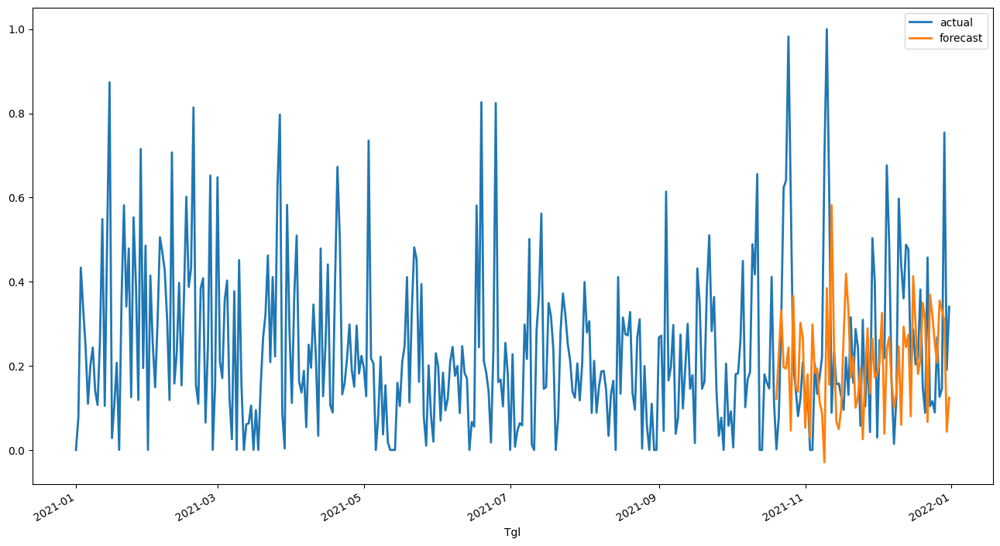

In [ ]:
# prediction for Material2
pred = nbeats_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material2_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

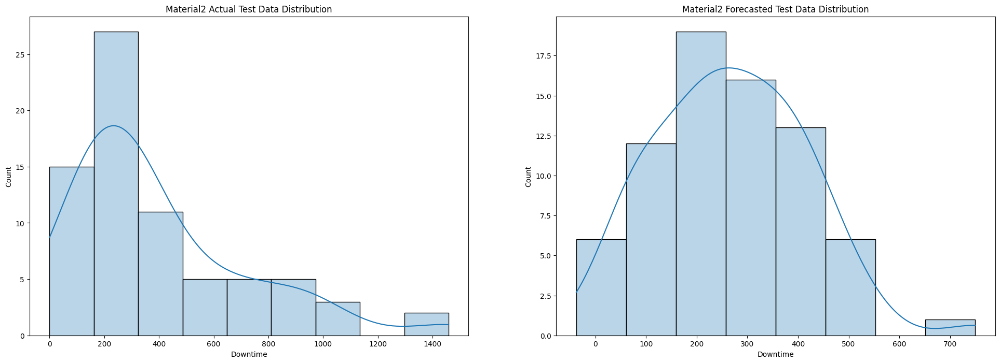

In [ ]:
# normal distribution for Material2

pred_Material2 = pd.read_csv('/content/pred_down_Material2_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material2['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.206
MAE = 0.165
MSE = 0.042
SMAPE = 73.54
OPE = 3.276%


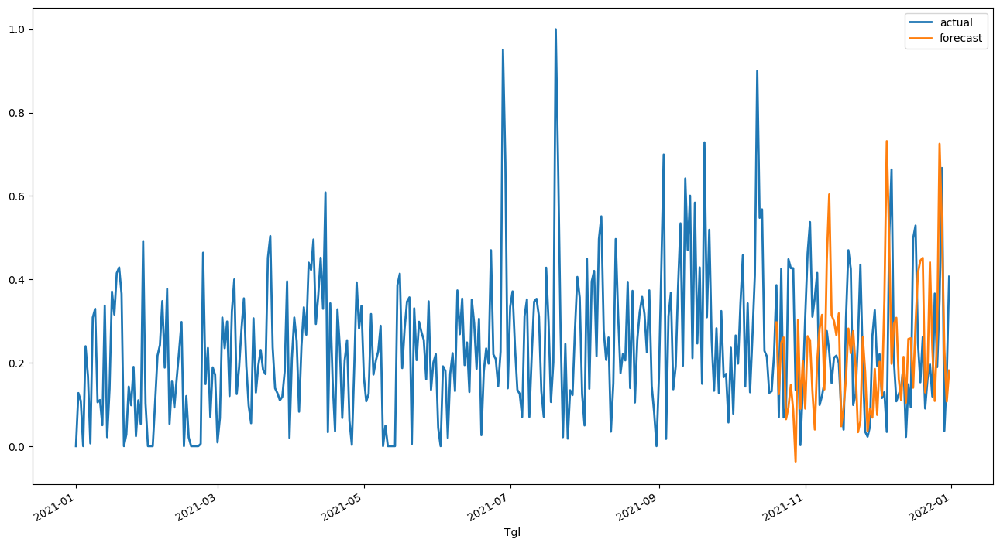

In [ ]:
# prediction for Material3
pred = nbeats_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material3_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

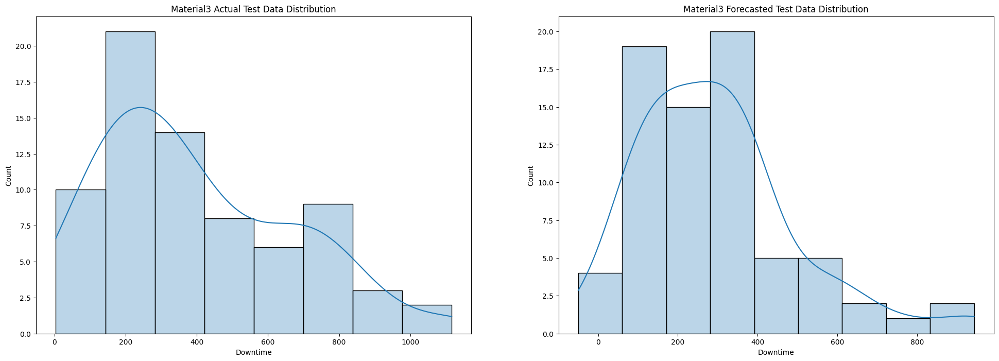

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_down_Material3_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material3['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.130
MAE = 0.094
MSE = 0.017
SMAPE = 45.20
OPE = 22.918%


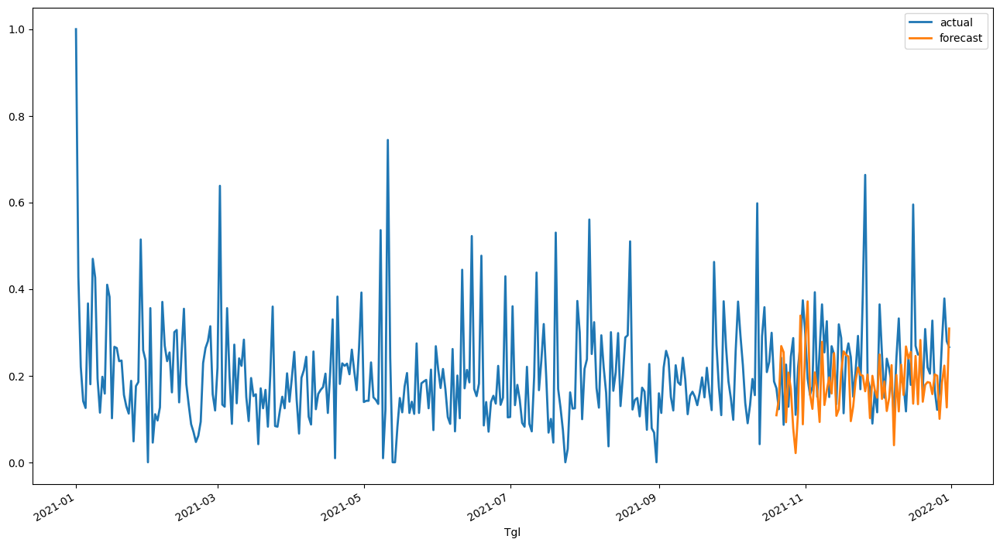

In [ ]:
# prediction for Machine5
pred = nbeats_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine5_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

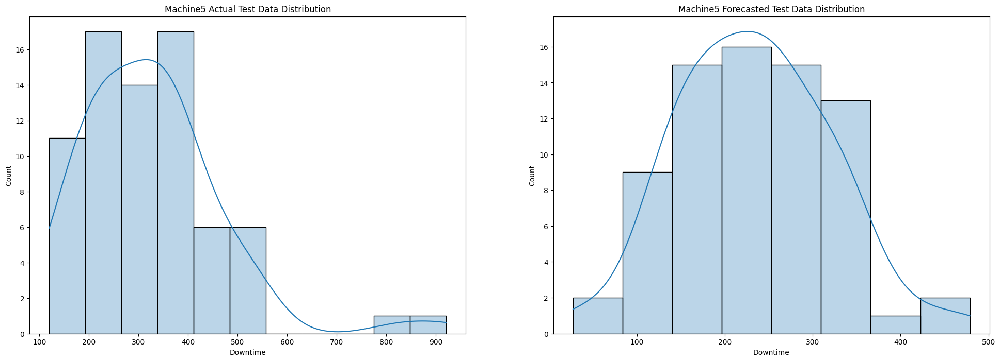

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_down_Machine5_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.195
MAE = 0.146
MSE = 0.038
SMAPE = 59.95
OPE = 19.069%


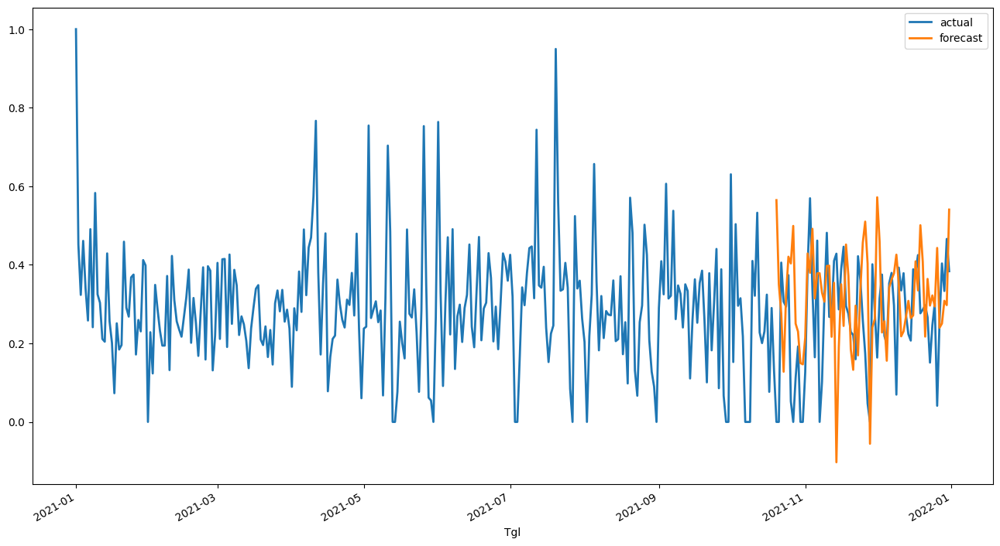

In [ ]:
# prediction for Machine6
pred = nbeats_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine6_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

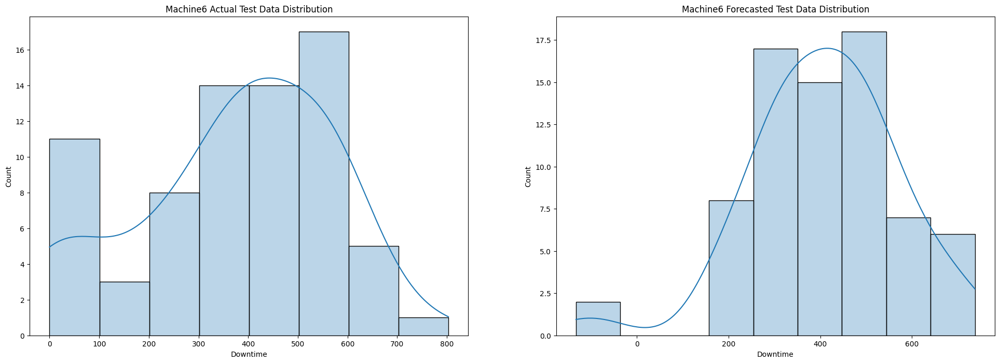

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_down_Machine6_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.163
MAE = 0.131
MSE = 0.027
SMAPE = 63.30
OPE = 11.769%


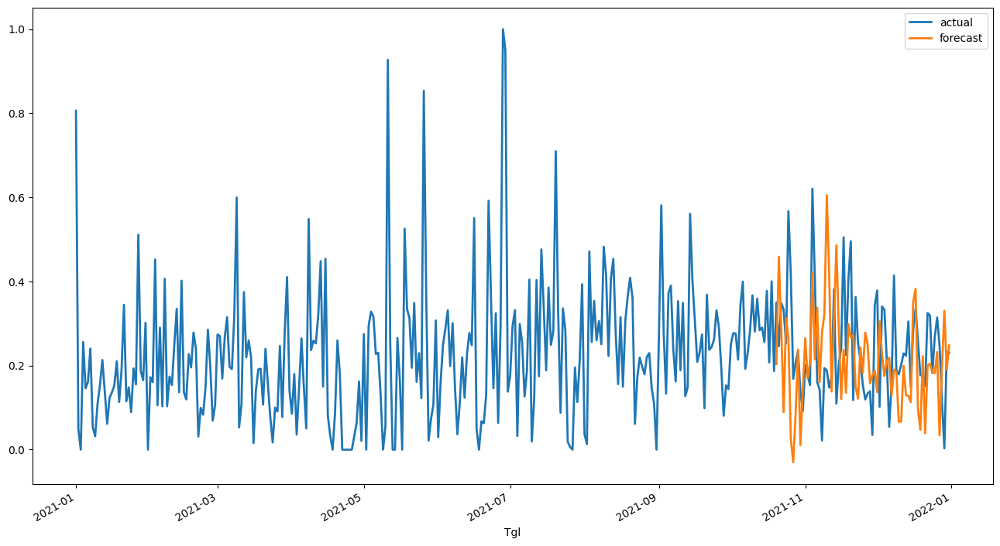

In [ ]:
# prediction for Machine7
pred = nbeats_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine7_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

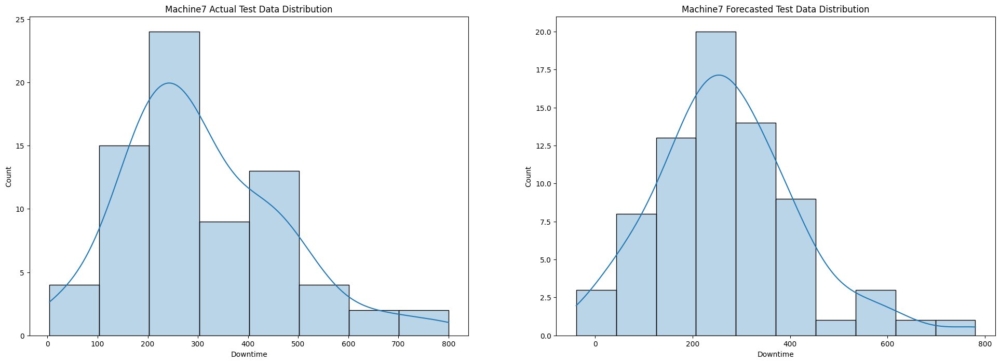

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_down_Machine7_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Runtime Data with RNN**

### **Forecasting Daily Runtime by Material With RNN**

In [ ]:
Material1 = run[run['FILM']=='Material1'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = run[run['FILM']=='Material2'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = run[run['FILM']=='Material3'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','RunTime')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','RunTime')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','RunTime')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 7.0
Material2_periodicity (~months) : 0.2


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 7.0
Material3_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
Material1.iloc[-73:].to_csv('/content/run_Material1.csv')
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
Material2.iloc[-73:].to_csv('/content/run_Material2.csv')
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]
Material3.iloc[-73:].to_csv('/content/run_Material3.csv')

In [ ]:
# defining and training the model for Material1
rnn_Material1= RNNModel(
    model="RNN",
    input_chunk_length=Material1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material1.fit(train_Material1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
rnn_Material2= RNNModel(
    model="RNN",
    input_chunk_length=Material2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material2.fit(train_Material2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
rnn_Material3= RNNModel(
    model="RNN",
    input_chunk_length=Material3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material3.fit(train_Material3)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.138
MAE = 0.105
MSE = 0.019
SMAPE = 19.727
OPE = 2.648%


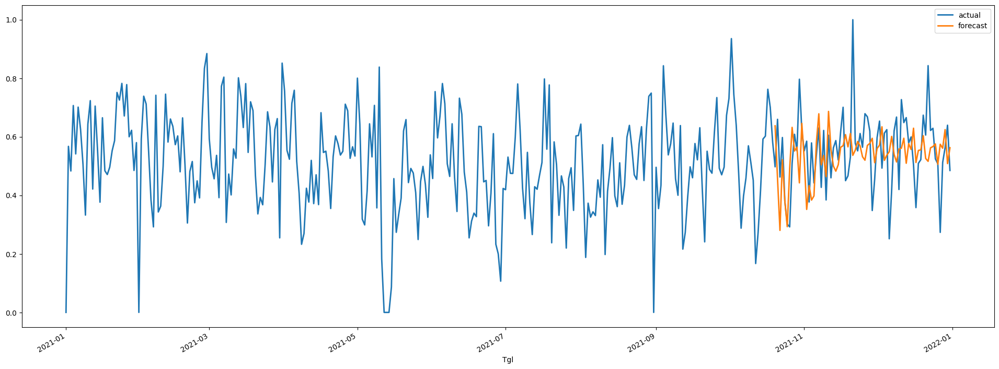

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = rnn_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

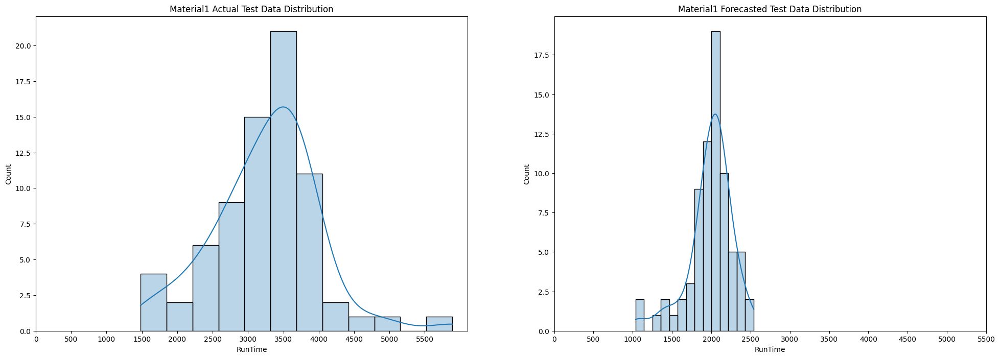

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_run_Material1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_Material1['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.252
MAE = 0.186
MSE = 0.064
SMAPE = 87.59
OPE = 35.644%


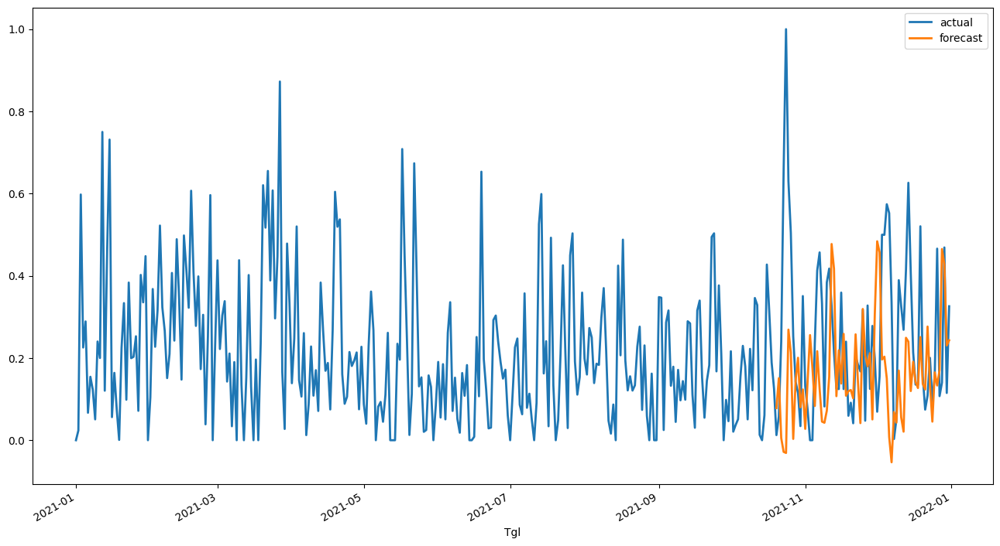

In [ ]:
# prediction for Material2
pred = rnn_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

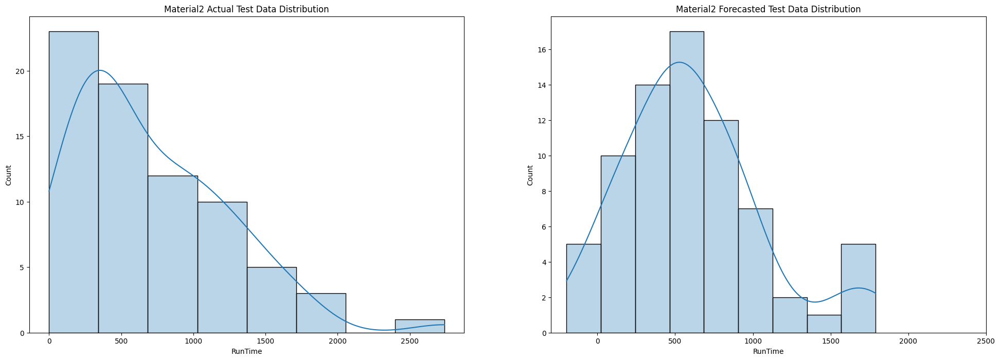

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_run_Material2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material2['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.195
MAE = 0.154
MSE = 0.038
SMAPE = 67.70
OPE = 17.026%


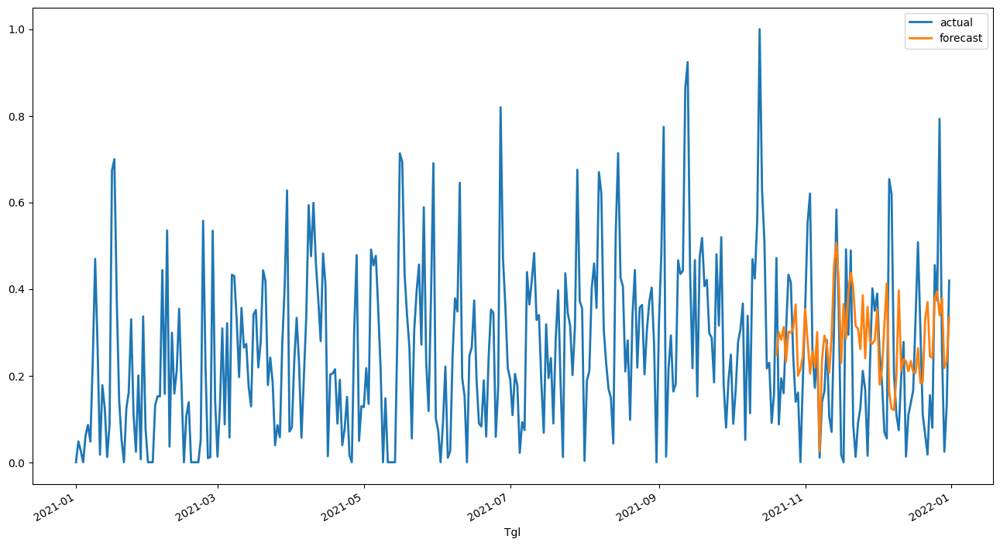

In [ ]:
# prediction for Material3
pred = rnn_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Material3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

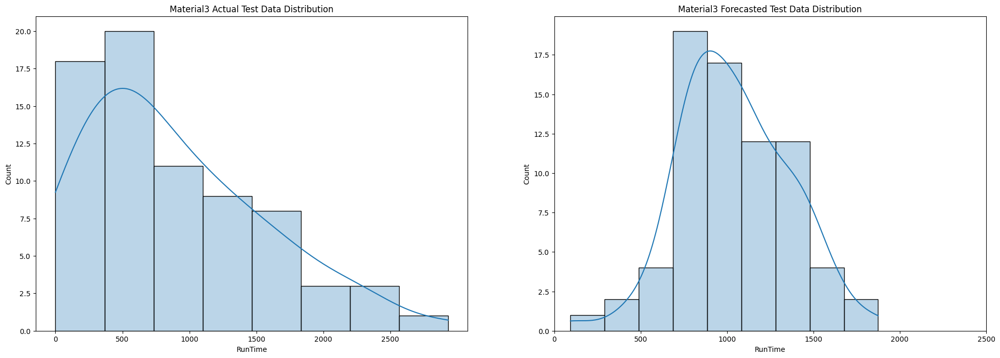

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_run_Material3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material3['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With RNN**

In [ ]:
Machine1 = run[run['KdMesin']=='Machine1'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = run[run['KdMesin']=='Machine2'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = run[run['KdMesin']=='Machine3'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = run[run['KdMesin']=='Machine5'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = run[run['KdMesin']=='Machine6'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = run[run['KdMesin']=='Machine7'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','RunTime')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','RunTime')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','RunTime')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','RunTime')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','RunTime')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','RunTime')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 7.0
Machine1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 7.0
Machine2_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 6.0
Machine3_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 3.0
Machine5_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 8.0
Machine6_periodicity (~months) : 0.3


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 6.0
Machine7_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]

In [ ]:
# defining and training the model for Machine1
rnn_Machine1= RNNModel(
    model="RNN",
    input_chunk_length=Machine1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
rnn_Machine2= RNNModel(
    model="RNN",
    input_chunk_length=Machine2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
rnn_Machine3= RNNModel(
    model="RNN",
    input_chunk_length=Machine3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
rnn_Machine5= RNNModel(
    model="RNN",
    input_chunk_length=Machine5_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine5.fit(train_Machine5)

In [ ]:
# defining and training the model for Machine6
rnn_Machine6= RNNModel(
    model="RNN",
    input_chunk_length=Machine6_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine6.fit(train_Machine6)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine7
rnn_Machine7= RNNModel(
    model="RNN",
    input_chunk_length=Machine7_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine7.fit(train_Machine7)

In [ ]:
# prediction for Machine1
mpl.style.use('default')
pred = rnn_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

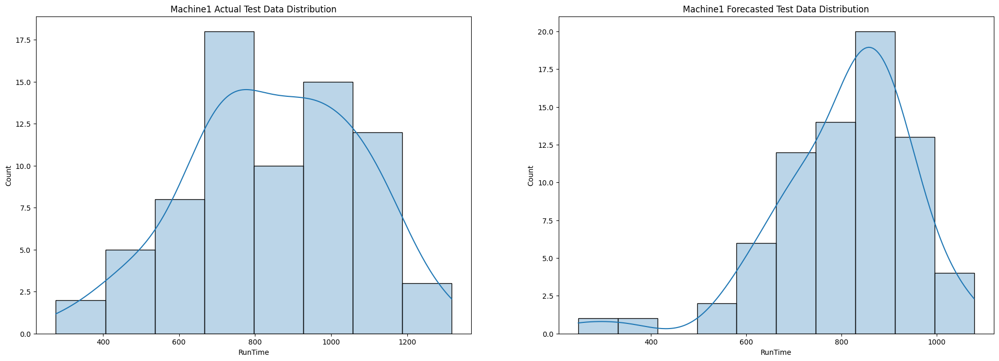

In [ ]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_run_Machine1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

In [ ]:
# prediction for Machine2
pred = rnn_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

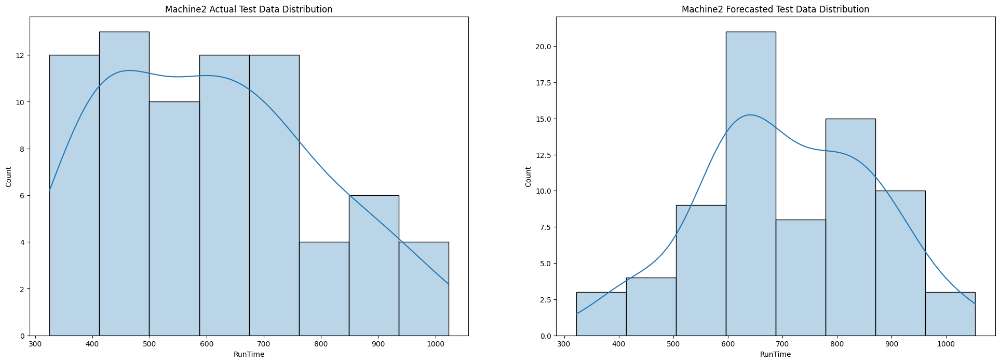

In [ ]:
# normal distribution for Machine2
mpl.style.use('default')

pred_Machine2 = pd.read_csv('/content/pred_run_Machine2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.230
MAE = 0.197
MSE = 0.053
SMAPE = 32.63
OPE = 10.374%


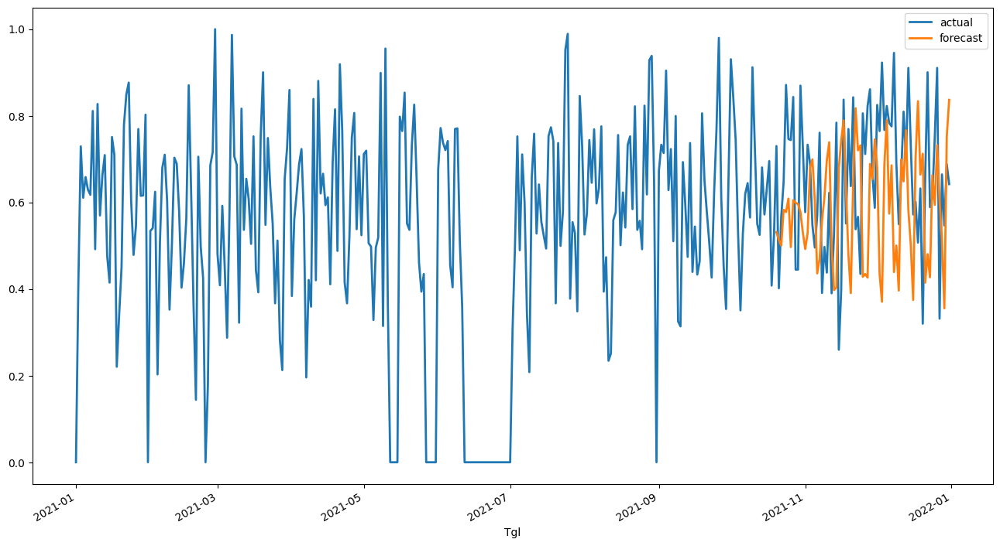

In [ ]:
# prediction for Machine3
pred = rnn_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

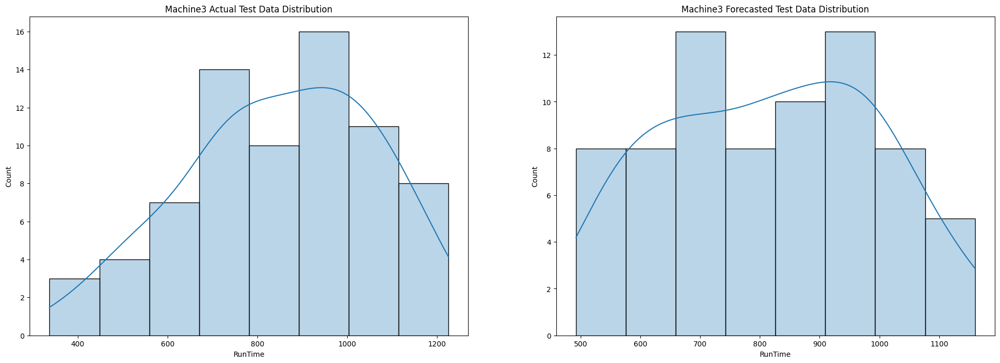

In [ ]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_run_Machine3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.122
MAE = 0.100
MSE = 0.015
SMAPE = 13.78
OPE = 2.170%


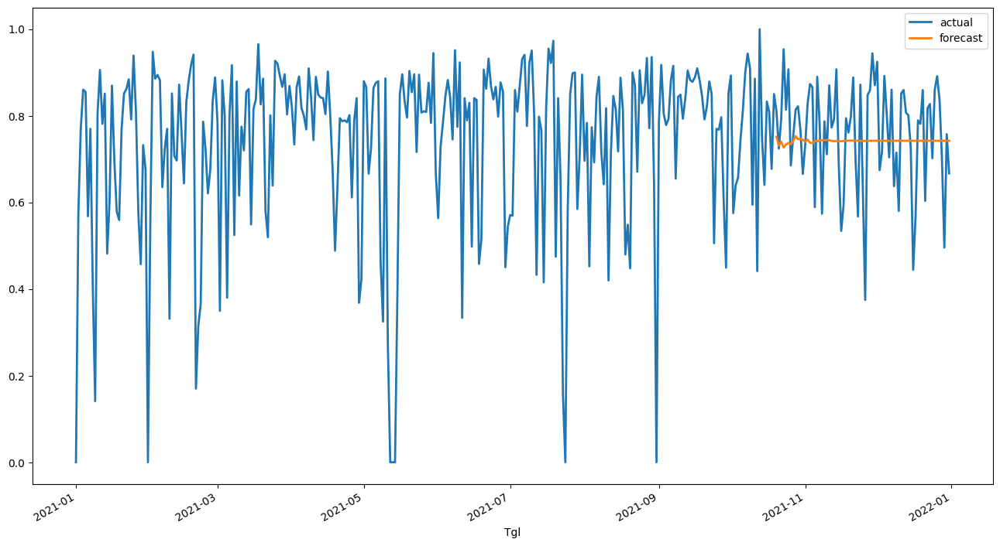

In [ ]:
# prediction for Machine5
pred = rnn_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine5_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

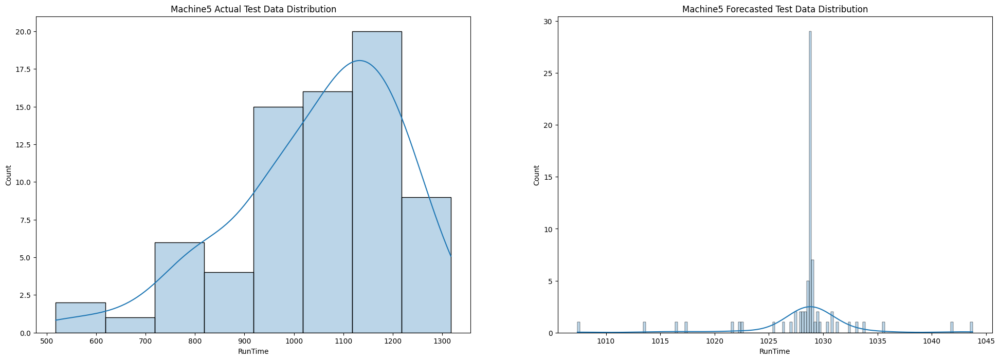

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_run_Machine5_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.305
MAE = 0.231
MSE = 0.093
SMAPE = 55.33
OPE = 41.567%


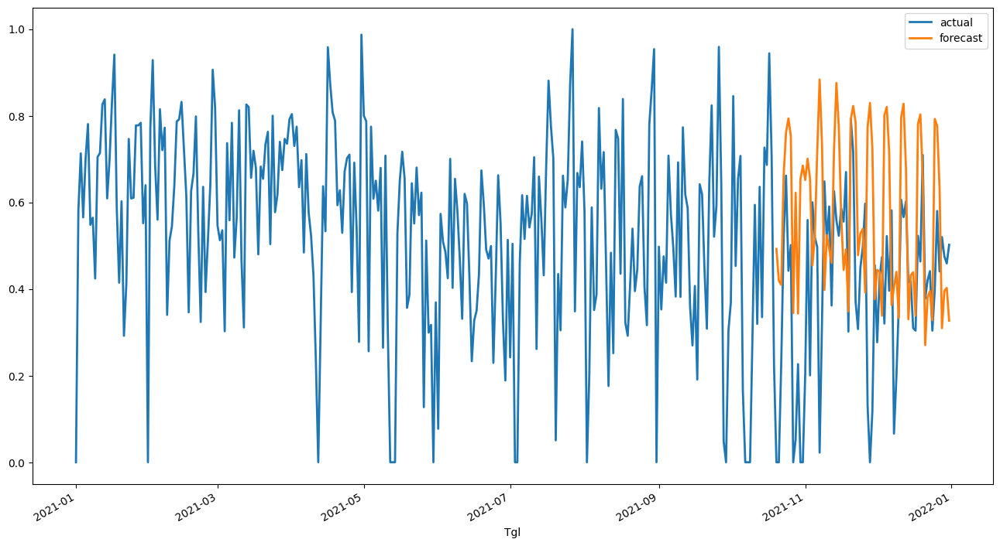

In [ ]:
# prediction for Machine6
pred = rnn_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine6_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

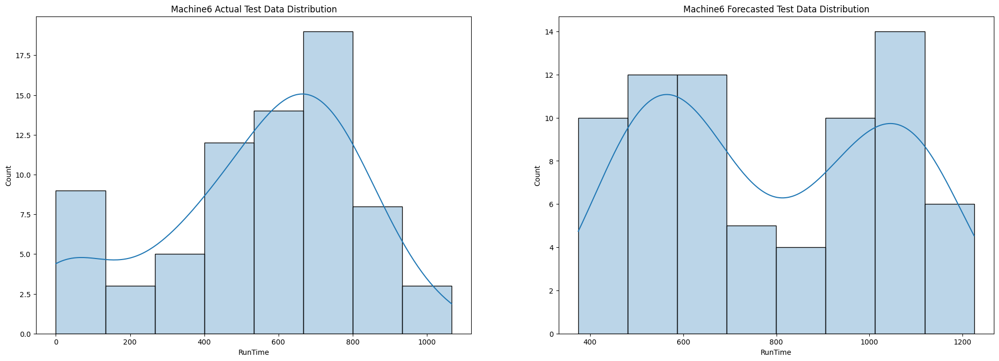

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_run_Machine6_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.169
MAE = 0.131
MSE = 0.029
SMAPE = 18.49
OPE = 2.737%


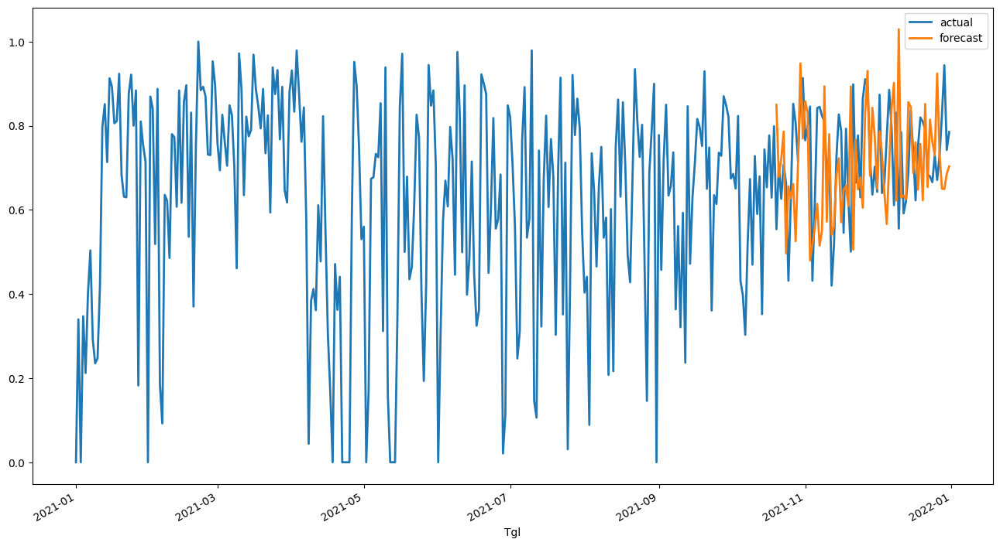

In [ ]:
# prediction for Machine7
pred = rnn_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_Machine7_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

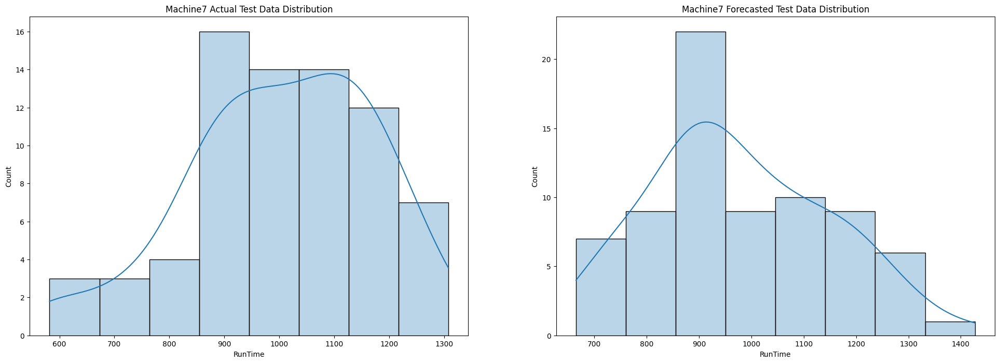

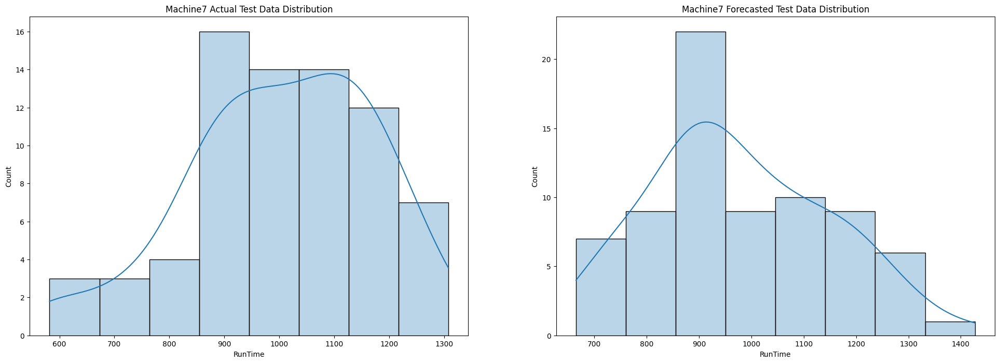

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_run_Machine7_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Speed Data with RNN**

### **Forecasting Daily Speed by Material with RNN**

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
Material1 = run[run['FILM']=='Material1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = run[run['FILM']=='Material2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = run[run['FILM']=='Material3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Speed')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Speed')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Speed')

In [ ]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 6.0
Material2_periodicity (~months) : 0.2


In [ ]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 7.0
Material3_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [ ]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]

In [ ]:
# defining and training the model for Material1
rnn_Material1= RNNModel(
    model="RNN",
    input_chunk_length=Material1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material1.fit(train_Material1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material2
rnn_Material2= RNNModel(
    model="RNN",
    input_chunk_length=Material2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material2.fit(train_Material2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Material3
rnn_Material3= RNNModel(
    model="RNN",
    input_chunk_length=Material3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material3.fit(train_Material3)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.060
MAE = 0.045
MSE = 0.004
SMAPE = 6.011
OPE = 0.082%


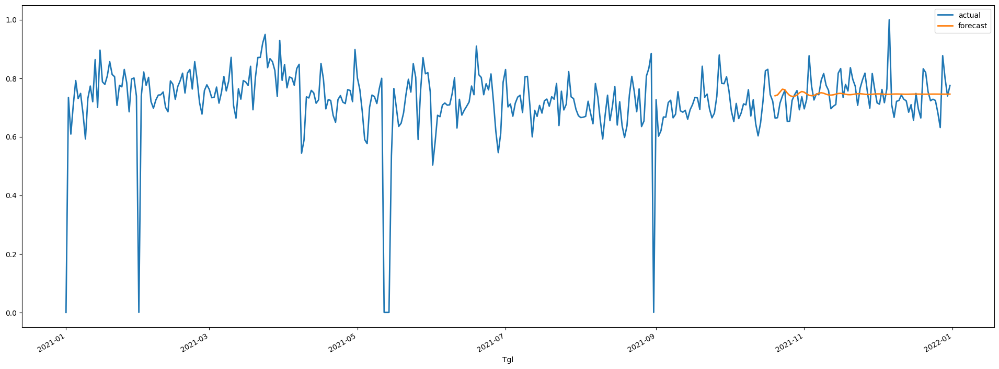

In [ ]:
# prediction for Material1
mpl.style.use('default')
pred = rnn_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

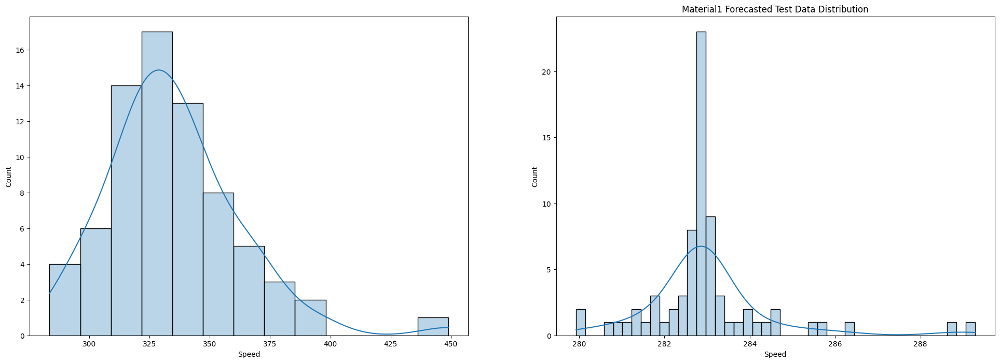

In [ ]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_speed_Material1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)

# plot forecasted test data
sns.histplot(pred_Material1['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.212
MAE = 0.167
MSE = 0.045
SMAPE = 29.89
OPE = 10.404%


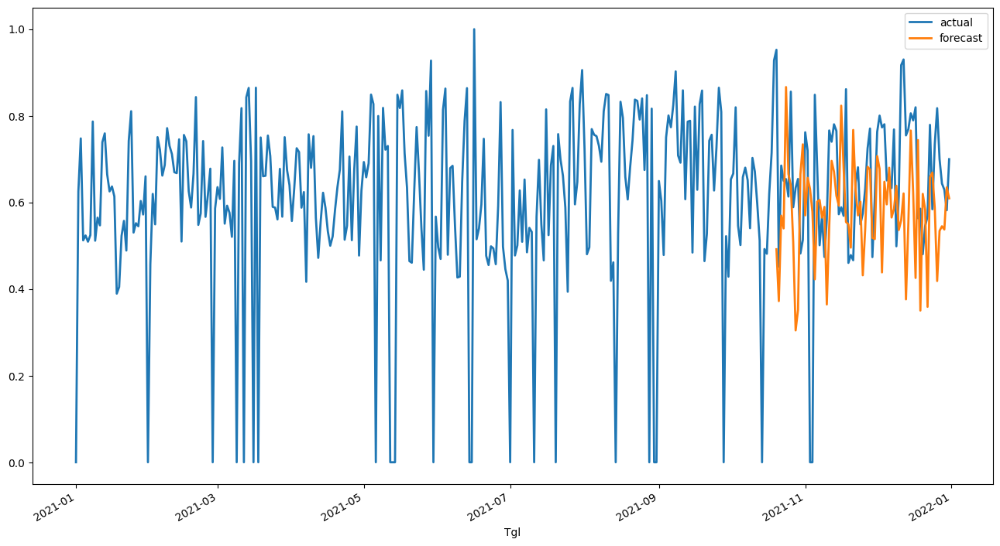

In [ ]:
# prediction for Material2
pred = rnn_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

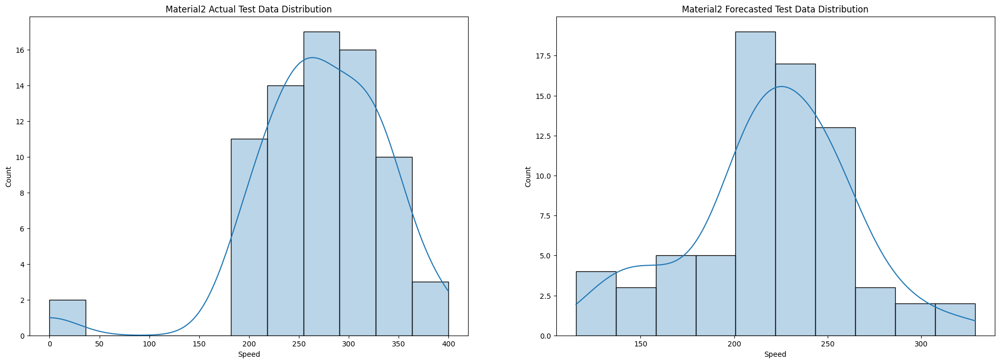

In [ ]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_speed_Material2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material2['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.186
MAE = 0.150
MSE = 0.035
SMAPE = 23.99
OPE = 5.938%


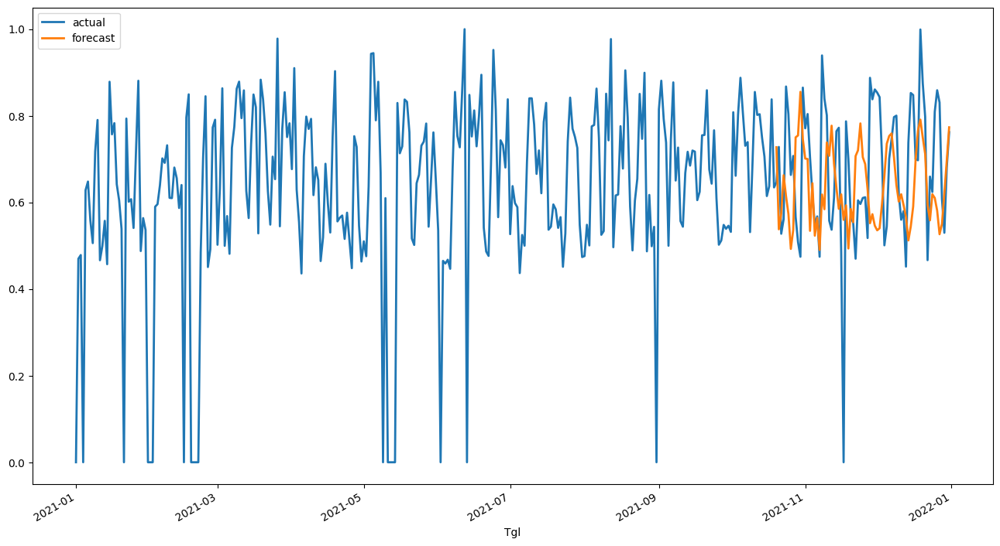

In [ ]:
# prediction for Material3
pred = rnn_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Material3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

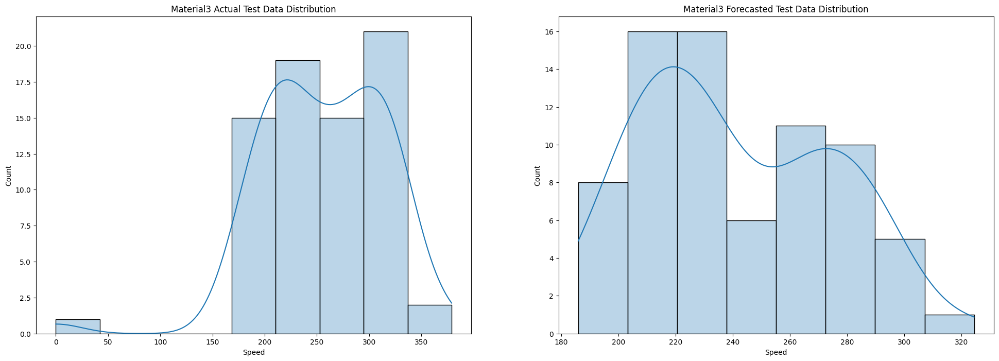

In [ ]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_speed_Material3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material3['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Speed by Machine with RNN**

In [ ]:
Machine1 = run[run['KdMesin']=='Machine1'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = run[run['KdMesin']=='Machine2'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = run[run['KdMesin']=='Machine3'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = run[run['KdMesin']=='Machine5'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = run[run['KdMesin']=='Machine6'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = run[run['KdMesin']=='Machine7'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by machine
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Speed')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Speed')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Speed')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Speed')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Speed')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Speed')

In [ ]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 5.0
Machine1_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 4.0
Machine2_periodicity (~months) : 0.1


In [ ]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 16.0
Machine3_periodicity (~months) : 0.5


In [ ]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 6.0
Machine5_periodicity (~months) : 0.2


In [ ]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 11.0
Machine6_periodicity (~months) : 0.4


In [ ]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 7.0
Machine7_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [ ]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]

In [ ]:
# defining and training the model for Machine1
rnn_Machine1= RNNModel(
    model="RNN",
    input_chunk_length=Machine1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine2
rnn_Machine2= RNNModel(
    model="RNN",
    input_chunk_length=Machine2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine3
rnn_Machine3= RNNModel(
    model="RNN",
    input_chunk_length=Machine3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine5
rnn_Machine5= RNNModel(
    model="RNN",
    input_chunk_length=Machine5_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine5.fit(train_Machine5)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine6
rnn_Machine6= RNNModel(
    model="RNN",
    input_chunk_length=Machine6_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine6.fit(train_Machine6)

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for Machine7
rnn_Machine7= RNNModel(
    model="RNN",
    input_chunk_length=Machine7_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine7.fit(train_Machine7)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.078
MAE = 0.069
MSE = 0.006
SMAPE = 8.466
OPE = 7.969%


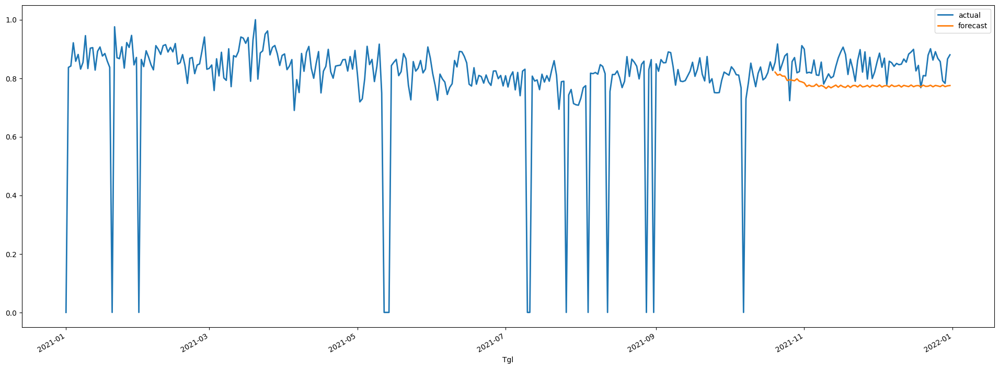

In [ ]:
# prediction for Machine1
mpl.style.use('default')
pred = rnn_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

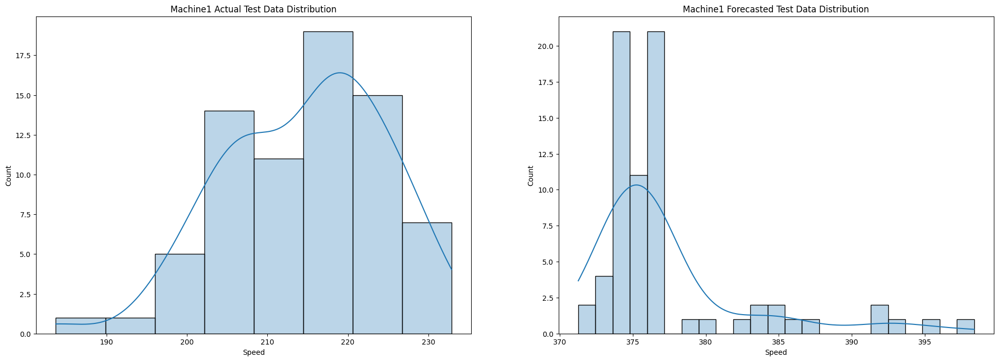

In [ ]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_speed_Machine1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.048
MAE = 0.038
MSE = 0.002
SMAPE = 4.65
OPE = 0.820%


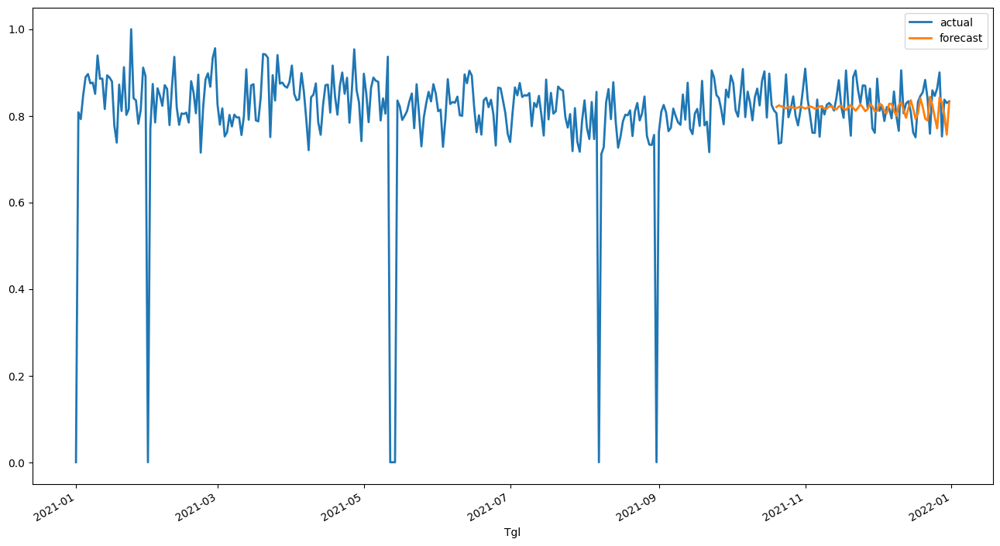

In [ ]:
# prediction for Machine2
pred = rnn_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

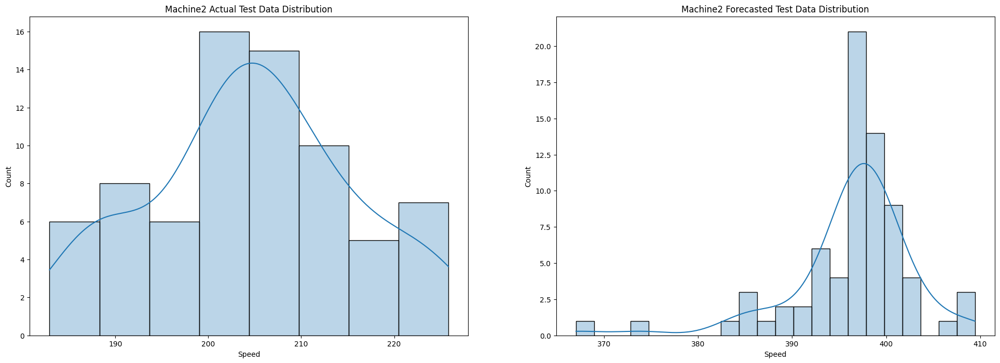

In [ ]:
# normal distribution for Machine2
mpl.style.use('default')

pred_Machine2 = pd.read_csv('/content/pred_speed_Machine2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.100
MAE = 0.085
MSE = 0.010
SMAPE = 10.37
OPE = 7.490%


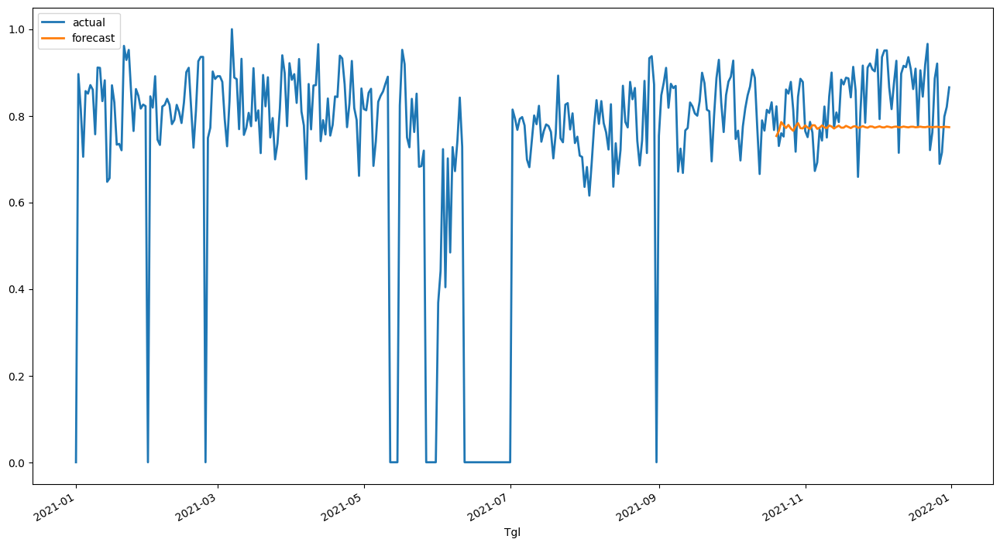

In [ ]:
# prediction for Machine3
pred = rnn_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

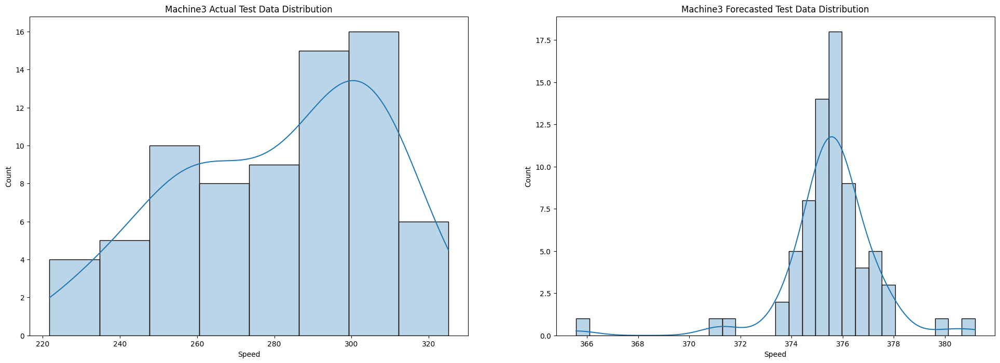

In [ ]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_speed_Machine3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.035
MAE = 0.027
MSE = 0.001
SMAPE = 3.27
OPE = 1.566%


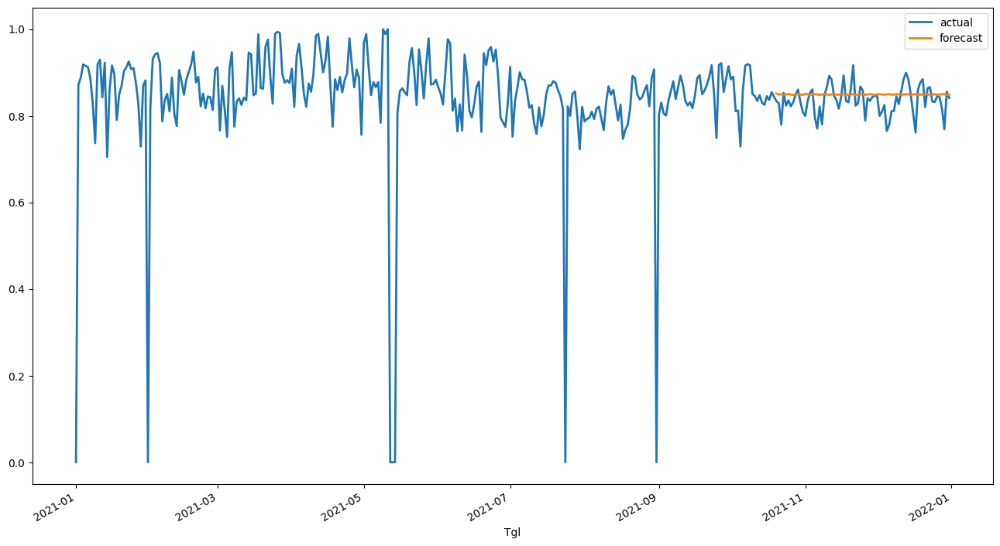

In [ ]:
# prediction for Machine5
pred = rnn_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine5_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

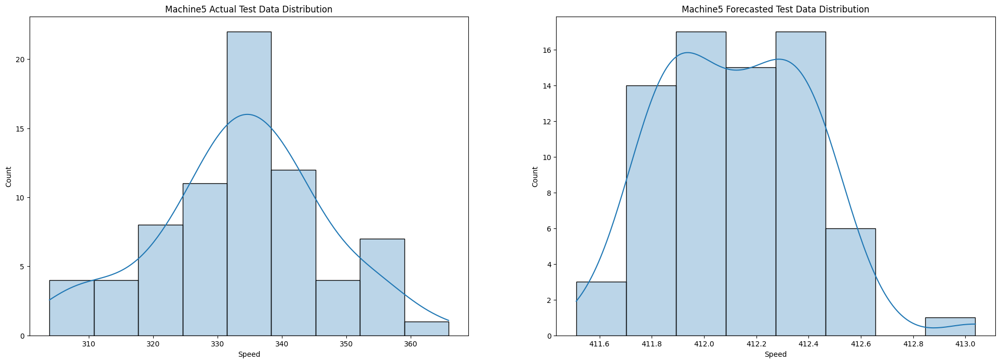

In [ ]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_speed_Machine5_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.233
MAE = 0.130
MSE = 0.054
SMAPE = 25.52
OPE = 4.679%


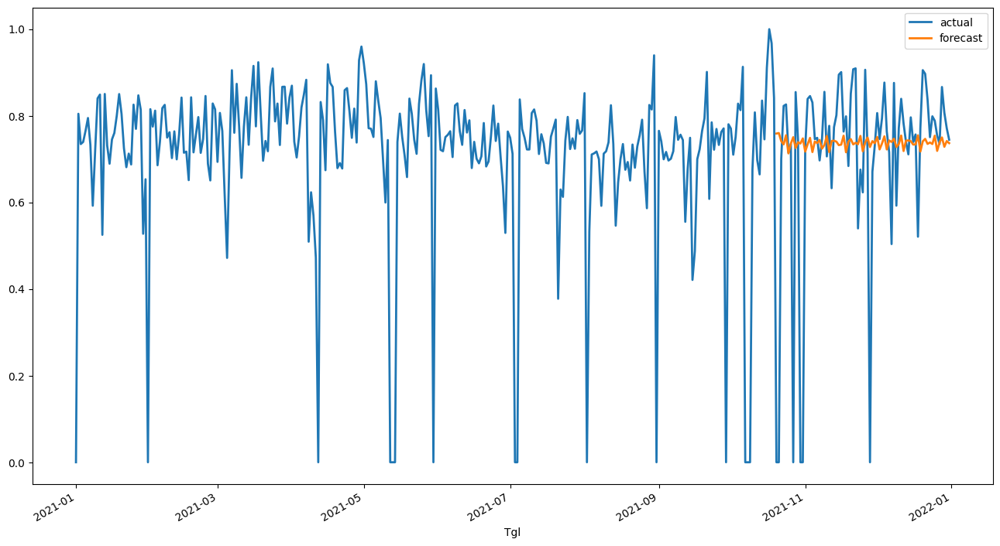

In [ ]:
# prediction for Machine6
pred = rnn_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine6_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

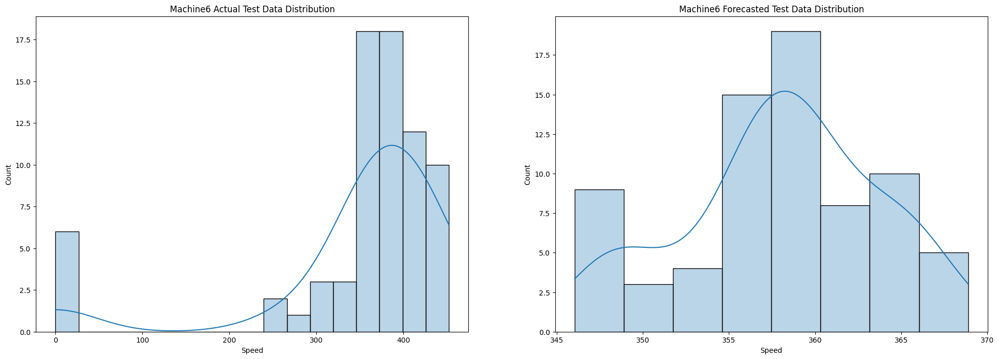

In [ ]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_speed_Machine6_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.078
MAE = 0.065
MSE = 0.006
SMAPE = 7.39
OPE = 4.416%


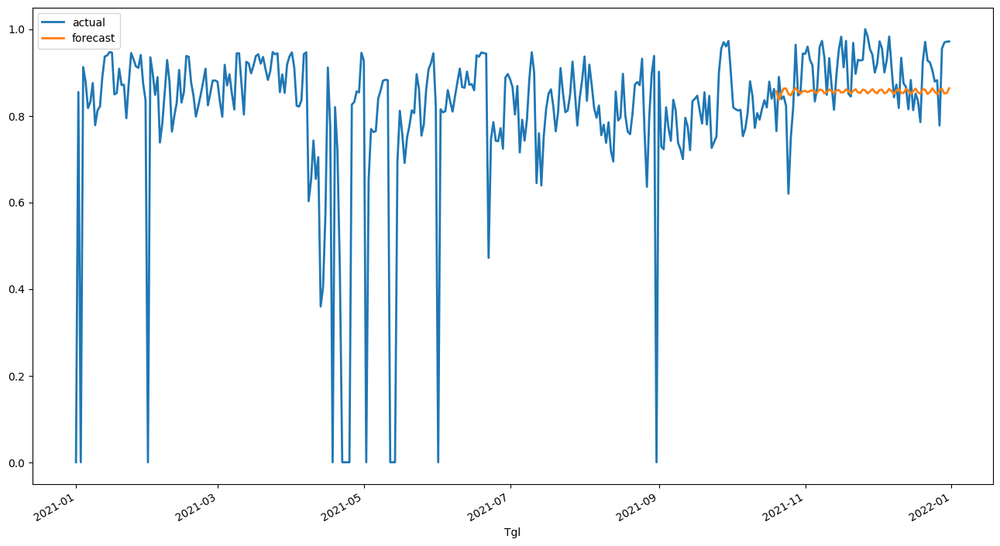

In [ ]:
# prediction for Machine7
pred = rnn_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_Machine7_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

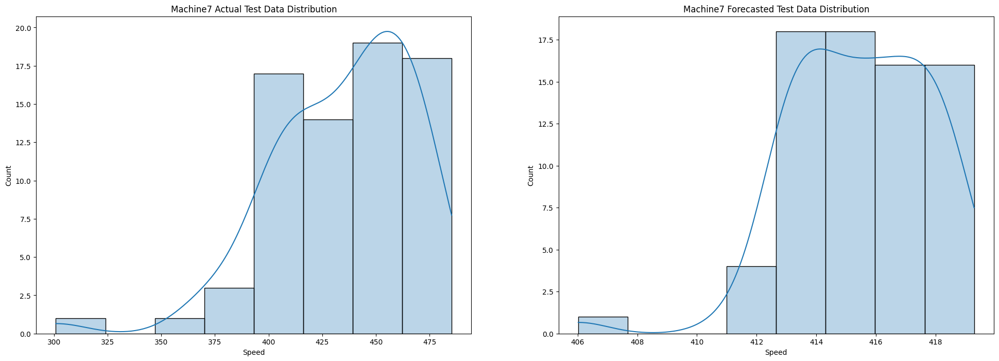

In [ ]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_speed_Machine7_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Output Data with RNN**



### **Forecasting Daily Output by Material with RNN**

In [212]:
op = run.pivot_table(values='Speed',index=['Tgl','OrderID','KdMesin','FILM'],aggfunc='mean').reset_index().rename_axis(None, axis=1)
op['Speed'] = op['Speed'].round(0).astype(int)
op['RunTime'] = run.groupby(['Tgl','OrderID','KdMesin','FILM'])['RunTime'].sum().reset_index().drop(columns=['Tgl','OrderID','KdMesin','FILM'])
op['Output'] = (op['RunTime'] * op['Speed']).astype(int)
op.drop(op[(op['FILM']=='Material4')|(op['FILM']=='Material5')|(op['FILM']=='Material6')|(op['FILM']=='OTHER')].index, inplace=True)

op_all = op.pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
op_all = op_all.reindex(idx, fill_value=0).reset_index()

In [213]:
Material1 = op[op['FILM']=='Material1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = op[op['FILM']=='Material2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = op[op['FILM']=='Material3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [214]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Output')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Output')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Output')

In [215]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 7.0
Material1_periodicity (~months) : 0.2


In [216]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 7.0
Material2_periodicity (~months) : 0.2


In [217]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 10.0
Material3_periodicity (~months) : 0.3


In [218]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [219]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]

In [220]:
# defining and training the model for Material1
rnn_Material1= RNNModel(
    model="RNN",
    input_chunk_length=Material1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material1.fit(train_Material1)

Training: 0it [00:00, ?it/s]

In [221]:
# defining and training the model for Material2
rnn_Material2= RNNModel(
    model="RNN",
    input_chunk_length=Material2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material2.fit(train_Material2)

Training: 0it [00:00, ?it/s]

In [222]:
# defining and training the model for Material3
rnn_Material3= RNNModel(
    model="RNN",
    input_chunk_length=Material3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material3.fit(train_Material3)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.148
MAE = 0.118
MSE = 0.022
SMAPE = 22.537
OPE = 9.682%


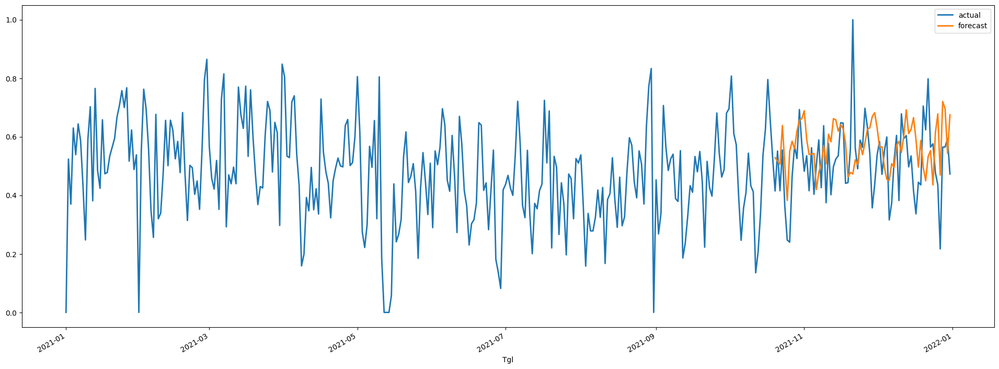

In [223]:
# prediction for Material1
mpl.style.use('default')
pred = rnn_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

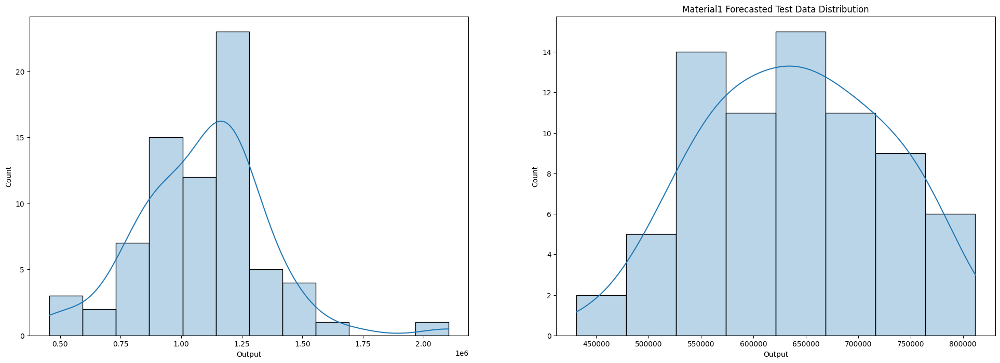

In [224]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_op_Material1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)

# plot forecasted test data
sns.histplot(pred_Material1['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.274
MAE = 0.199
MSE = 0.075
SMAPE = 92.91
OPE = 63.553%


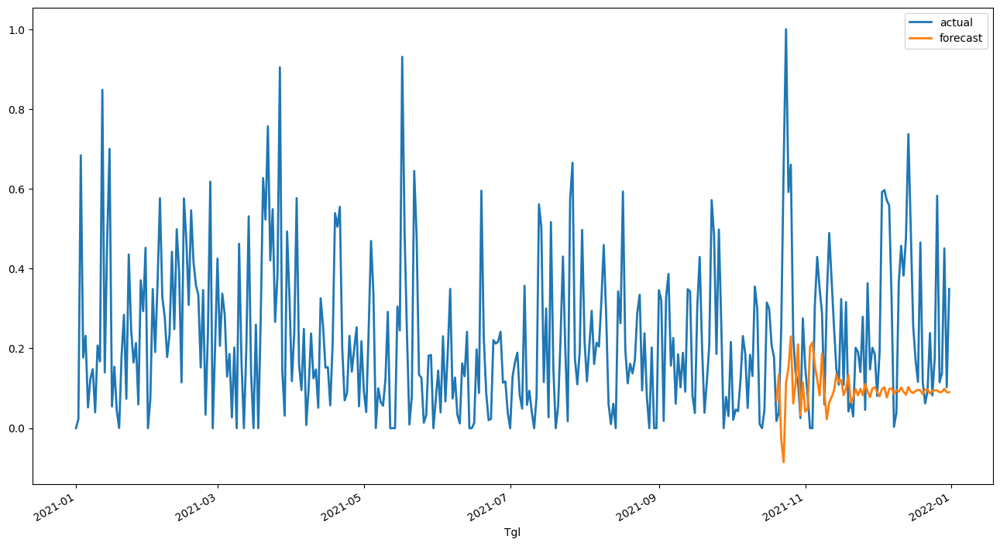

In [225]:
# prediction for Material2
pred = rnn_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

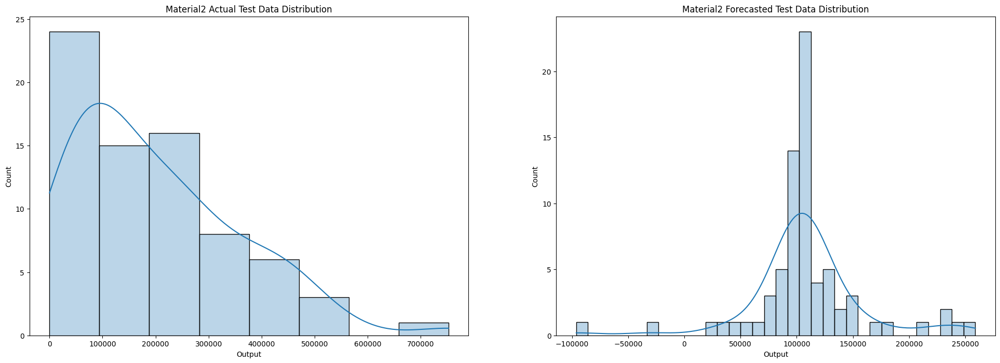

In [226]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_op_Material2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material2['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.212
MAE = 0.167
MSE = 0.045
SMAPE = 81.80
OPE = 2.224%


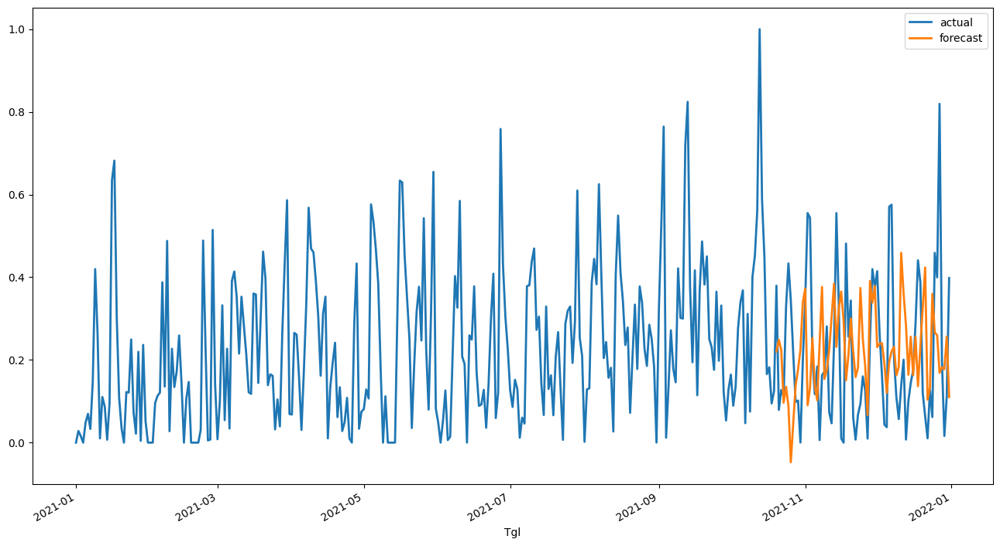

In [227]:
# prediction for Material3
pred = rnn_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Material3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

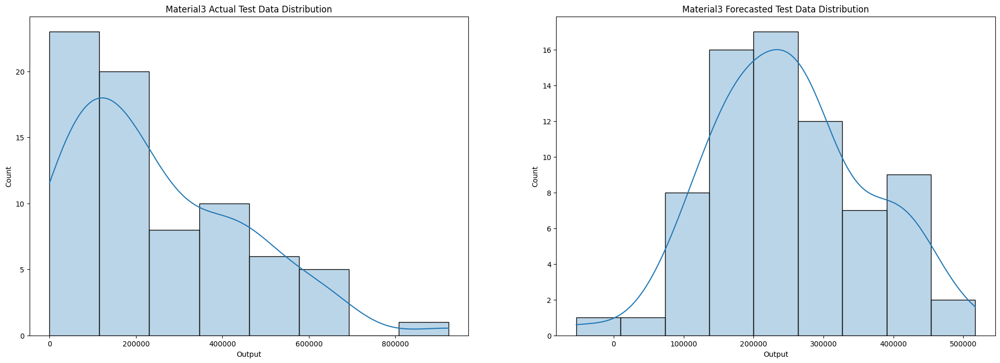

In [228]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_op_Material3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Material3['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Output by Machine with RNN**

In [229]:
Machine1 = op[op['KdMesin']=='Machine1'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = op[op['KdMesin']=='Machine2'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = op[op['KdMesin']=='Machine3'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = op[op['KdMesin']=='Machine5'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = op[op['KdMesin']=='Machine6'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = op[op['KdMesin']=='Machine7'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [230]:
# defining time series by machine
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Output')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Output')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Output')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Output')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Output')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Output')

In [231]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 4.0
Machine1_periodicity (~months) : 0.1


In [232]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 7.0
Machine2_periodicity (~months) : 0.2


In [233]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 6.0
Machine3_periodicity (~months) : 0.2


In [234]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 3.0
Machine5_periodicity (~months) : 0.1


In [235]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 8.0
Machine6_periodicity (~months) : 0.3


In [236]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 6.0
Machine7_periodicity (~months) : 0.2


In [237]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [238]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]

In [239]:
# defining and training the model for Machine1
rnn_Machine1= RNNModel(
    model="RNN",
    input_chunk_length=Machine1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [240]:
# defining and training the model for Machine2
rnn_Machine2= RNNModel(
    model="RNN",
    input_chunk_length=Machine2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [241]:
# defining and training the model for Machine3
rnn_Machine3= RNNModel(
    model="RNN",
    input_chunk_length=Machine3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [242]:
# defining and training the model for Machine5
rnn_Machine5= RNNModel(
    model="RNN",
    input_chunk_length=Machine5_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine5.fit(train_Machine5)

Training: 0it [00:00, ?it/s]

In [243]:
# defining and training the model for Machine6
rnn_Machine6= RNNModel(
    model="RNN",
    input_chunk_length=Machine6_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine6.fit(train_Machine6)

Training: 0it [00:00, ?it/s]

In [244]:
# defining and training the model for Machine7
rnn_Machine7= RNNModel(
    model="RNN",
    input_chunk_length=Machine7_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine7.fit(train_Machine7)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.246
MAE = 0.197
MSE = 0.061
SMAPE = 35.595
OPE = 14.160%


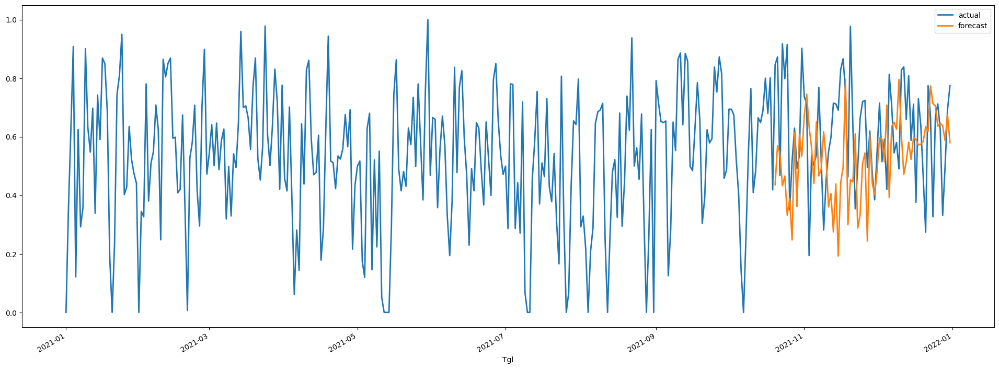

In [245]:
# prediction for Machine1
mpl.style.use('default')
pred = rnn_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

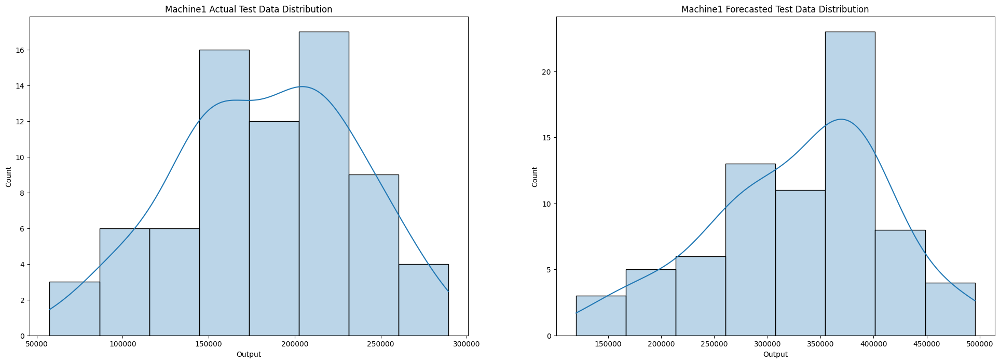

In [246]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_op_Machine1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.170
MAE = 0.129
MSE = 0.029
SMAPE = 31.56
OPE = 5.089%


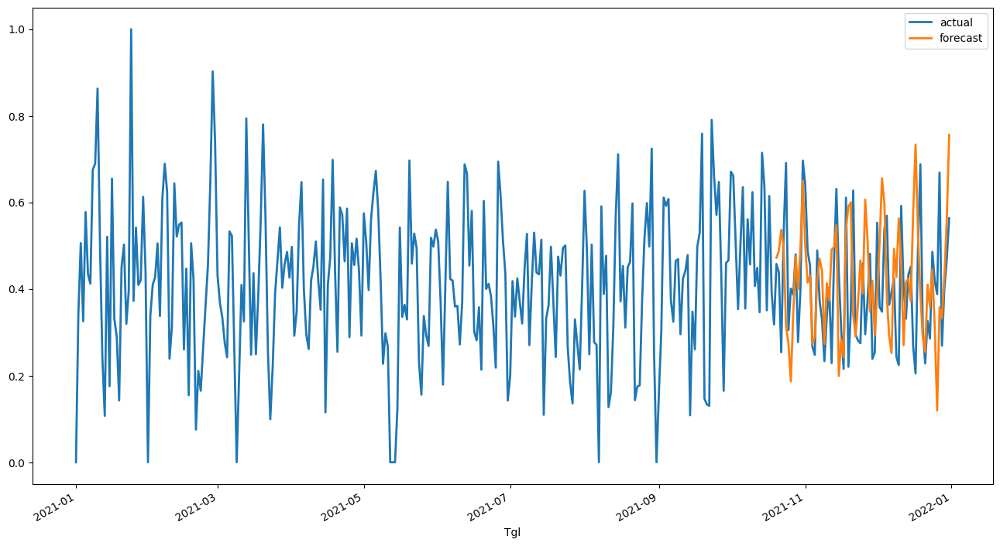

In [247]:
# prediction for Machine2
pred = rnn_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

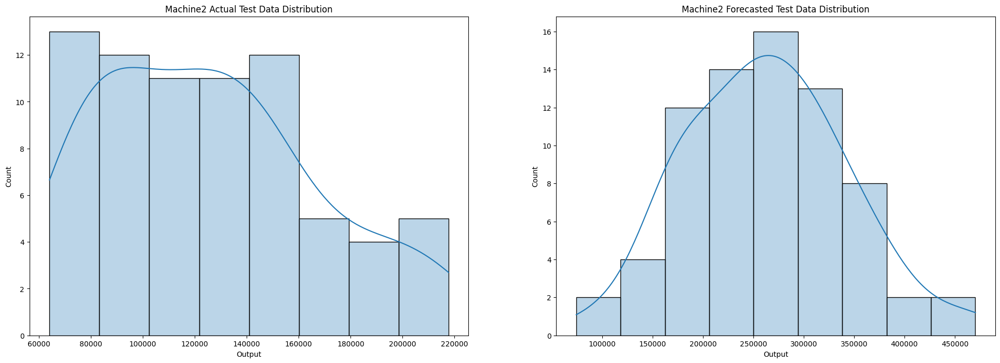

In [248]:
# normal distribution for Machine2
mpl.style.use('default')

pred_Machine2 = pd.read_csv('/content/pred_op_Machine2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.220
MAE = 0.187
MSE = 0.048
SMAPE = 36.21
OPE = 18.648%


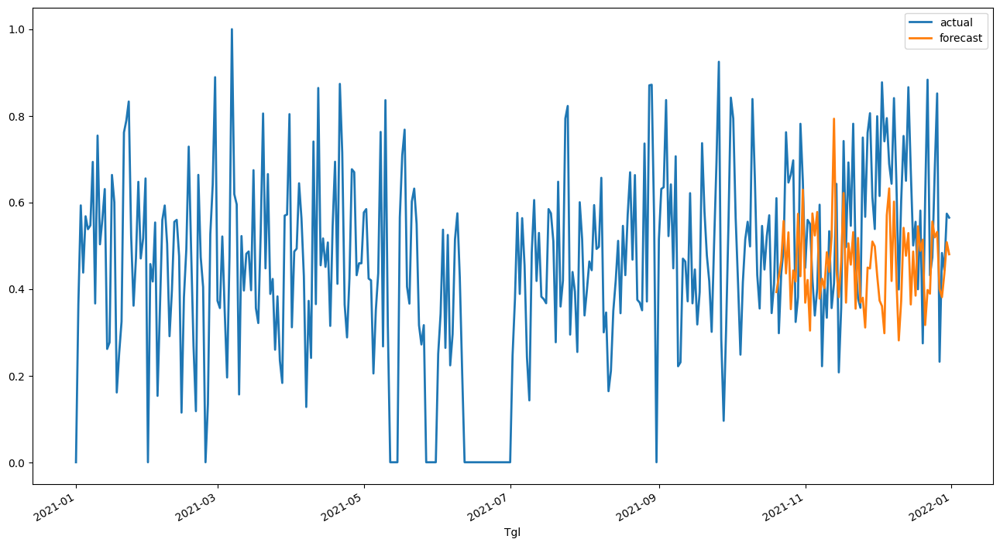

In [249]:
# prediction for Machine3
pred = rnn_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

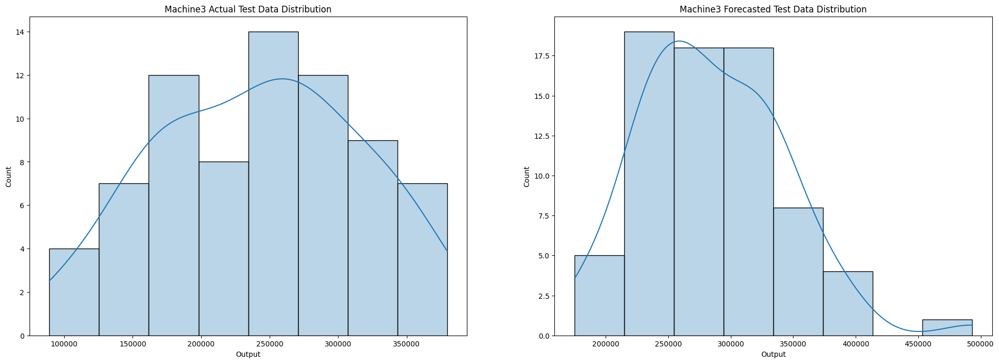

In [250]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_op_Machine3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.135
MAE = 0.105
MSE = 0.018
SMAPE = 16.52
OPE = 3.670%


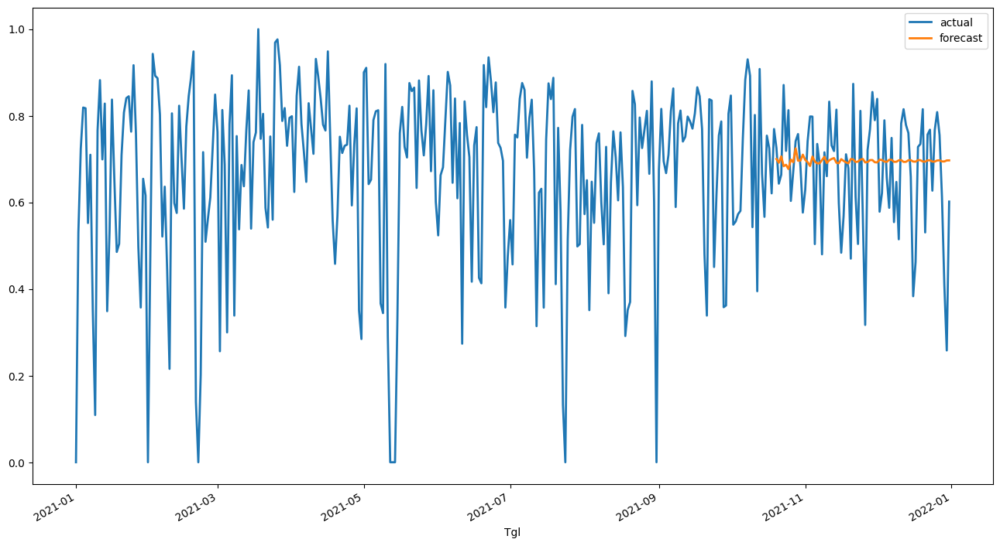

In [251]:
# prediction for Machine5
pred = rnn_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine5_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

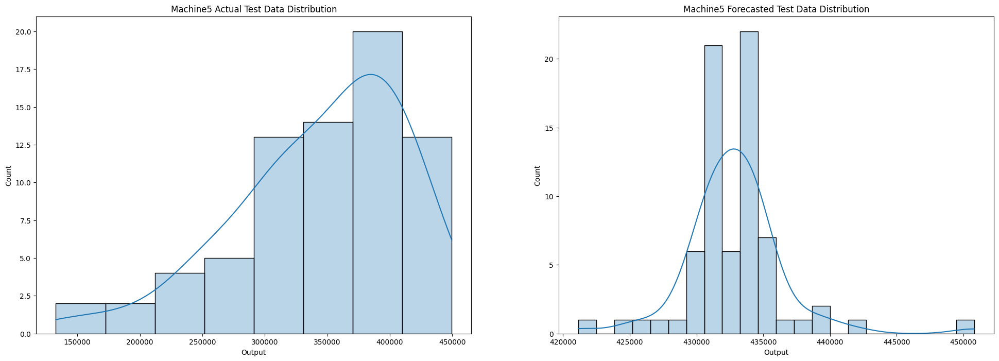

In [252]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_op_Machine5_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.229
MAE = 0.190
MSE = 0.053
SMAPE = 62.38
OPE = 17.845%


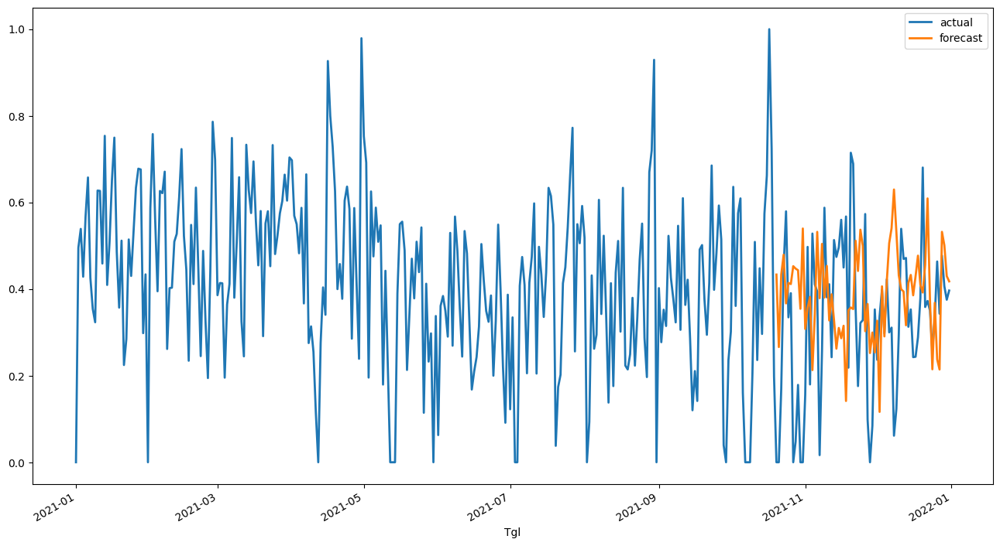

In [253]:
# prediction for Machine6
pred = rnn_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine6_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

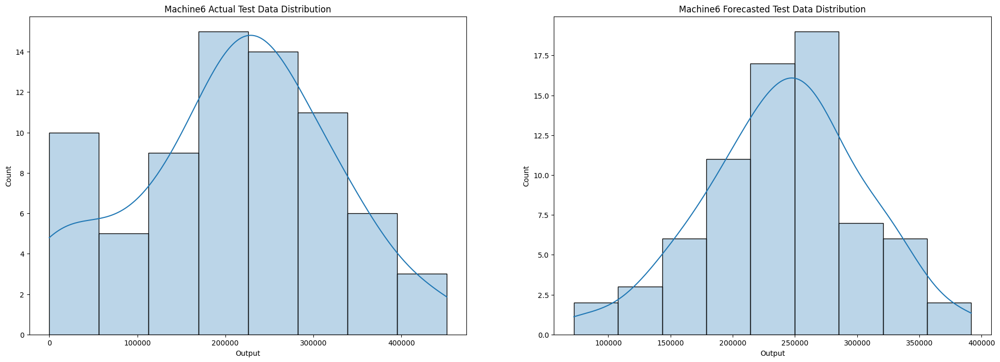

In [255]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_op_Machine6_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.164
MAE = 0.137
MSE = 0.027
SMAPE = 19.81
OPE = 1.347%


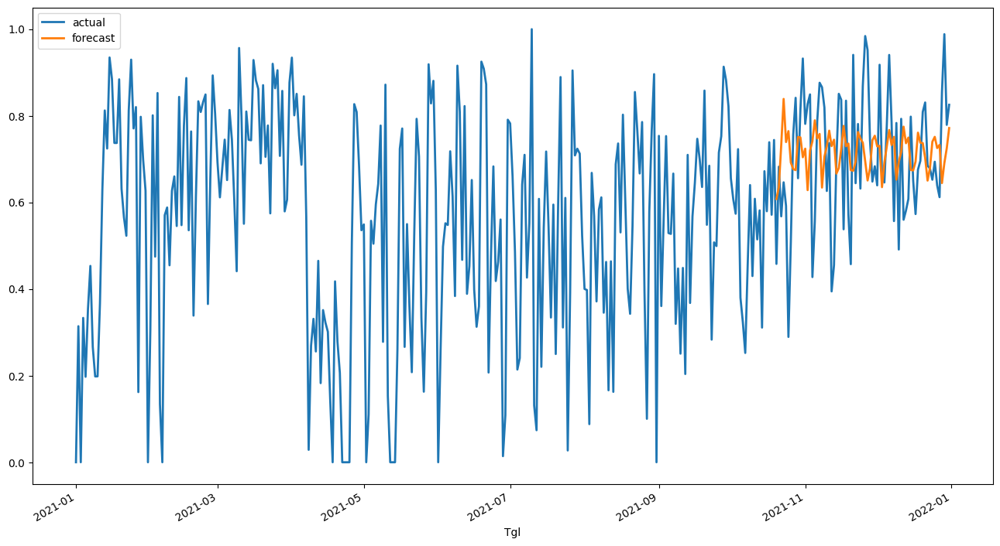

In [256]:
# prediction for Machine7
pred = rnn_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_Machine7_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

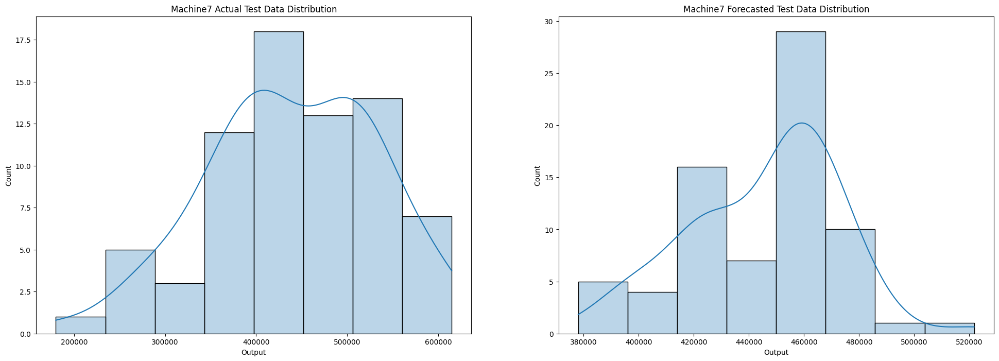

In [257]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_op_Machine7_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Downtime Data with RNN**


In [258]:
idx = pd.date_range('2021-01-01', '2021-12-31')
down_all = df[df['KodeBD']!='RUN'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
down_all = down_all.reindex(idx, fill_value=0).reset_index()

In [259]:
# defining time series
down_series = TimeSeries.from_dataframe(down_all, 'index','Downtime')

### **Forecasting Daily Downtime by Material With RNN**

In [260]:
Material1 = down[down['FILM']=='Material1'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material1 = Material1.reindex(idx, fill_value=0).reset_index()
Material2 = down[down['FILM']=='Material2'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material2 = Material2.reindex(idx, fill_value=0).reset_index()
Material3 = down[down['FILM']=='Material3'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Material3 = Material3.reindex(idx, fill_value=0).reset_index()

In [261]:
# defining time series by material
Material1_series = TimeSeries.from_dataframe(Material1, 'index','Downtime')
Material2_series = TimeSeries.from_dataframe(Material2, 'index','Downtime')
Material3_series = TimeSeries.from_dataframe(Material3, 'index','Downtime')

In [262]:
# check seasonality for Material1
is_seasonal, Material1_periodicity = check_seasonality(Material1_series, max_lag=240)
dict_seas ={
    "Material1 is seasonal?":is_seasonal,
    "Material1_periodicity (days)":f'{Material1_periodicity:.1f}', 
    "Material1_periodicity (~months)": f'{Material1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material1 is seasonal? : True
Material1_periodicity (days) : 6.0
Material1_periodicity (~months) : 0.2


In [263]:
# check seasonality for Material2
is_seasonal, Material2_periodicity = check_seasonality(Material2_series, max_lag=240)
dict_seas ={
    "Material2 is seasonal?":is_seasonal,
    "Material2_periodicity (days)":f'{Material2_periodicity:.1f}', 
    "Material2_periodicity (~months)": f'{Material2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material2 is seasonal? : True
Material2_periodicity (days) : 3.0
Material2_periodicity (~months) : 0.1


In [264]:
is_seasonal, Material3_periodicity = check_seasonality(Material3_series, max_lag=240)
dict_seas ={
    "Material3 is seasonal?":is_seasonal,
    "Material3_periodicity (days)":f'{Material3_periodicity:.1f}', 
    "Material3_periodicity (~months)": f'{Material3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Material3 is seasonal? : True
Material3_periodicity (days) : 4.0
Material3_periodicity (~months) : 0.1


In [265]:
# data normalization
scaler= Scaler()
series_Material1_scaled = scaler.fit_transform(Material1_series)
series_Material2_scaled = scaler.fit_transform(Material2_series)
series_Material3_scaled = scaler.fit_transform(Material3_series)

In [266]:
# train test split
train_Material1, val_Material1 = series_Material1_scaled[:-73], series_Material1_scaled[-73:]
train_Material2, val_Material2 = series_Material2_scaled[:-73], series_Material2_scaled[-73:]
train_Material3, val_Material3 = series_Material3_scaled[:-73], series_Material3_scaled[-73:]

In [267]:
# defining and training the model for Material1
rnn_Material1= RNNModel(
    model="RNN",
    input_chunk_length=Material1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material1.fit(train_Material1)

Training: 0it [00:00, ?it/s]

In [268]:
# defining and training the model for Material2
rnn_Material2= RNNModel(
    model="RNN",
    input_chunk_length=Material2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material2.fit(train_Material2)

Training: 0it [00:00, ?it/s]

In [269]:
# defining and training the model for Material3
rnn_Material3= RNNModel(
    model="RNN",
    input_chunk_length=Material3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Material3.fit(train_Material3)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.208
MAE = 0.166
MSE = 0.043
SMAPE = 34.858
OPE = 20.257%


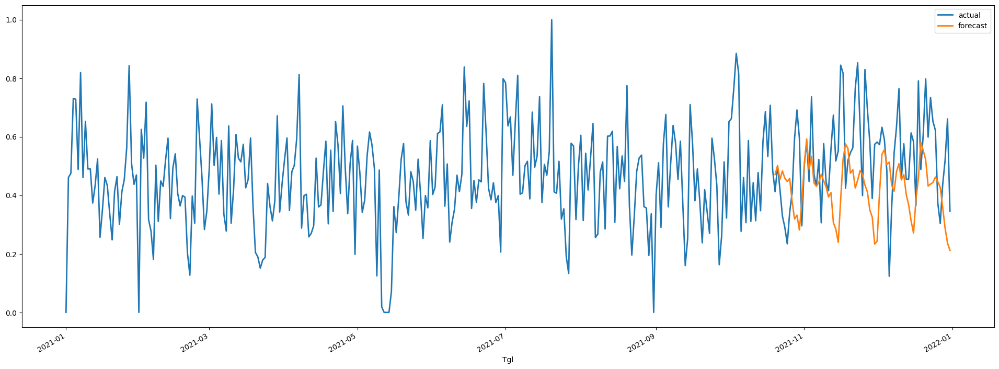

In [270]:
# prediction for Material1
mpl.style.use('default')
pred = rnn_Material1.predict(n=73, series=train_Material1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Material1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Material1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material1_scaled, pred)))

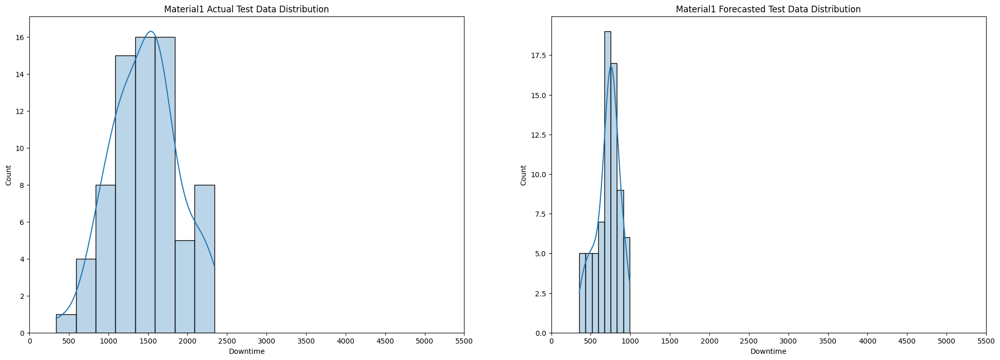

In [271]:
# normal distribution for Material1
pred_Material1 = pd.read_csv('/content/pred_down_Material1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material1 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_Material1['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material1 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.263
MAE = 0.197
MSE = 0.069
SMAPE = 84.06
OPE = 25.507%


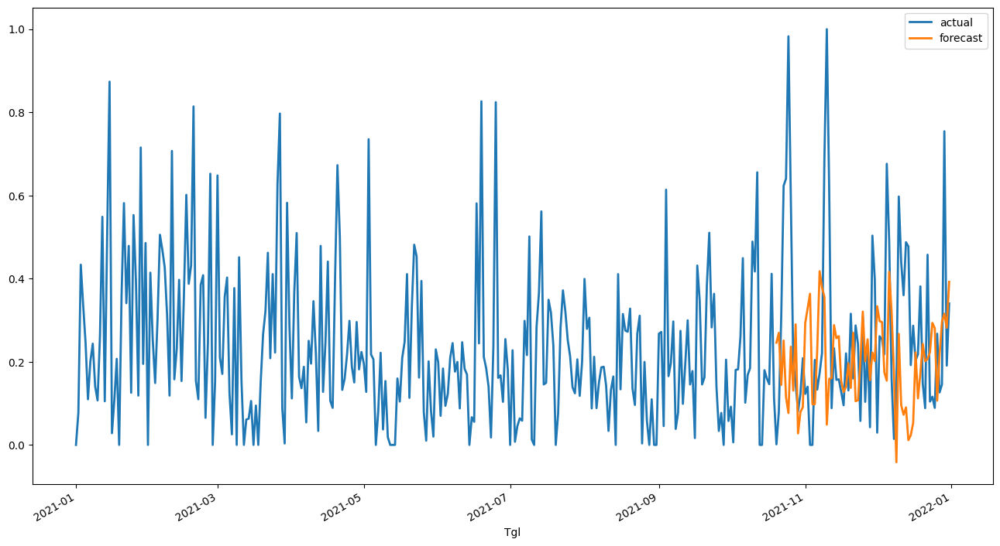

In [272]:
# prediction for Material2
pred = rnn_Material2.predict(n=73, series=train_Material2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material2_scaled, pred)))

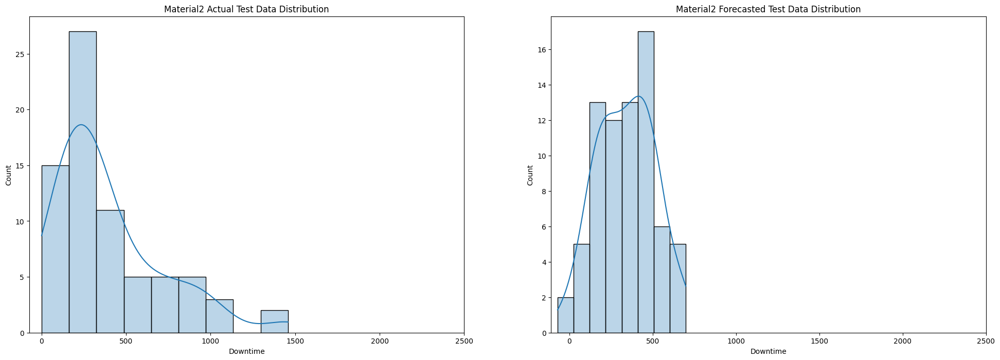

In [273]:
# normal distribution for Material2
mpl.style.use('default')

pred_Material2 = pd.read_csv('/content/pred_down_Material2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material2 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material2['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material2 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.177
MAE = 0.140
MSE = 0.031
SMAPE = 61.38
OPE = 2.075%


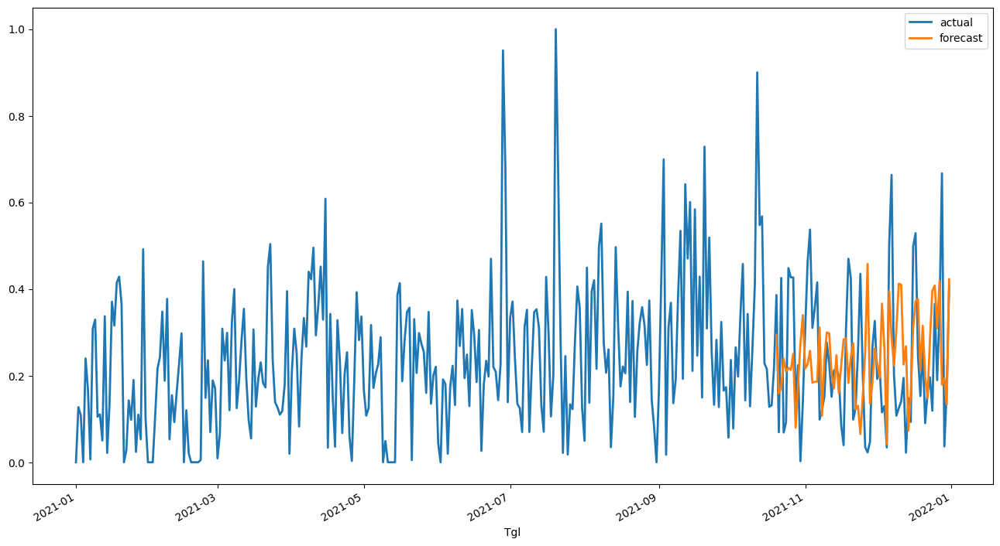

In [274]:
# prediction for Material3
pred = rnn_Material3.predict(n=73, series=train_Material3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Material3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Material3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Material3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Material3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Material3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Material3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Material3_scaled, pred)))

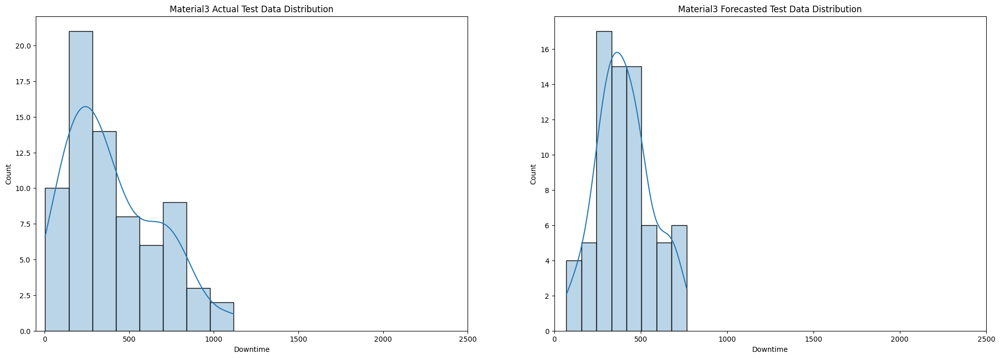

In [275]:
# normal distribution for Material3

pred_Material3 = pd.read_csv('/content/pred_down_Material3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Material3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Material3 Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_Material3['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Material3 Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With RNN**

In [276]:
Machine1 = down[down['KdMesin']=='Machine1'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine1 = Machine1.reindex(idx, fill_value=0).reset_index()
Machine2 = down[down['KdMesin']=='Machine2'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine2 = Machine2.reindex(idx, fill_value=0).reset_index()
Machine3 = down[down['KdMesin']=='Machine3'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine3 = Machine3.reindex(idx, fill_value=0).reset_index()
Machine5 = down[down['KdMesin']=='Machine5'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine5 = Machine5.reindex(idx, fill_value=0).reset_index()
Machine6 = down[down['KdMesin']=='Machine6'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine6 = Machine6.reindex(idx, fill_value=0).reset_index()
Machine7 = down[down['KdMesin']=='Machine7'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
Machine7 = Machine7.reindex(idx, fill_value=0).reset_index()

In [277]:
# defining time series by machine
Machine1_series = TimeSeries.from_dataframe(Machine1, 'index','Downtime')
Machine2_series = TimeSeries.from_dataframe(Machine2, 'index','Downtime')
Machine3_series = TimeSeries.from_dataframe(Machine3, 'index','Downtime')
Machine5_series = TimeSeries.from_dataframe(Machine5, 'index','Downtime')
Machine6_series = TimeSeries.from_dataframe(Machine6, 'index','Downtime')
Machine7_series = TimeSeries.from_dataframe(Machine7, 'index','Downtime')

In [278]:
# check seasonality for Machine1
is_seasonal, Machine1_periodicity = check_seasonality(Machine1_series, max_lag=240)
dict_seas ={
    "Machine1 is seasonal?":is_seasonal,
    "Machine1_periodicity (days)":f'{Machine1_periodicity:.1f}', 
    "Machine1_periodicity (~months)": f'{Machine1_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine1 is seasonal? : True
Machine1_periodicity (days) : 4.0
Machine1_periodicity (~months) : 0.1


In [279]:
# check seasonality for Machine2
is_seasonal, Machine2_periodicity = check_seasonality(Machine2_series, max_lag=240)
dict_seas ={
    "Machine2 is seasonal?":is_seasonal,
    "Machine2_periodicity (days)":f'{Machine2_periodicity:.1f}', 
    "Machine2_periodicity (~months)": f'{Machine2_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine2 is seasonal? : True
Machine2_periodicity (days) : 3.0
Machine2_periodicity (~months) : 0.1


In [280]:
# check seasonality for Machine3
is_seasonal, Machine3_periodicity = check_seasonality(Machine3_series, max_lag=240)
dict_seas ={
    "Machine3 is seasonal?":is_seasonal,
    "Machine3_periodicity (days)":f'{Machine3_periodicity:.1f}', 
    "Machine3_periodicity (~months)": f'{Machine3_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine3 is seasonal? : True
Machine3_periodicity (days) : 5.0
Machine3_periodicity (~months) : 0.2


In [281]:
# check seasonality for Machine5
is_seasonal, Machine5_periodicity = check_seasonality(Machine5_series, max_lag=240)
dict_seas ={
    "Machine5 is seasonal?":is_seasonal,
    "Machine5_periodicity (days)":f'{Machine5_periodicity:.1f}', 
    "Machine5_periodicity (~months)": f'{Machine5_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine5 is seasonal? : True
Machine5_periodicity (days) : 4.0
Machine5_periodicity (~months) : 0.1


In [282]:
# check seasonality for Machine6
is_seasonal, Machine6_periodicity = check_seasonality(Machine6_series, max_lag=240)
dict_seas ={
    "Machine6 is seasonal?":is_seasonal,
    "Machine6_periodicity (days)":f'{Machine6_periodicity:.1f}', 
    "Machine6_periodicity (~months)": f'{Machine6_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine6 is seasonal? : True
Machine6_periodicity (days) : 6.0
Machine6_periodicity (~months) : 0.2


In [283]:
# check seasonality for Machine7
is_seasonal, Machine7_periodicity = check_seasonality(Machine7_series, max_lag=240)
dict_seas ={
    "Machine7 is seasonal?":is_seasonal,
    "Machine7_periodicity (days)":f'{Machine7_periodicity:.1f}', 
    "Machine7_periodicity (~months)": f'{Machine7_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

Machine7 is seasonal? : True
Machine7_periodicity (days) : 4.0
Machine7_periodicity (~months) : 0.1


In [284]:
# data normalization
scaler= Scaler()
series_Machine1_scaled = scaler.fit_transform(Machine1_series)
series_Machine2_scaled = scaler.fit_transform(Machine2_series)
series_Machine3_scaled = scaler.fit_transform(Machine3_series)
series_Machine5_scaled = scaler.fit_transform(Machine5_series)
series_Machine6_scaled = scaler.fit_transform(Machine6_series)
series_Machine7_scaled = scaler.fit_transform(Machine7_series)

In [285]:
# train test split
train_Machine1, val_Machine1 = series_Machine1_scaled[:-73], series_Machine1_scaled[-73:]
train_Machine2, val_Machine2 = series_Machine2_scaled[:-73], series_Machine2_scaled[-73:]
train_Machine3, val_Machine3 = series_Machine3_scaled[:-73], series_Machine3_scaled[-73:]
train_Machine5, val_Machine5 = series_Machine5_scaled[:-73], series_Machine5_scaled[-73:]
train_Machine6, val_Machine6 = series_Machine6_scaled[:-73], series_Machine6_scaled[-73:]
train_Machine7, val_Machine7 = series_Machine7_scaled[:-73], series_Machine7_scaled[-73:]

In [286]:
# defining and training the model for Machine1
rnn_Machine1= RNNModel(
    model="RNN",
    input_chunk_length=Machine1_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine1.fit(train_Machine1)

Training: 0it [00:00, ?it/s]

In [287]:
# defining and training the model for Machine2
rnn_Machine2= RNNModel(
    model="RNN",
    input_chunk_length=Machine2_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine2.fit(train_Machine2)

Training: 0it [00:00, ?it/s]

In [288]:
# defining and training the model for Machine3
rnn_Machine3= RNNModel(
    model="RNN",
    input_chunk_length=Machine3_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine3.fit(train_Machine3)

Training: 0it [00:00, ?it/s]

In [289]:
# defining and training the model for Machine5
rnn_Machine5= RNNModel(
    model="RNN",
    input_chunk_length=Machine5_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine5.fit(train_Machine5)

Training: 0it [00:00, ?it/s]

In [290]:
# defining and training the model for Machine6
rnn_Machine6= RNNModel(
    model="RNN",
    input_chunk_length=Machine6_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine6.fit(train_Machine6)

Training: 0it [00:00, ?it/s]

In [291]:
# defining and training the model for Machine7
rnn_Machine7= RNNModel(
    model="RNN",
    input_chunk_length=Machine7_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_Machine7.fit(train_Machine7)

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.122
MAE = 0.095
MSE = 0.015
SMAPE = 31.674
OPE = 3.578%


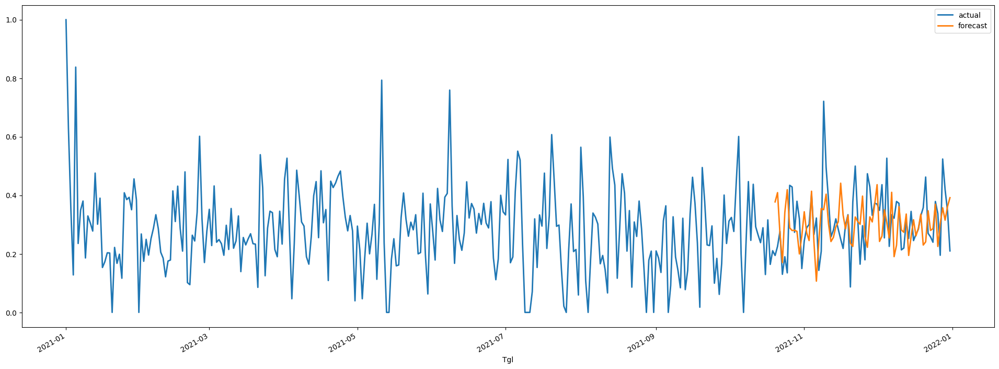

In [292]:
# prediction for Machine1
mpl.style.use('default')
pred = rnn_Machine1.predict(n=73, series=train_Machine1)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine1_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_Machine1_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine1_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine1_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine1_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_Machine1_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine1_scaled, pred)))

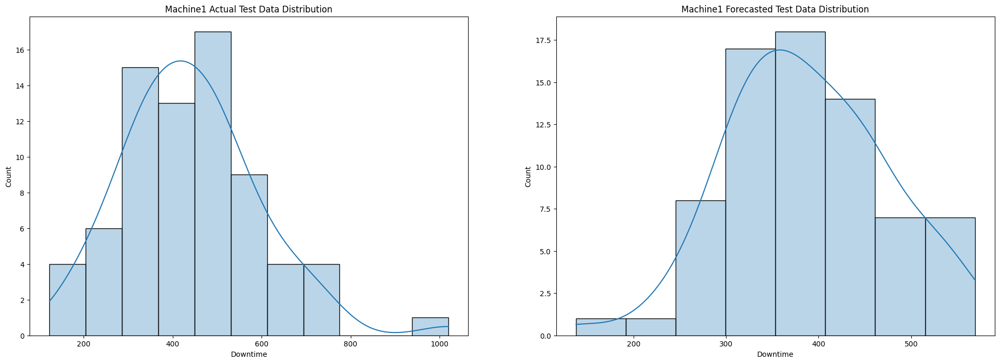

In [293]:
# normal distribution for Machine1
pred_Machine1 = pd.read_csv('/content/pred_down_Machine1_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine1.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine1 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine1['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine1 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.142
MAE = 0.110
MSE = 0.020
SMAPE = 25.32
OPE = 13.657%


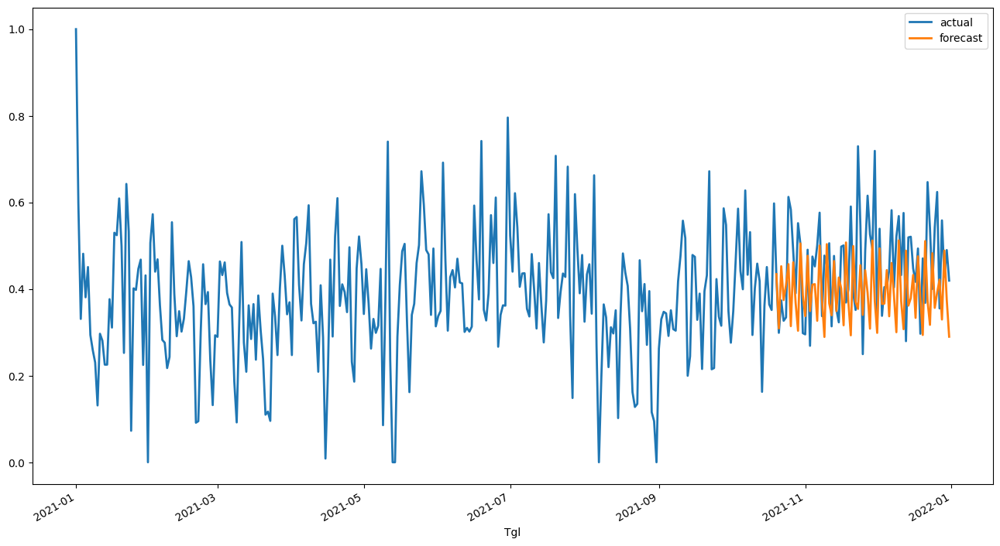

In [294]:
# prediction for Machine2
pred = rnn_Machine2.predict(n=73, series=train_Machine2)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine2_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine2_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine2_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine2_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine2_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine2_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine2_scaled, pred)))

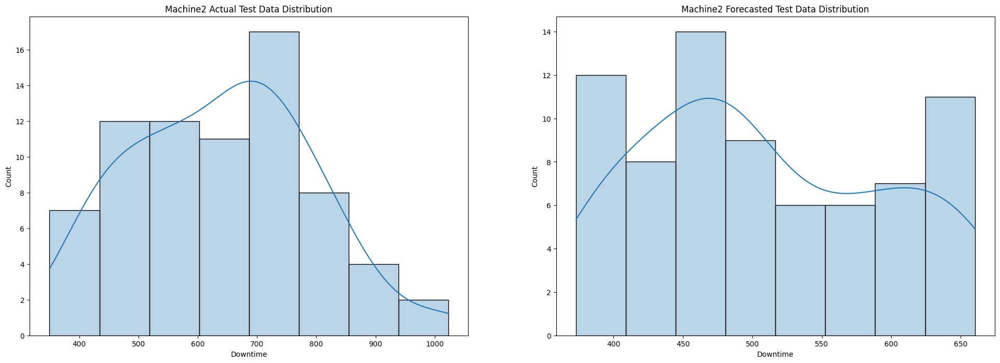

In [295]:
# normal distribution for Machine2

pred_Machine2 = pd.read_csv('/content/pred_down_Machine2_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine2.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine2 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine2['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine2 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.132
MAE = 0.104
MSE = 0.017
SMAPE = 31.67
OPE = 0.964%


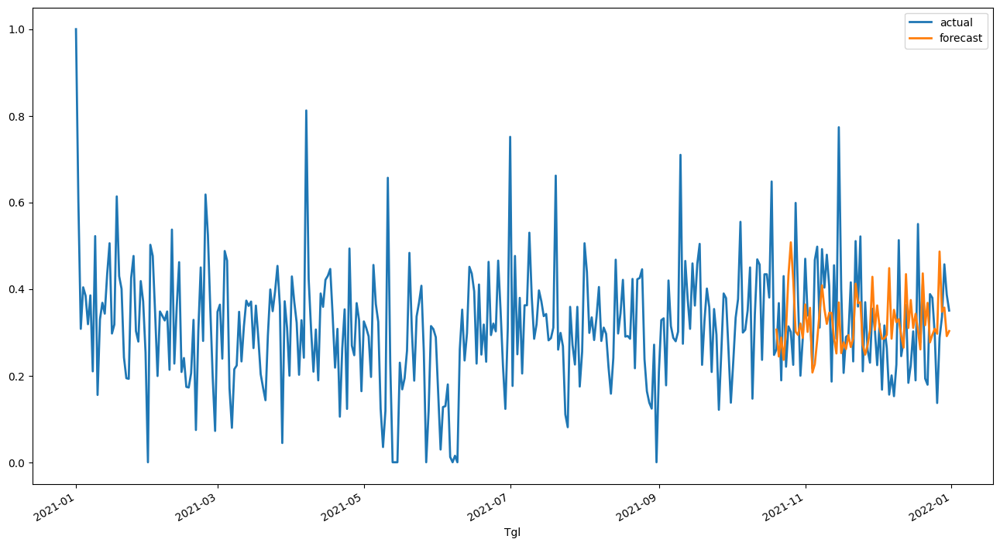

In [296]:
# prediction for Machine3
pred = rnn_Machine3.predict(n=73, series=train_Machine3)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine3_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine3_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine3_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine3_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine3_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine3_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine3_scaled, pred)))

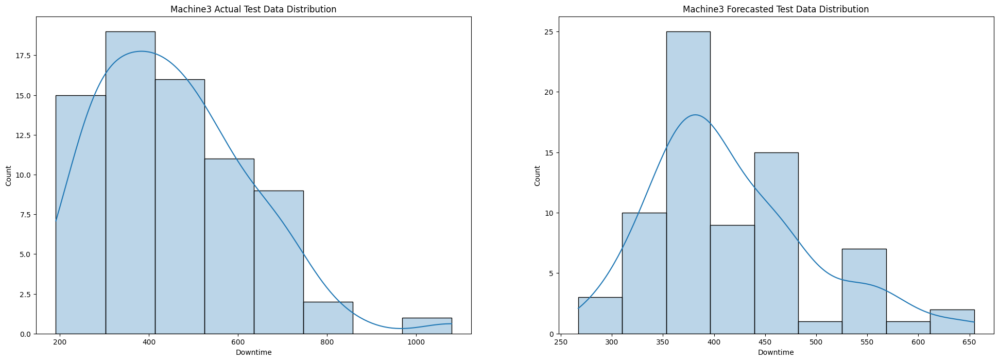

In [297]:
# normal distribution for Machine3

pred_Machine3 = pd.read_csv('/content/pred_down_Machine3_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine3.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine3 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine3['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine3 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.120
MAE = 0.089
MSE = 0.014
SMAPE = 40.81
OPE = 16.924%


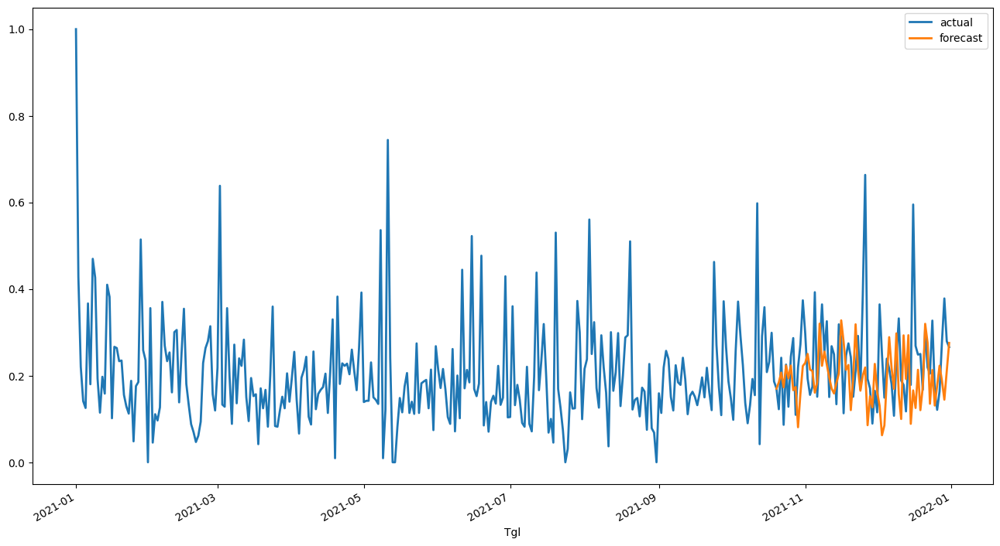

In [298]:
# prediction for Machine5
pred = rnn_Machine5.predict(n=73, series=train_Machine5)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine5_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine5_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine5_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine5_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine5_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine5_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine5_scaled, pred)))

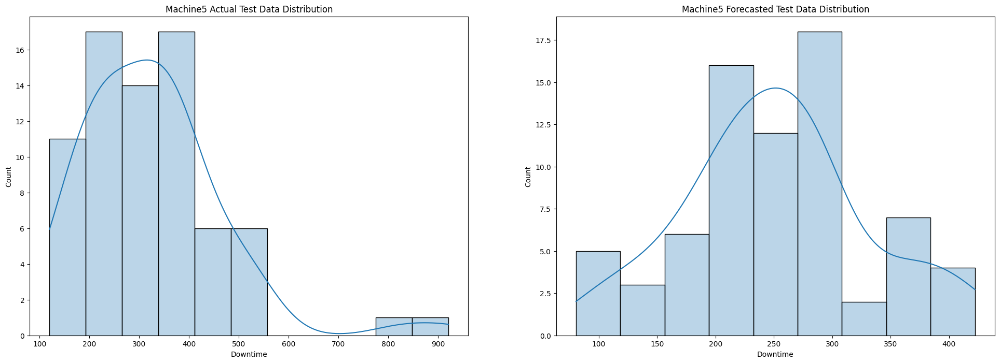

In [299]:
# normal distribution for Machine5

pred_Machine5 = pd.read_csv('/content/pred_down_Machine5_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine5.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine5 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine5['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine5 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.170
MAE = 0.140
MSE = 0.029
SMAPE = 61.73
OPE = 9.871%


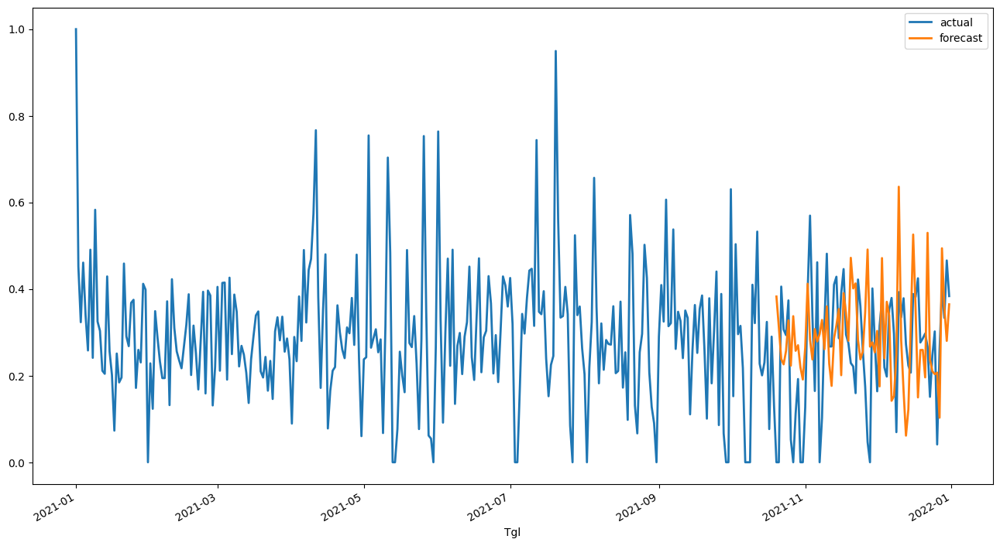

In [300]:
# prediction for Machine6
pred = rnn_Machine6.predict(n=73, series=train_Machine6)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine6_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine6_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine6_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine6_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine6_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine6_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine6_scaled, pred)))

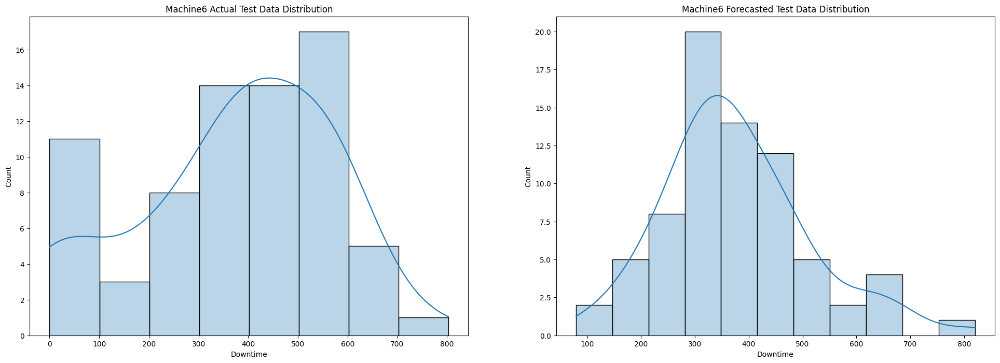

In [301]:
# normal distribution for Machine6

pred_Machine6 = pd.read_csv('/content/pred_down_Machine6_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine6.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine6 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine6['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine6 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.165
MAE = 0.125
MSE = 0.027
SMAPE = 51.65
OPE = 12.324%


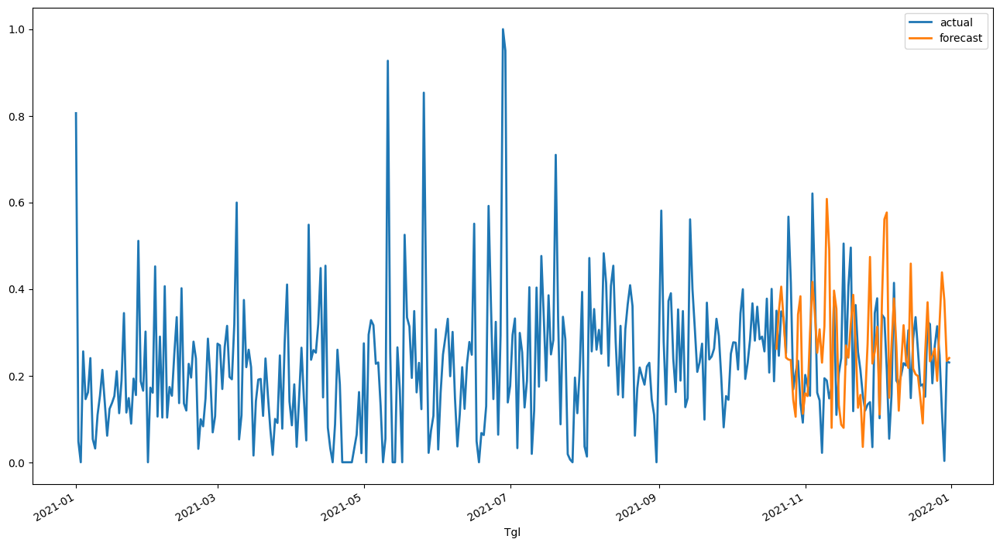

In [302]:
# prediction for Machine7
pred = rnn_Machine7.predict(n=73, series=train_Machine7)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_Machine7_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_Machine7_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_Machine7_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_Machine7_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_Machine7_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_Machine7_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_Machine7_scaled, pred)))

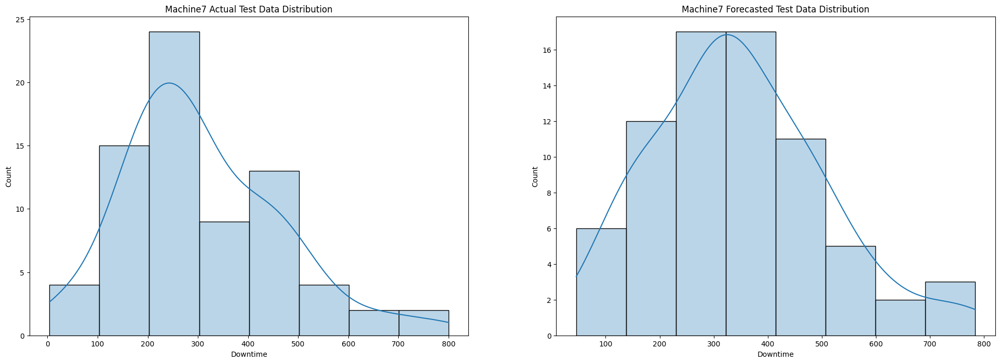

In [303]:
# normal distribution for Machine7

pred_Machine7 = pd.read_csv('/content/pred_down_Machine7_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(Machine7.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Machine7 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_Machine7['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Machine7 Forecasted Test Data Distribution')

plt.show()